In [1]:
run_gridsearch = True
skip_best_model_train = False
hyperparam_csv_file = "CV_warm_springs_hourly_hyperparams.csv"

In [2]:
import sys
import os
import itertools
import pandas as pd
current_dir = os.getcwd()
print(current_dir)

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all


In [3]:
library_path = os.path.join('..', '..', '..','..','UCB-USACE-LSTMs')
sys.path.insert(0, library_path)
print(sys.path)

['..\\..\\..\\..\\UCB-USACE-LSTMs', 'F:\\Dino\\Arman\\UCB-USACE-LSTMs\\UCB_training\\models\\warm_springs_all', 'C:\\Users\\Dino\\anaconda3\\python312.zip', 'C:\\Users\\Dino\\anaconda3\\DLLs', 'C:\\Users\\Dino\\anaconda3\\Lib', 'C:\\Users\\Dino\\anaconda3', '', 'C:\\Users\\Dino\\anaconda3\\Lib\\site-packages', 'C:\\Users\\Dino\\anaconda3\\Lib\\site-packages\\win32', 'C:\\Users\\Dino\\anaconda3\\Lib\\site-packages\\win32\\lib', 'C:\\Users\\Dino\\anaconda3\\Lib\\site-packages\\Pythonwin']


In [4]:
from pathlib import Path
from neuralhydrology.evaluation.metrics import *
from UCB_training.UCB_train import UCB_trainer
from UCB_training.UCB_utils import combinedPlot
from UCB_training.UCB_utils import fancyCombinedPlot
from UCB_training.UCB_utils import combinedPlotFromDf
from UCB_training.UCB_utils import fancyCombinedPlotFromDf

In [5]:
current_path = os.getcwd()
library_path = current_path.split('UCB-USACE-LSTMs')[0] + 'UCB-USACE-LSTMs'

target_path = os.path.join(library_path, 'UCB_training', 'models', 'warm_springs_all')

if os.path.exists(target_path):
    os.chdir(target_path)
    print("Current Working Directory:", os.getcwd())
    print("Train Basin File Exists:", os.path.exists("warm_springs")) 
else:
    print(f"Error: The target path '{target_path}' does not exist.")

Current Working Directory: F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all
Train Basin File Exists: False


In [6]:
path_to_csv = Path(library_path +'/russian_river_data')
path_to_yaml = Path("warm_springs_dam_nlayer.yaml")
path_to_physics_data = Path(library_path + "/russian_river_data/WarmSprings_Inflow_hourly.csv")

In [7]:
path_to_physics_data

WindowsPath('F:/Dino/Arman/UCB-USACE-LSTMs/russian_river_data/WarmSprings_Inflow_hourly.csv')

In [8]:
features_with_physics = [
    #from daily.csv
    "DRY CREEK 20 PRECIP-INC SCREENED",
    "DRY CREEK 20 ET-POTENTIAL RUN:BASIN AVERAGE 60 YR",
    "DRY CREEK 30 PRECIP-INC SCREENED",
    "DRY CREEK 30 ET-POTENTIAL RUN:BASIN AVERAGE 60 YR",
    "UKIAH CA HUMIDITY USAF-NOAA",
    "UKIAH CA SOLAR RADIATION USAF-NOAA",
    "UKIAH CA TEMPERATURE USAF-NOAA",
    "UKIAH CA WINDSPEED USAF-NOAA",
    "SANTA ROSA CA HUMIDITY USAF-NOAA",
    "SANTA ROSA CA SOLAR RADIATION USAF-NOAA",
    "SANTA ROSA CA TEMPERATURE USAF-NOAA",
    "SANTA ROSA CA WINDSPEED USAF-NOAA",
    #from Warm_Spring_Inflow.csv
    'Dry Creek 20 ET-POTENTIAL',
    'Dry Creek 20 FLOW',
    'Dry Creek 20 FLOW-BASE',
    'Dry Creek 20 INFILTRATION',
    'Dry Creek 20 PERC-SOIL',
    'Dry Creek 20 SATURATION FRACTION',
    'Dry Creek 30 ET-POTENTIAL',
    'Dry Creek 30 FLOW',
    'Dry Creek 30 FLOW-BASE',
    'Dry Creek 30 INFILTRATION',
    'Dry Creek 30 PERC-SOIL',
    'Dry Creek 30 SATURATION FRACTION',
    'Warm Springs Dam Inflow FLOW',
]

In [9]:
hyperparam_space = {
    "hidden_size": [64, 128, 256],
    "seq_length": [90, 168, 336],
    "num_layers": [1],
    "epochs": [16, 32]
}
fixed_dropout = 0.4
no_physics_results = []
physics_results = []

In [10]:
if run_gridsearch or not os.path.exists(hyperparam_csv_file):
    for (hs, seq, nl, ep) in itertools.product(
            hyperparam_space["hidden_size"],
            hyperparam_space["seq_length"],
            hyperparam_space["num_layers"],
            hyperparam_space["epochs"]
    ):
        hp = {
            "hidden_size": hs,
            "seq_length": seq,
            "num_layers": nl,
            "epochs": ep,
            "output_dropout": fixed_dropout,
        }
        print(f"NoPhysics: {hp}")
        trainer = UCB_trainer(
            path_to_csv_folder=path_to_csv,
            yaml_path=path_to_yaml,
            hyperparams=hp,
            input_features=None,
            physics_informed=False,
            physics_data_file=None,
            hourly=True,
            extend_train_period=False,
            gpu=0
        )
        metrics_dict = trainer.cross_validate()
        row_data = {"hidden_size": hs, "seq_length": seq, "num_layers": nl, "epochs": ep, "output_dropout": fixed_dropout}
        for k, v in metrics_dict.items():
            row_data[k] = v
        no_physics_results.append(row_data)
    df_no_physics = pd.DataFrame(no_physics_results)
    df_no_physics.sort_values(by="avg NSE", ascending=False, inplace=True)
    df_no_physics.reset_index(drop=True, inplace=True)
else:
    print("Skipping Grid-Search")

NoPhysics: {'hidden_size': 64, 'seq_length': 90, 'num_layers': 1, 'epochs': 16, 'output_dropout': 0.4}
2025-03-13 16:59:10,125: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_165910\output.log initialized.
2025-03-13 16:59:10,126: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_165910
2025-03-13 16:59:10,127: ### Run configurations for testing_run
2025-03-13 16:59:10,128: experiment_name: testing_run
2025-03-13 16:59:10,129: train_basin_file: warm springs
2025-03-13 16:59:10,130: validation_basin_file: warm springs
2025-03-13 16:59:10,132: test_basin_file: warm springs
2025-03-13 16:59:10,134: train_start_date: 1994-10-01 00:00:00
2025-03-13 16:59:10,135: train_end_date: 1996-10-01 00:00:00
2025-03-13 16:59:10,138: validation_start_date: 1996-10-02 00:00:00
2025-03-13 16:59:10,139: validation_end_date: 1997-10-01 00:00:00
2025-03-13 16:59:10,140: test_start_date

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:03<00:00,  3.05s/it]
2025-03-13 16:59:58,977: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_165910\validation\model_epoch016\validation_metrics.csv
2025-03-13 16:59:58,977: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_165910\validation\model_epoch016\validation_results.p
2025-03-13 16:59:59,132: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_165910\testing_run_1303_165959\output.log initialized.
2025-03-13 16:59:59,132: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_165910\testing_run_1303_165959
2025-03-13 16:59:59,132: ### Run configurations for testing_run
2025-03-13 16:59:59,140: experiment_name: testing_run
2025-03-13 16:59:59,143: train_basin_file: warm springs
2025-03-13 16:59:59,146: validation

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:02<00:00,  2.68s/it]
2025-03-13 17:00:01,945: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<?, ?it/s]
2025-03-13 17:00:01,963: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 129/129 [00:04<00:00, 29.78it/s, Loss: 0.0000]
2025-03-13 17:00:07,232: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 129/129 [00:03<00:00, 32.84it/s, Loss: 0.0000]
2025-03-13 17:00:11,168: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 129/129 [00:04<00:00, 32.04it/s, Loss: 0.0000]
2025-03-13 17:00:15,198: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 129/129 [00:04<00:00, 29.69it/s, Loss: 0.0000]
2025-03-13 17:00:19,545: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 129/129 [00:04<00:00, 27.90it/s, Loss: 0.0000]
2025-03-13 17:00:24,168: Epoch 5 avera

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:02<00:00,  2.97s/it]
2025-03-13 17:01:19,533: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_165910\testing_run_1303_165959\validation\model_epoch016\validation_metrics.csv
2025-03-13 17:01:19,533: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_165910\testing_run_1303_165959\validation\model_epoch016\validation_results.p
2025-03-13 17:01:19,663: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_165910\testing_run_1303_165959\testing_run_1303_170119\output.log initialized.
2025-03-13 17:01:19,663: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_165910\testing_run_1303_165959\testing_run_1303_170119
2025-03-13 17:01:19,677: ### Run configurations for testing_run
2025-03-13 17:01:19,679: experiment_name: testing

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:02<00:00,  2.70s/it]
2025-03-13 17:01:22,478: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 251.25it/s]
2025-03-13 17:01:22,509: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 197/197 [00:06<00:00, 29.90it/s, Loss: 0.0000]
2025-03-13 17:01:30,615: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 197/197 [00:06<00:00, 29.28it/s, Loss: 0.0000]
2025-03-13 17:01:37,351: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 197/197 [00:06<00:00, 29.91it/s, Loss: 0.0000]
2025-03-13 17:01:43,945: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 197/197 [00:06<00:00, 31.84it/s, Loss: 0.0000]
2025-03-13 17:01:50,138: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 197/197 [00:06<00:00, 31.24it/s, Loss: 0.0000]
2025-03-13 17:01:56,451: Epoc

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:03<00:00,  3.08s/it]
2025-03-13 17:03:16,328: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_165910\testing_run_1303_165959\testing_run_1303_170119\validation\model_epoch016\validation_metrics.csv
2025-03-13 17:03:16,331: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_165910\testing_run_1303_165959\testing_run_1303_170119\validation\model_epoch016\validation_results.p
2025-03-13 17:03:16,452: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_165910\testing_run_1303_165959\testing_run_1303_170119\testing_run_1303_170316\output.log initialized.
2025-03-13 17:03:16,452: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_165910\testing_run_1303_165959\testing_run_1303_170119\testing_run_1303_170316
2025-03-13 17:03:

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:02<00:00,  2.67s/it]
2025-03-13 17:03:19,250: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 146.47it/s]
2025-03-13 17:03:19,294: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 266/266 [00:09<00:00, 28.40it/s, Loss: 0.0000]
2025-03-13 17:03:30,074: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 266/266 [00:09<00:00, 29.28it/s, Loss: 0.0000]
2025-03-13 17:03:39,166: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 266/266 [00:08<00:00, 30.38it/s, Loss: 0.0000]
2025-03-13 17:03:47,929: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 266/266 [00:08<00:00, 31.46it/s, Loss: 0.0000]
2025-03-13 17:03:56,394: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 266/266 [00:08<00:00, 33.12it/s, Loss: 0.0000]
2025-03-13 17:04:04,435: Epoc

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:02<00:00,  2.98s/it]
2025-03-13 17:05:47,591: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_165910\testing_run_1303_165959\testing_run_1303_170119\testing_run_1303_170316\validation\model_epoch016\validation_metrics.csv
2025-03-13 17:05:47,598: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_165910\testing_run_1303_165959\testing_run_1303_170119\testing_run_1303_170316\validation\model_epoch016\validation_results.p
Fold 1 results
{'NSE': 0.7798728346824646, 'MSE': 405725.5625, 'RMSE': 636.9659037185586, 'KGE': 0.741441914039307, 'Alpha-NSE': 0.7673757017204548, 'Beta-KGE': 1.0324246883392334, 'Beta-NSE': 0.009845710965532458, 'Pearson-r': 0.8918942219318975, 'FHV': -28.3290296792984, 'FMS': -16.19948361167736, 'FLV': -9993.317474118336, 'Peak-Timing': nan, 'Peak-MAPE': 50.87074756622314}


Fold 2 results
{'NSE': 0.572198778390884

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:02<00:00,  2.42s/it]
2025-03-13 17:05:50,238: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 168.64it/s]
2025-03-13 17:05:50,265: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 60/60 [00:02<00:00, 28.61it/s, Loss: 0.0000]
2025-03-13 17:05:52,923: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 60/60 [00:02<00:00, 28.78it/s, Loss: 0.0000]
2025-03-13 17:05:55,018: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 60/60 [00:02<00:00, 27.10it/s, Loss: 0.0000]
2025-03-13 17:05:57,242: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 60/60 [00:01<00:00, 30.58it/s, Loss: 0.0000]
2025-03-13 17:05:59,216: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 60/60 [00:01<00:00, 30.77it/s, Loss: 0.0000]
2025-03-13 17:06:01,180: Epoch 5 averag

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:03<00:00,  3.07s/it]
2025-03-13 17:07:05,699: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_170547\validation\model_epoch032\validation_metrics.csv
2025-03-13 17:07:05,703: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_170547\validation\model_epoch032\validation_results.p
2025-03-13 17:07:05,822: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_170547\testing_run_1303_170705\output.log initialized.
2025-03-13 17:07:05,822: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_170547\testing_run_1303_170705
2025-03-13 17:07:05,822: ### Run configurations for testing_run
2025-03-13 17:07:05,822: experiment_name: testing_run
2025-03-13 17:07:05,822: train_basin_file: warm springs
2025-03-13 17:07:05,822: validation

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:02<00:00,  2.55s/it]
2025-03-13 17:07:08,485: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 251.14it/s]
2025-03-13 17:07:08,520: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 129/129 [00:04<00:00, 31.00it/s, Loss: 0.0000]
2025-03-13 17:07:13,718: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 129/129 [00:04<00:00, 31.78it/s, Loss: 0.0000]
2025-03-13 17:07:17,788: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 129/129 [00:03<00:00, 33.14it/s, Loss: 0.0000]
2025-03-13 17:07:21,690: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 129/129 [00:04<00:00, 31.90it/s, Loss: 0.0000]
2025-03-13 17:07:25,744: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 129/129 [00:04<00:00, 31.14it/s, Loss: 0.0000]
2025-03-13 17:07:29,895: Epoc

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:02<00:00,  2.93s/it]
2025-03-13 17:09:32,159: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_170547\testing_run_1303_170705\validation\model_epoch032\validation_metrics.csv
2025-03-13 17:09:32,164: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_170547\testing_run_1303_170705\validation\model_epoch032\validation_results.p
2025-03-13 17:09:32,273: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_170547\testing_run_1303_170705\testing_run_1303_170932\output.log initialized.


F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


2025-03-13 17:09:32,464: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_170547\testing_run_1303_170705\testing_run_1303_170932
2025-03-13 17:09:32,464: ### Run configurations for testing_run
2025-03-13 17:09:32,464: experiment_name: testing_run
2025-03-13 17:09:32,476: train_basin_file: warm springs
2025-03-13 17:09:32,478: validation_basin_file: warm springs
2025-03-13 17:09:32,482: test_basin_file: warm springs
2025-03-13 17:09:32,485: train_start_date: 1994-10-01 00:00:00
2025-03-13 17:09:32,488: train_end_date: 2000-10-01 00:00:00
2025-03-13 17:09:32,490: validation_start_date: 2000-10-02 00:00:00
2025-03-13 17:09:32,492: validation_end_date: 2001-10-01 00:00:00
2025-03-13 17:09:32,492: test_start_date: 2005-10-01 00:00:00
2025-03-13 17:09:32,492: test_end_date: 2009-09-29 00:00:00
2025-03-13 17:09:32,492: device: cuda:0
2025-03-13 17:09:32,492: physics_informed: False
2025-03-13 17:09:32,507: physics_data_fi

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:03<00:00,  3.30s/it]
2025-03-13 17:13:03,024: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_170547\testing_run_1303_170705\testing_run_1303_170932\validation\model_epoch032\validation_metrics.csv
2025-03-13 17:13:03,032: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_170547\testing_run_1303_170705\testing_run_1303_170932\validation\model_epoch032\validation_results.p
2025-03-13 17:13:03,147: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_170547\testing_run_1303_170705\testing_run_1303_170932\testing_run_1303_171303\output.log initialized.
2025-03-13 17:13:03,147: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_170547\testing_run_1303_170705\testing_run_1303_170932\testing_run_1303_171303
2025-03-13 17:13:

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:02<00:00,  2.52s/it]
2025-03-13 17:13:05,791: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 173.20it/s]
2025-03-13 17:13:05,824: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 266/266 [00:09<00:00, 29.28it/s, Loss: 0.0000]
2025-03-13 17:13:16,635: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 266/266 [00:09<00:00, 28.67it/s, Loss: 0.0000]
2025-03-13 17:13:25,919: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 266/266 [00:08<00:00, 30.33it/s, Loss: 0.0000]
2025-03-13 17:13:34,698: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 266/266 [00:08<00:00, 30.02it/s, Loss: 0.0000]
2025-03-13 17:13:43,564: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 266/266 [00:08<00:00, 32.41it/s, Loss: 0.0000]
2025-03-13 17:13:51,777: Epoc

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:03<00:00,  3.09s/it]
2025-03-13 17:17:49,991: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_170547\testing_run_1303_170705\testing_run_1303_170932\testing_run_1303_171303\validation\model_epoch032\validation_metrics.csv
2025-03-13 17:17:49,999: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_170547\testing_run_1303_170705\testing_run_1303_170932\testing_run_1303_171303\validation\model_epoch032\validation_results.p
Fold 1 results
{'NSE': 0.8513112813234329, 'MSE': 274054.40625, 'RMSE': 523.5020594515364, 'KGE': 0.8160799457690555, 'Alpha-NSE': 0.9538042838103963, 'Beta-KGE': 1.1611881256103516, 'Beta-NSE': 0.048944557767528644, 'Pearson-r': 0.9244293025289256, 'FHV': -6.277088820934296, 'FMS': -15.978764548500173, 'FLV': -10111.798393173744, 'Peak-Timing': nan, 'Peak-MAPE': 34.516849517822266}


Fold 2 results
{'NSE': 0.525892734

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:02<00:00,  2.55s/it]
2025-03-13 17:17:52,821: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 200.92it/s]
2025-03-13 17:17:52,839: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 60/60 [00:02<00:00, 23.96it/s, Loss: 0.0000]
2025-03-13 17:17:56,406: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 60/60 [00:02<00:00, 23.84it/s, Loss: 0.0000]
2025-03-13 17:17:58,936: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 60/60 [00:02<00:00, 25.61it/s, Loss: 0.0000]
2025-03-13 17:18:01,296: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 60/60 [00:02<00:00, 25.97it/s, Loss: 0.0000]
2025-03-13 17:18:03,621: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 60/60 [00:02<00:00, 23.73it/s, Loss: 0.0000]
2025-03-13 17:18:06,165: Epoch 5 averag

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:03<00:00,  3.27s/it]
2025-03-13 17:18:41,474: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_171750\validation\model_epoch016\validation_metrics.csv
2025-03-13 17:18:41,478: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_171750\validation\model_epoch016\validation_results.p
2025-03-13 17:18:41,570: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_171750\testing_run_1303_171841\output.log initialized.
2025-03-13 17:18:41,570: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_171750\testing_run_1303_171841
2025-03-13 17:18:41,570: ### Run configurations for testing_run
2025-03-13 17:18:41,570: experiment_name: testing_run
2025-03-13 17:18:41,570: train_basin_file: warm springs
2025-03-13 17:18:41,586: validation

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:02<00:00,  2.59s/it]
2025-03-13 17:18:44,265: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 99.26it/s]
2025-03-13 17:18:44,304: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 129/129 [00:05<00:00, 25.01it/s, Loss: 0.0000]
2025-03-13 17:18:50,544: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 129/129 [00:05<00:00, 24.25it/s, Loss: 0.0000]
2025-03-13 17:18:55,871: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 129/129 [00:05<00:00, 24.31it/s, Loss: 0.0000]
2025-03-13 17:19:01,186: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 129/129 [00:05<00:00, 24.97it/s, Loss: 0.0000]
2025-03-13 17:19:06,361: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 129/129 [00:05<00:00, 25.37it/s, Loss: 0.0000]
2025-03-13 17:19:11,453: Epoch

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:03<00:00,  3.34s/it]
2025-03-13 17:20:17,773: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_171750\testing_run_1303_171841\validation\model_epoch016\validation_metrics.csv
2025-03-13 17:20:17,773: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_171750\testing_run_1303_171841\validation\model_epoch016\validation_results.p
2025-03-13 17:20:17,882: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_171750\testing_run_1303_171841\testing_run_1303_172017\output.log initialized.
2025-03-13 17:20:17,882: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_171750\testing_run_1303_171841\testing_run_1303_172017
2025-03-13 17:20:17,882: ### Run configurations for testing_run
2025-03-13 17:20:17,898: experiment_name: testing

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:02<00:00,  2.58s/it]
2025-03-13 17:20:20,628: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 212.68it/s]
2025-03-13 17:20:20,659: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 197/197 [00:07<00:00, 25.08it/s, Loss: 0.0000]
2025-03-13 17:20:29,677: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 197/197 [00:08<00:00, 24.62it/s, Loss: 0.0000]
2025-03-13 17:20:37,686: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 197/197 [00:07<00:00, 24.87it/s, Loss: 0.0000]
2025-03-13 17:20:45,616: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 197/197 [00:08<00:00, 24.08it/s, Loss: 0.0000]
2025-03-13 17:20:53,804: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 197/197 [00:08<00:00, 24.21it/s, Loss: 0.0000]
2025-03-13 17:21:01,951: Epoc

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:03<00:00,  3.63s/it]
2025-03-13 17:22:38,114: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_171750\testing_run_1303_171841\testing_run_1303_172017\validation\model_epoch016\validation_metrics.csv
2025-03-13 17:22:38,120: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_171750\testing_run_1303_171841\testing_run_1303_172017\validation\model_epoch016\validation_results.p
2025-03-13 17:22:38,206: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_171750\testing_run_1303_171841\testing_run_1303_172017\testing_run_1303_172238\output.log initialized.
2025-03-13 17:22:38,206: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_171750\testing_run_1303_171841\testing_run_1303_172017\testing_run_1303_172238
2025-03-13 17:22:

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:02<00:00,  2.71s/it]
2025-03-13 17:22:41,051: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 125.48it/s]
2025-03-13 17:22:41,092: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 266/266 [00:10<00:00, 24.94it/s, Loss: 0.0000]
2025-03-13 17:22:53,145: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 266/266 [00:11<00:00, 23.75it/s, Loss: 0.0000]
2025-03-13 17:23:04,354: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 266/266 [00:10<00:00, 25.69it/s, Loss: 0.0000]
2025-03-13 17:23:14,716: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 266/266 [00:10<00:00, 24.44it/s, Loss: 0.0000]
2025-03-13 17:23:25,610: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 266/266 [00:10<00:00, 24.68it/s, Loss: 0.0000]
2025-03-13 17:23:36,396: Epoc

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:03<00:00,  3.42s/it]
2025-03-13 17:25:42,054: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_171750\testing_run_1303_171841\testing_run_1303_172017\testing_run_1303_172238\validation\model_epoch016\validation_metrics.csv
2025-03-13 17:25:42,065: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_171750\testing_run_1303_171841\testing_run_1303_172017\testing_run_1303_172238\validation\model_epoch016\validation_results.p
Fold 1 results
{'NSE': 0.7798030823469162, 'MSE': 405854.125, 'RMSE': 637.0668136074897, 'KGE': 0.7482464575072967, 'Alpha-NSE': 1.027272349629019, 'Beta-KGE': 1.2274142503738403, 'Beta-NSE': 0.06905401779636984, 'Pearson-r': 0.895506824001554, 'FHV': 2.163495309650898, 'FMS': 3.7279941940064316, 'FLV': -9937.148095122251, 'Peak-Timing': nan, 'Peak-MAPE': 40.56435585021973}


Fold 2 results
{'NSE': 0.5636077523231506, 

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:02<00:00,  2.53s/it]
2025-03-13 17:25:44,870: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 200.98it/s]
2025-03-13 17:25:44,891: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 60/60 [00:02<00:00, 25.66it/s, Loss: 0.0000]
2025-03-13 17:25:47,790: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 60/60 [00:02<00:00, 24.97it/s, Loss: 0.0000]
2025-03-13 17:25:50,206: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 60/60 [00:02<00:00, 24.72it/s, Loss: 0.0000]
2025-03-13 17:25:52,648: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 60/60 [00:02<00:00, 24.09it/s, Loss: 0.0000]
2025-03-13 17:25:55,153: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 60/60 [00:02<00:00, 24.97it/s, Loss: 0.0000]
2025-03-13 17:25:57,566: Epoch 5 averag

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:03<00:00,  3.44s/it]
2025-03-13 17:27:15,092: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_172542\validation\model_epoch032\validation_metrics.csv
2025-03-13 17:27:15,096: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_172542\validation\model_epoch032\validation_results.p
2025-03-13 17:27:15,197: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_172542\testing_run_1303_172715\output.log initialized.
2025-03-13 17:27:15,197: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_172542\testing_run_1303_172715
2025-03-13 17:27:15,205: ### Run configurations for testing_run
2025-03-13 17:27:15,205: experiment_name: testing_run
2025-03-13 17:27:15,205: train_basin_file: warm springs
2025-03-13 17:27:15,205: validation

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:02<00:00,  2.63s/it]
2025-03-13 17:27:17,957: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 226.46it/s]
2025-03-13 17:27:17,977: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 129/129 [00:05<00:00, 23.87it/s, Loss: 0.0000]
2025-03-13 17:27:24,196: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 129/129 [00:05<00:00, 24.32it/s, Loss: 0.0000]
2025-03-13 17:27:29,506: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 129/129 [00:05<00:00, 23.62it/s, Loss: 0.0000]
2025-03-13 17:27:34,975: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 129/129 [00:05<00:00, 25.71it/s, Loss: 0.0000]
2025-03-13 17:27:40,001: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 129/129 [00:05<00:00, 24.78it/s, Loss: 0.0000]
2025-03-13 17:27:45,213: Epoc

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:02<00:00,  2.94s/it]
2025-03-13 17:30:18,751: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_172542\testing_run_1303_172715\validation\model_epoch032\validation_metrics.csv
2025-03-13 17:30:18,755: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_172542\testing_run_1303_172715\validation\model_epoch032\validation_results.p
2025-03-13 17:30:18,866: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_172542\testing_run_1303_172715\testing_run_1303_173018\output.log initialized.
2025-03-13 17:30:18,866: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_172542\testing_run_1303_172715\testing_run_1303_173018
2025-03-13 17:30:18,866: ### Run configurations for testing_run
2025-03-13 17:30:18,866: experiment_name: testing

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:02<00:00,  2.63s/it]
2025-03-13 17:30:21,636: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 251.07it/s]
2025-03-13 17:30:21,673: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 197/197 [00:08<00:00, 24.40it/s, Loss: 0.0000]
2025-03-13 17:30:31,413: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 197/197 [00:07<00:00, 25.48it/s, Loss: 0.0000]
2025-03-13 17:30:39,150: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 197/197 [00:08<00:00, 24.47it/s, Loss: 0.0000]
2025-03-13 17:30:47,208: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 197/197 [00:07<00:00, 25.35it/s, Loss: 0.0000]
2025-03-13 17:30:54,985: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 197/197 [00:08<00:00, 24.13it/s, Loss: 0.0000]
2025-03-13 17:31:03,157: Epoc

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:03<00:00,  3.33s/it]
2025-03-13 17:34:50,890: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_172542\testing_run_1303_172715\testing_run_1303_173018\validation\model_epoch032\validation_metrics.csv
2025-03-13 17:34:50,900: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_172542\testing_run_1303_172715\testing_run_1303_173018\validation\model_epoch032\validation_results.p
2025-03-13 17:34:50,997: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_172542\testing_run_1303_172715\testing_run_1303_173018\testing_run_1303_173450\output.log initialized.
2025-03-13 17:34:51,000: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_172542\testing_run_1303_172715\testing_run_1303_173018\testing_run_1303_173450
2025-03-13 17:34:

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:02<00:00,  2.85s/it]
2025-03-13 17:34:53,956: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 139.32it/s]
2025-03-13 17:34:54,010: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 266/266 [00:10<00:00, 24.92it/s, Loss: 0.0000]
2025-03-13 17:35:06,411: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 266/266 [00:10<00:00, 25.17it/s, Loss: 0.0000]
2025-03-13 17:35:16,990: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 266/266 [00:10<00:00, 25.48it/s, Loss: 0.0000]
2025-03-13 17:35:27,439: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 266/266 [00:10<00:00, 25.06it/s, Loss: 0.0000]
2025-03-13 17:35:38,064: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 266/266 [00:10<00:00, 25.51it/s, Loss: 0.0000]
2025-03-13 17:35:48,500: Epoc

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:03<00:00,  3.22s/it]
2025-03-13 17:40:49,278: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_172542\testing_run_1303_172715\testing_run_1303_173018\testing_run_1303_173450\validation\model_epoch032\validation_metrics.csv
2025-03-13 17:40:49,286: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_172542\testing_run_1303_172715\testing_run_1303_173018\testing_run_1303_173450\validation\model_epoch032\validation_results.p
Fold 1 results
{'NSE': 0.7928209006786346, 'MSE': 381860.4375, 'RMSE': 617.9485718892795, 'KGE': 0.8325064486776932, 'Alpha-NSE': 0.9754926317216759, 'Beta-KGE': 1.1280840635299683, 'Beta-NSE': 0.03889253644756318, 'Pearson-r': 0.8948907648953724, 'FHV': -0.6882696412503719, 'FMS': 1.8600639480786745, 'FLV': -9964.62384216983, 'Peak-Timing': nan, 'Peak-MAPE': 41.28908634185791}


Fold 2 results
{'NSE': 0.68239158391952

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:02<00:00,  2.61s/it]
2025-03-13 17:40:52,168: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 150.54it/s]
2025-03-13 17:40:52,205: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 60/60 [00:03<00:00, 16.44it/s, Loss: 0.0000]
2025-03-13 17:40:56,630: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 60/60 [00:03<00:00, 17.13it/s, Loss: 0.0000]
2025-03-13 17:41:00,145: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 60/60 [00:04<00:00, 14.39it/s, Loss: 0.0000]
2025-03-13 17:41:04,320: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 60/60 [00:03<00:00, 16.35it/s, Loss: 0.0000]
2025-03-13 17:41:08,012: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 60/60 [00:03<00:00, 16.94it/s, Loss: 0.0000]
2025-03-13 17:41:11,567: Epoch 5 averag

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:03<00:00,  3.55s/it]
2025-03-13 17:42:02,244: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_174049\validation\model_epoch016\validation_metrics.csv
2025-03-13 17:42:02,249: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_174049\validation\model_epoch016\validation_results.p
2025-03-13 17:42:02,351: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_174049\testing_run_1303_174202\output.log initialized.
2025-03-13 17:42:02,351: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_174049\testing_run_1303_174202
2025-03-13 17:42:02,351: ### Run configurations for testing_run
2025-03-13 17:42:02,351: experiment_name: testing_run
2025-03-13 17:42:02,366: train_basin_file: warm springs
2025-03-13 17:42:02,366: validation

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:02<00:00,  2.48s/it]
2025-03-13 17:42:04,942: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 251.23it/s]
2025-03-13 17:42:04,967: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 129/129 [00:07<00:00, 16.73it/s, Loss: 0.0000]
2025-03-13 17:42:13,783: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 129/129 [00:07<00:00, 17.44it/s, Loss: 0.0000]
2025-03-13 17:42:21,191: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 129/129 [00:07<00:00, 16.50it/s, Loss: 0.0000]
2025-03-13 17:42:29,014: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 129/129 [00:08<00:00, 15.90it/s, Loss: 0.0000]
2025-03-13 17:42:37,136: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 129/129 [00:07<00:00, 16.77it/s, Loss: 0.0000]
2025-03-13 17:42:44,835: Epoc

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:03<00:00,  3.40s/it]
2025-03-13 17:44:19,679: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_174049\testing_run_1303_174202\validation\model_epoch016\validation_metrics.csv
2025-03-13 17:44:19,679: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_174049\testing_run_1303_174202\validation\model_epoch016\validation_results.p
2025-03-13 17:44:19,804: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_174049\testing_run_1303_174202\testing_run_1303_174419\output.log initialized.
2025-03-13 17:44:19,804: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_174049\testing_run_1303_174202\testing_run_1303_174419
2025-03-13 17:44:19,804: ### Run configurations for testing_run
2025-03-13 17:44:19,804: experiment_name: testing

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:02<00:00,  2.65s/it]
2025-03-13 17:44:22,572: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 250.83it/s]
2025-03-13 17:44:22,598: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 197/197 [00:11<00:00, 16.63it/s, Loss: 0.0000]
2025-03-13 17:44:36,309: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 197/197 [00:12<00:00, 16.36it/s, Loss: 0.0000]
2025-03-13 17:44:48,352: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 197/197 [00:11<00:00, 16.61it/s, Loss: 0.0000]
2025-03-13 17:45:00,235: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 197/197 [00:12<00:00, 16.26it/s, Loss: 0.0000]
2025-03-13 17:45:12,359: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 197/197 [00:11<00:00, 16.45it/s, Loss: 0.0000]
2025-03-13 17:45:24,345: Epoc

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:03<00:00,  3.62s/it]
2025-03-13 17:47:45,490: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_174049\testing_run_1303_174202\testing_run_1303_174419\validation\model_epoch016\validation_metrics.csv
2025-03-13 17:47:45,499: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_174049\testing_run_1303_174202\testing_run_1303_174419\validation\model_epoch016\validation_results.p
2025-03-13 17:47:45,601: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_174049\testing_run_1303_174202\testing_run_1303_174419\testing_run_1303_174745\output.log initialized.
2025-03-13 17:47:45,601: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_174049\testing_run_1303_174202\testing_run_1303_174419\testing_run_1303_174745
2025-03-13 17:47:

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:02<00:00,  2.60s/it]
2025-03-13 17:47:48,360: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 218.93it/s]
2025-03-13 17:47:48,394: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 266/266 [00:15<00:00, 16.70it/s, Loss: 0.0000]
2025-03-13 17:48:06,704: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 266/266 [00:15<00:00, 16.76it/s, Loss: 0.0000]
2025-03-13 17:48:22,586: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 266/266 [00:16<00:00, 16.41it/s, Loss: 0.0000]
2025-03-13 17:48:38,801: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 266/266 [00:16<00:00, 16.53it/s, Loss: 0.0000]
2025-03-13 17:48:54,902: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 266/266 [00:15<00:00, 16.89it/s, Loss: 0.0000]
2025-03-13 17:49:10,659: Epoc

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:03<00:00,  3.40s/it]
2025-03-13 17:52:17,541: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_174049\testing_run_1303_174202\testing_run_1303_174419\testing_run_1303_174745\validation\model_epoch016\validation_metrics.csv
2025-03-13 17:52:17,548: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_174049\testing_run_1303_174202\testing_run_1303_174419\testing_run_1303_174745\validation\model_epoch016\validation_results.p
Fold 1 results
{'NSE': 0.8436163365840912, 'MSE': 288237.28125, 'RMSE': 536.8773428354003, 'KGE': 0.7713279988404765, 'Alpha-NSE': 0.8999590346491699, 'Beta-KGE': 1.1896456480026245, 'Beta-NSE': 0.05758565274006586, 'Pearson-r': 0.920519074240169, 'FHV': -8.86671170592308, 'FMS': -13.07223059191019, 'FLV': -10164.386630235183, 'Peak-Timing': nan, 'Peak-MAPE': 42.41879940032959}


Fold 2 results
{'NSE': 0.70783874392509

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:02<00:00,  2.50s/it]
2025-03-13 17:52:20,301: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 251.11it/s]
2025-03-13 17:52:20,317: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 60/60 [00:03<00:00, 15.94it/s, Loss: 0.0000]
2025-03-13 17:52:24,744: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 60/60 [00:03<00:00, 17.46it/s, Loss: 0.0000]
2025-03-13 17:52:28,190: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 60/60 [00:03<00:00, 16.57it/s, Loss: 0.0000]
2025-03-13 17:52:31,823: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 60/60 [00:03<00:00, 16.74it/s, Loss: 0.0000]
2025-03-13 17:52:35,413: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 60/60 [00:03<00:00, 17.27it/s, Loss: 0.0000]
2025-03-13 17:52:38,908: Epoch 5 averag

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:03<00:00,  3.51s/it]
2025-03-13 17:54:31,021: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_175217\validation\model_epoch032\validation_metrics.csv
2025-03-13 17:54:31,034: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_175217\validation\model_epoch032\validation_results.p
2025-03-13 17:54:31,178: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_175217\testing_run_1303_175431\output.log initialized.
2025-03-13 17:54:31,178: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_175217\testing_run_1303_175431
2025-03-13 17:54:31,178: ### Run configurations for testing_run
2025-03-13 17:54:31,191: experiment_name: testing_run
2025-03-13 17:54:31,192: train_basin_file: warm springs
2025-03-13 17:54:31,197: validation

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:02<00:00,  2.63s/it]
2025-03-13 17:54:33,912: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 251.20it/s]
2025-03-13 17:54:33,935: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 129/129 [00:07<00:00, 16.95it/s, Loss: 0.0000]
2025-03-13 17:54:42,501: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 129/129 [00:07<00:00, 16.88it/s, Loss: 0.0000]
2025-03-13 17:54:50,152: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 129/129 [00:07<00:00, 16.41it/s, Loss: 0.0000]
2025-03-13 17:54:58,019: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 129/129 [00:07<00:00, 16.98it/s, Loss: 0.0000]
2025-03-13 17:55:05,625: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 129/129 [00:07<00:00, 17.16it/s, Loss: 0.0000]
2025-03-13 17:55:13,150: Epoc

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:03<00:00,  3.93s/it]
2025-03-13 17:58:55,818: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_175217\testing_run_1303_175431\validation\model_epoch032\validation_metrics.csv
2025-03-13 17:58:55,822: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_175217\testing_run_1303_175431\validation\model_epoch032\validation_results.p
2025-03-13 17:58:55,936: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_175217\testing_run_1303_175431\testing_run_1303_175855\output.log initialized.
2025-03-13 17:58:55,937: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_175217\testing_run_1303_175431\testing_run_1303_175855
2025-03-13 17:58:55,939: ### Run configurations for testing_run
2025-03-13 17:58:55,941: experiment_name: testing

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:02<00:00,  2.52s/it]
2025-03-13 17:58:58,582: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 251.07it/s]
2025-03-13 17:58:58,607: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 197/197 [00:11<00:00, 16.80it/s, Loss: 0.0000]
2025-03-13 17:59:11,625: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 197/197 [00:11<00:00, 16.77it/s, Loss: 0.0000]
2025-03-13 17:59:23,378: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 197/197 [00:11<00:00, 16.86it/s, Loss: 0.0000]
2025-03-13 17:59:35,072: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 197/197 [00:11<00:00, 16.79it/s, Loss: 0.0000]
2025-03-13 17:59:46,811: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 197/197 [00:11<00:00, 16.90it/s, Loss: 0.0000]
2025-03-13 17:59:58,474: Epoc

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:03<00:00,  3.39s/it]
2025-03-13 18:05:32,234: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_175217\testing_run_1303_175431\testing_run_1303_175855\validation\model_epoch032\validation_metrics.csv
2025-03-13 18:05:32,238: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_175217\testing_run_1303_175431\testing_run_1303_175855\validation\model_epoch032\validation_results.p
2025-03-13 18:05:32,355: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_175217\testing_run_1303_175431\testing_run_1303_175855\testing_run_1303_180532\output.log initialized.
2025-03-13 18:05:32,357: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_175217\testing_run_1303_175431\testing_run_1303_175855\testing_run_1303_180532
2025-03-13 18:05:

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:02<00:00,  2.81s/it]
2025-03-13 18:05:35,305: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 200.80it/s]
2025-03-13 18:05:35,343: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 266/266 [00:15<00:00, 16.87it/s, Loss: 0.0000]
2025-03-13 18:05:53,418: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 266/266 [00:15<00:00, 16.78it/s, Loss: 0.0000]
2025-03-13 18:06:09,280: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 266/266 [00:15<00:00, 16.89it/s, Loss: 0.0000]
2025-03-13 18:06:25,033: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 266/266 [00:15<00:00, 16.84it/s, Loss: 0.0000]
2025-03-13 18:06:40,833: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 266/266 [00:15<00:00, 16.94it/s, Loss: 0.0000]
2025-03-13 18:06:56,542: Epoc

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:03<00:00,  3.30s/it]
2025-03-13 18:14:18,664: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_175217\testing_run_1303_175431\testing_run_1303_175855\testing_run_1303_180532\validation\model_epoch032\validation_metrics.csv
2025-03-13 18:14:18,667: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_175217\testing_run_1303_175431\testing_run_1303_175855\testing_run_1303_180532\validation\model_epoch032\validation_results.p
Fold 1 results
{'NSE': 0.8200174123048782, 'MSE': 331733.40625, 'RMSE': 575.9630250719225, 'KGE': 0.8136415919196562, 'Alpha-NSE': 0.9909460820094673, 'Beta-KGE': 1.1631907224655151, 'Beta-NSE': 0.04955263157421499, 'Pearson-r': 0.910466369824273, 'FHV': -0.20906380377709866, 'FMS': -2.676854885702349, 'FLV': -10035.66328268285, 'Peak-Timing': nan, 'Peak-MAPE': 39.49479341506958}


Fold 2 results
{'NSE': 0.616456240415

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:02<00:00,  2.32s/it]
2025-03-13 18:14:21,208: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 143.57it/s]
2025-03-13 18:14:21,236: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 60/60 [00:04<00:00, 14.48it/s, Loss: 0.0000]
2025-03-13 18:14:25,910: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 60/60 [00:04<00:00, 14.90it/s, Loss: 0.0000]
2025-03-13 18:14:29,945: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 60/60 [00:03<00:00, 15.45it/s, Loss: 0.0000]
2025-03-13 18:14:33,847: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 60/60 [00:03<00:00, 15.30it/s, Loss: 0.0000]
2025-03-13 18:14:37,784: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 60/60 [00:04<00:00, 14.62it/s, Loss: 0.0000]
2025-03-13 18:14:41,900: Epoch 5 averag

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:04<00:00,  4.15s/it]
2025-03-13 18:15:36,928: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_181418\validation\model_epoch016\validation_metrics.csv
2025-03-13 18:15:36,934: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_181418\validation\model_epoch016\validation_results.p
2025-03-13 18:15:37,036: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_181418\testing_run_1303_181537\output.log initialized.
2025-03-13 18:15:37,038: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_181418\testing_run_1303_181537
2025-03-13 18:15:37,039: ### Run configurations for testing_run
2025-03-13 18:15:37,040: experiment_name: testing_run
2025-03-13 18:15:37,042: train_basin_file: warm springs
2025-03-13 18:15:37,043: validation

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:02<00:00,  2.56s/it]
2025-03-13 18:15:39,695: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 334.93it/s]
2025-03-13 18:15:39,722: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 129/129 [00:08<00:00, 14.97it/s, Loss: 0.0000]
2025-03-13 18:15:49,033: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 129/129 [00:08<00:00, 15.06it/s, Loss: 0.0000]
2025-03-13 18:15:57,605: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 129/129 [00:08<00:00, 14.81it/s, Loss: 0.0000]
2025-03-13 18:16:06,324: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 129/129 [00:08<00:00, 15.19it/s, Loss: 0.0000]
2025-03-13 18:16:14,827: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 129/129 [00:08<00:00, 15.27it/s, Loss: 0.0000]
2025-03-13 18:16:23,281: Epoc

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:04<00:00,  4.41s/it]
2025-03-13 18:18:07,944: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_181418\testing_run_1303_181537\validation\model_epoch016\validation_metrics.csv
2025-03-13 18:18:07,960: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_181418\testing_run_1303_181537\validation\model_epoch016\validation_results.p
2025-03-13 18:18:08,089: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_181418\testing_run_1303_181537\testing_run_1303_181808\output.log initialized.
2025-03-13 18:18:08,091: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_181418\testing_run_1303_181537\testing_run_1303_181808
2025-03-13 18:18:08,093: ### Run configurations for testing_run
2025-03-13 18:18:08,095: experiment_name: testing

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:02<00:00,  2.69s/it]
2025-03-13 18:18:10,890: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 200.92it/s]
2025-03-13 18:18:10,933: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 197/197 [00:13<00:00, 14.94it/s, Loss: 0.0000]
2025-03-13 18:18:25,088: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 197/197 [00:13<00:00, 14.98it/s, Loss: 0.0000]
2025-03-13 18:18:38,243: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 197/197 [00:12<00:00, 15.22it/s, Loss: 0.0000]
2025-03-13 18:18:51,195: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 197/197 [00:12<00:00, 15.16it/s, Loss: 0.0000]
2025-03-13 18:19:04,198: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 197/197 [00:13<00:00, 15.04it/s, Loss: 0.0000]
2025-03-13 18:19:17,303: Epoc

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:03<00:00,  3.79s/it]
2025-03-13 18:21:52,199: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_181418\testing_run_1303_181537\testing_run_1303_181808\validation\model_epoch016\validation_metrics.csv
2025-03-13 18:21:52,208: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_181418\testing_run_1303_181537\testing_run_1303_181808\validation\model_epoch016\validation_results.p
2025-03-13 18:21:52,323: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_181418\testing_run_1303_181537\testing_run_1303_181808\testing_run_1303_182152\output.log initialized.
2025-03-13 18:21:52,323: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_181418\testing_run_1303_181537\testing_run_1303_181808\testing_run_1303_182152
2025-03-13 18:21:

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:02<00:00,  2.90s/it]
2025-03-13 18:21:55,352: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 167.41it/s]
2025-03-13 18:21:55,385: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 266/266 [00:17<00:00, 15.47it/s, Loss: 0.0000]
2025-03-13 18:22:14,470: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 266/266 [00:17<00:00, 15.23it/s, Loss: 0.0000]
2025-03-13 18:22:31,944: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 266/266 [00:17<00:00, 15.32it/s, Loss: 0.0000]
2025-03-13 18:22:49,316: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 266/266 [00:17<00:00, 15.31it/s, Loss: 0.0000]
2025-03-13 18:23:06,700: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 266/266 [00:17<00:00, 15.25it/s, Loss: 0.0000]
2025-03-13 18:23:24,148: Epoc

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:03<00:00,  3.73s/it]
2025-03-13 18:26:47,863: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_181418\testing_run_1303_181537\testing_run_1303_181808\testing_run_1303_182152\validation\model_epoch016\validation_metrics.csv
2025-03-13 18:26:47,867: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_181418\testing_run_1303_181537\testing_run_1303_181808\testing_run_1303_182152\validation\model_epoch016\validation_results.p
Fold 1 results
{'NSE': 0.8519777208566666, 'MSE': 272826.03125, 'RMSE': 522.3275133955706, 'KGE': 0.8482331027460815, 'Alpha-NSE': 0.9782305486066116, 'Beta-KGE': 1.1303527355194092, 'Beta-NSE': 0.03958144399085239, 'Pearson-r': 0.9253846769710181, 'FHV': -2.4624053388834, 'FMS': 17.17818567454765, 'FLV': -9732.396758213745, 'Peak-Timing': nan, 'Peak-MAPE': 31.508626937866214}


Fold 2 results
{'NSE': 0.512586325407028

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:02<00:00,  2.43s/it]
2025-03-13 18:26:50,592: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 502.13it/s]
2025-03-13 18:26:50,614: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 60/60 [00:04<00:00, 14.98it/s, Loss: 0.0000]
2025-03-13 18:26:55,099: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 60/60 [00:03<00:00, 15.10it/s, Loss: 0.0000]
2025-03-13 18:26:59,079: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 60/60 [00:03<00:00, 15.40it/s, Loss: 0.0000]
2025-03-13 18:27:02,991: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 60/60 [00:03<00:00, 15.36it/s, Loss: 0.0000]
2025-03-13 18:27:06,908: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 60/60 [00:03<00:00, 15.13it/s, Loss: 0.0000]
2025-03-13 18:27:10,885: Epoch 5 averag

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:03<00:00,  3.82s/it]
2025-03-13 18:29:12,600: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_182648\validation\model_epoch032\validation_metrics.csv
2025-03-13 18:29:12,617: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_182648\validation\model_epoch032\validation_results.p
2025-03-13 18:29:12,750: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_182648\testing_run_1303_182912\output.log initialized.
2025-03-13 18:29:12,753: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_182648\testing_run_1303_182912
2025-03-13 18:29:12,754: ### Run configurations for testing_run
2025-03-13 18:29:12,756: experiment_name: testing_run
2025-03-13 18:29:12,757: train_basin_file: warm springs
2025-03-13 18:29:12,757: validation

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:02<00:00,  2.41s/it]
2025-03-13 18:29:15,279: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 220.58it/s]
2025-03-13 18:29:15,303: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 129/129 [00:08<00:00, 15.15it/s, Loss: 0.0000]
2025-03-13 18:29:25,245: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 129/129 [00:08<00:00, 15.35it/s, Loss: 0.0000]
2025-03-13 18:29:33,657: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 129/129 [00:08<00:00, 15.03it/s, Loss: 0.0000]
2025-03-13 18:29:42,247: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 129/129 [00:08<00:00, 15.51it/s, Loss: 0.0000]
2025-03-13 18:29:50,571: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 129/129 [00:08<00:00, 15.04it/s, Loss: 0.0000]
2025-03-13 18:29:59,155: Epoc

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:03<00:00,  3.62s/it]
2025-03-13 18:34:03,109: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_182648\testing_run_1303_182912\validation\model_epoch032\validation_metrics.csv
2025-03-13 18:34:03,114: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_182648\testing_run_1303_182912\validation\model_epoch032\validation_results.p
2025-03-13 18:34:03,225: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_182648\testing_run_1303_182912\testing_run_1303_183403\output.log initialized.
2025-03-13 18:34:03,227: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_182648\testing_run_1303_182912\testing_run_1303_183403
2025-03-13 18:34:03,229: ### Run configurations for testing_run
2025-03-13 18:34:03,230: experiment_name: testing

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:02<00:00,  2.43s/it]
2025-03-13 18:34:05,767: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 250.89it/s]
2025-03-13 18:34:05,792: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 197/197 [00:12<00:00, 15.19it/s, Loss: 0.0000]
2025-03-13 18:34:19,614: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 197/197 [00:12<00:00, 15.25it/s, Loss: 0.0000]
2025-03-13 18:34:32,538: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 197/197 [00:12<00:00, 15.35it/s, Loss: 0.0000]
2025-03-13 18:34:45,380: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 197/197 [00:13<00:00, 14.52it/s, Loss: 0.0000]
2025-03-13 18:34:58,956: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 197/197 [00:12<00:00, 15.17it/s, Loss: 0.0000]
2025-03-13 18:35:11,952: Epoc

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:03<00:00,  3.37s/it]
2025-03-13 18:41:16,394: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_182648\testing_run_1303_182912\testing_run_1303_183403\validation\model_epoch032\validation_metrics.csv
2025-03-13 18:41:16,403: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_182648\testing_run_1303_182912\testing_run_1303_183403\validation\model_epoch032\validation_results.p
2025-03-13 18:41:16,503: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_182648\testing_run_1303_182912\testing_run_1303_183403\testing_run_1303_184116\output.log initialized.
2025-03-13 18:41:16,505: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_182648\testing_run_1303_182912\testing_run_1303_183403\testing_run_1303_184116
2025-03-13 18:41:

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:02<00:00,  2.68s/it]
2025-03-13 18:41:19,321: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 334.85it/s]
2025-03-13 18:41:19,355: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 266/266 [00:18<00:00, 14.55it/s, Loss: 0.0000]
2025-03-13 18:41:39,241: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 266/266 [00:17<00:00, 15.35it/s, Loss: 0.0000]
2025-03-13 18:41:56,575: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 266/266 [00:17<00:00, 15.27it/s, Loss: 0.0000]
2025-03-13 18:42:14,000: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 266/266 [00:17<00:00, 15.28it/s, Loss: 0.0000]
2025-03-13 18:42:31,415: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 266/266 [00:17<00:00, 15.36it/s, Loss: 0.0000]
2025-03-13 18:42:48,736: Epoc

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:03<00:00,  3.38s/it]
2025-03-13 18:50:54,274: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_182648\testing_run_1303_182912\testing_run_1303_183403\testing_run_1303_184116\validation\model_epoch032\validation_metrics.csv
2025-03-13 18:50:54,281: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_182648\testing_run_1303_182912\testing_run_1303_183403\testing_run_1303_184116\validation\model_epoch032\validation_results.p
Fold 1 results
{'NSE': 0.8277943581342697, 'MSE': 317399.40625, 'RMSE': 563.3821138889662, 'KGE': 0.8142324145322068, 'Alpha-NSE': 0.9361485412972277, 'Beta-KGE': 1.150223970413208, 'Beta-NSE': 0.045615291297272674, 'Pearson-r': 0.9113132154977214, 'FHV': -8.789519220590591, 'FMS': -6.101891448109372, 'FLV': -10088.83079788052, 'Peak-Timing': nan, 'Peak-MAPE': 35.8555269241333}


Fold 2 results
{'NSE': 0.66076168417930

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:02<00:00,  2.39s/it]
2025-03-13 18:50:56,988: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 200.79it/s]
2025-03-13 18:50:57,016: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 60/60 [00:06<00:00,  9.54it/s, Loss: 0.0000]
2025-03-13 18:51:04,615: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 60/60 [00:06<00:00,  9.84it/s, Loss: 0.0000]
2025-03-13 18:51:10,726: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 60/60 [00:06<00:00,  9.54it/s, Loss: 0.0000]
2025-03-13 18:51:17,022: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 60/60 [00:06<00:00,  9.72it/s, Loss: 0.0000]
2025-03-13 18:51:23,210: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 60/60 [00:06<00:00,  9.69it/s, Loss: 0.0000]
2025-03-13 18:51:29,408: Epoch 5 averag

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:04<00:00,  4.13s/it]
2025-03-13 18:52:50,173: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_185054\validation\model_epoch016\validation_metrics.csv
2025-03-13 18:52:50,189: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_185054\validation\model_epoch016\validation_results.p
2025-03-13 18:52:50,293: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_185054\testing_run_1303_185250\output.log initialized.
2025-03-13 18:52:50,294: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_185054\testing_run_1303_185250
2025-03-13 18:52:50,295: ### Run configurations for testing_run
2025-03-13 18:52:50,297: experiment_name: testing_run
2025-03-13 18:52:50,298: train_basin_file: warm springs
2025-03-13 18:52:50,300: validation

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:02<00:00,  2.53s/it]
2025-03-13 18:52:52,926: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 143.48it/s]
2025-03-13 18:52:52,965: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 129/129 [00:13<00:00,  9.67it/s, Loss: 0.0000]
2025-03-13 18:53:07,071: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 129/129 [00:13<00:00,  9.69it/s, Loss: 0.0000]
2025-03-13 18:53:20,384: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 129/129 [00:13<00:00,  9.77it/s, Loss: 0.0000]
2025-03-13 18:53:33,596: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 129/129 [00:13<00:00,  9.63it/s, Loss: 0.0000]
2025-03-13 18:53:47,001: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 129/129 [00:13<00:00,  9.73it/s, Loss: 0.0000]
2025-03-13 18:54:00,260: Epoc

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:04<00:00,  4.16s/it]
2025-03-13 18:56:39,366: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_185054\testing_run_1303_185250\validation\model_epoch016\validation_metrics.csv
2025-03-13 18:56:39,376: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_185054\testing_run_1303_185250\validation\model_epoch016\validation_results.p
2025-03-13 18:56:39,498: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_185054\testing_run_1303_185250\testing_run_1303_185639\output.log initialized.
2025-03-13 18:56:39,501: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_185054\testing_run_1303_185250\testing_run_1303_185639
2025-03-13 18:56:39,503: ### Run configurations for testing_run
2025-03-13 18:56:39,506: experiment_name: testing

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:02<00:00,  2.61s/it]
2025-03-13 18:56:42,233: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 200.98it/s]
2025-03-13 18:56:42,271: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 197/197 [00:20<00:00,  9.69it/s, Loss: 0.0000]
2025-03-13 18:57:03,601: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 197/197 [00:20<00:00,  9.67it/s, Loss: 0.0000]
2025-03-13 18:57:23,971: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 197/197 [00:20<00:00,  9.69it/s, Loss: 0.0000]
2025-03-13 18:57:44,302: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 197/197 [00:20<00:00,  9.44it/s, Loss: 0.0000]
2025-03-13 18:58:05,185: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 197/197 [00:20<00:00,  9.83it/s, Loss: 0.0000]
2025-03-13 18:58:25,239: Epoc

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:03<00:00,  3.90s/it]
2025-03-13 19:02:20,522: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_185054\testing_run_1303_185250\testing_run_1303_185639\validation\model_epoch016\validation_metrics.csv
2025-03-13 19:02:20,533: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_185054\testing_run_1303_185250\testing_run_1303_185639\validation\model_epoch016\validation_results.p
2025-03-13 19:02:20,673: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_185054\testing_run_1303_185250\testing_run_1303_185639\testing_run_1303_190220\output.log initialized.
2025-03-13 19:02:20,675: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_185054\testing_run_1303_185250\testing_run_1303_185639\testing_run_1303_190220
2025-03-13 19:02:

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:02<00:00,  2.57s/it]
2025-03-13 19:02:23,372: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 235.13it/s]
2025-03-13 19:02:23,402: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 266/266 [00:27<00:00,  9.68it/s, Loss: 0.0000]
2025-03-13 19:02:52,919: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 266/266 [00:27<00:00,  9.72it/s, Loss: 0.0000]
2025-03-13 19:03:20,283: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 266/266 [00:27<00:00,  9.64it/s, Loss: 0.0000]
2025-03-13 19:03:47,877: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 266/266 [00:27<00:00,  9.74it/s, Loss: 0.0000]
2025-03-13 19:04:15,195: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 266/266 [00:27<00:00,  9.73it/s, Loss: 0.0000]
2025-03-13 19:04:42,550: Epoc

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:03<00:00,  3.93s/it]
2025-03-13 19:09:55,835: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_185054\testing_run_1303_185250\testing_run_1303_185639\testing_run_1303_190220\validation\model_epoch016\validation_metrics.csv
2025-03-13 19:09:55,835: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_185054\testing_run_1303_185250\testing_run_1303_185639\testing_run_1303_190220\validation\model_epoch016\validation_results.p
Fold 1 results
{'NSE': 0.8004137128591537, 'MSE': 367865.84375, 'RMSE': 606.5194504300748, 'KGE': 0.8747196775685502, 'Alpha-NSE': 1.0836170606479612, 'Beta-KGE': 0.9715036749839783, 'Beta-NSE': -0.008652873859628395, 'Pearson-r': 0.9111669778871367, 'FHV': 6.938894838094711, 'FMS': 1559.8022271560153, 'FLV': 99.99999978905376, 'Peak-Timing': nan, 'Peak-MAPE': 41.074442863464355}


Fold 2 results
{'NSE': 0.738556385040

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:02<00:00,  2.67s/it]
2025-03-13 19:09:58,803: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 251.26it/s]
2025-03-13 19:09:58,828: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 60/60 [00:06<00:00,  9.79it/s, Loss: 0.0000]
2025-03-13 19:10:05,571: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 60/60 [00:06<00:00,  9.75it/s, Loss: 0.0000]
2025-03-13 19:10:11,735: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 60/60 [00:06<00:00,  9.80it/s, Loss: 0.0000]
2025-03-13 19:10:17,872: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 60/60 [00:06<00:00,  9.68it/s, Loss: 0.0000]
2025-03-13 19:10:24,078: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 60/60 [00:05<00:00, 10.02it/s, Loss: 0.0000]
2025-03-13 19:10:30,072: Epoch 5 averag

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:04<00:00,  4.12s/it]
2025-03-13 19:13:34,536: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_190955\validation\model_epoch032\validation_metrics.csv
2025-03-13 19:13:34,546: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_190955\validation\model_epoch032\validation_results.p
2025-03-13 19:13:34,665: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_190955\testing_run_1303_191334\output.log initialized.
2025-03-13 19:13:34,668: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_190955\testing_run_1303_191334
2025-03-13 19:13:34,670: ### Run configurations for testing_run
2025-03-13 19:13:34,672: experiment_name: testing_run
2025-03-13 19:13:34,673: train_basin_file: warm springs
2025-03-13 19:13:34,674: validation

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:02<00:00,  2.70s/it]
2025-03-13 19:13:37,495: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 335.09it/s]
2025-03-13 19:13:37,516: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 129/129 [00:13<00:00,  9.73it/s, Loss: 0.0000]
2025-03-13 19:13:51,611: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 129/129 [00:13<00:00,  9.77it/s, Loss: 0.0000]
2025-03-13 19:14:04,825: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 129/129 [00:13<00:00,  9.89it/s, Loss: 0.0000]
2025-03-13 19:14:17,877: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 129/129 [00:13<00:00,  9.89it/s, Loss: 0.0000]
2025-03-13 19:14:30,929: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 129/129 [00:13<00:00,  9.74it/s, Loss: 0.0000]
2025-03-13 19:14:44,185: Epoc

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:03<00:00,  3.75s/it]
2025-03-13 19:20:58,864: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_190955\testing_run_1303_191334\validation\model_epoch032\validation_metrics.csv
2025-03-13 19:20:58,868: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_190955\testing_run_1303_191334\validation\model_epoch032\validation_results.p
2025-03-13 19:20:58,978: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_190955\testing_run_1303_191334\testing_run_1303_192058\output.log initialized.
2025-03-13 19:20:58,980: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_190955\testing_run_1303_191334\testing_run_1303_192058
2025-03-13 19:20:58,982: ### Run configurations for testing_run
2025-03-13 19:20:58,983: experiment_name: testing

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:02<00:00,  2.60s/it]
2025-03-13 19:21:01,700: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 167.32it/s]
2025-03-13 19:21:01,740: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 197/197 [00:20<00:00,  9.66it/s, Loss: 0.0000]
2025-03-13 19:21:23,850: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 197/197 [00:19<00:00,  9.85it/s, Loss: 0.0000]
2025-03-13 19:21:43,849: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 197/197 [00:20<00:00,  9.75it/s, Loss: 0.0000]
2025-03-13 19:22:04,054: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 197/197 [00:20<00:00,  9.81it/s, Loss: 0.0000]
2025-03-13 19:22:24,154: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 197/197 [00:19<00:00,  9.87it/s, Loss: 0.0000]
2025-03-13 19:22:44,116: Epoc

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:03<00:00,  3.99s/it]
2025-03-13 19:32:08,505: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_190955\testing_run_1303_191334\testing_run_1303_192058\validation\model_epoch032\validation_metrics.csv
2025-03-13 19:32:08,510: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_190955\testing_run_1303_191334\testing_run_1303_192058\validation\model_epoch032\validation_results.p
2025-03-13 19:32:08,612: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_190955\testing_run_1303_191334\testing_run_1303_192058\testing_run_1303_193208\output.log initialized.
2025-03-13 19:32:08,613: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_190955\testing_run_1303_191334\testing_run_1303_192058\testing_run_1303_193208
2025-03-13 19:32:

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:02<00:00,  2.57s/it]
2025-03-13 19:32:11,296: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 250.86it/s]
2025-03-13 19:32:11,334: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 266/266 [00:27<00:00,  9.80it/s, Loss: 0.0000]
2025-03-13 19:32:40,463: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 266/266 [00:27<00:00,  9.84it/s, Loss: 0.0000]
2025-03-13 19:33:07,509: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 266/266 [00:27<00:00,  9.83it/s, Loss: 0.0000]
2025-03-13 19:33:34,576: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 266/266 [00:27<00:00,  9.84it/s, Loss: 0.0000]
2025-03-13 19:34:01,614: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 266/266 [00:27<00:00,  9.78it/s, Loss: 0.0000]
2025-03-13 19:34:28,827: Epoc

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:04<00:00,  4.16s/it]
2025-03-13 19:47:00,601: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_190955\testing_run_1303_191334\testing_run_1303_192058\testing_run_1303_193208\validation\model_epoch032\validation_metrics.csv
2025-03-13 19:47:00,601: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_190955\testing_run_1303_191334\testing_run_1303_192058\testing_run_1303_193208\validation\model_epoch032\validation_results.p
Fold 1 results
{'NSE': 0.8244685530662537, 'MSE': 323529.34375, 'RMSE': 568.7963992062538, 'KGE': 0.8533909047631296, 'Alpha-NSE': 0.9713036638453085, 'Beta-KGE': 1.1126517057418823, 'Beta-NSE': 0.0342065399977737, 'Pearson-r': 0.9106672496174273, 'FHV': -2.5077516213059425, 'FMS': -1.3632252106695375, 'FLV': -10027.22872933655, 'Peak-Timing': nan, 'Peak-MAPE': 39.327759742736816}


Fold 2 results
{'NSE': 0.70765164494

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:02<00:00,  2.34s/it]
2025-03-13 19:47:03,191: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 334.50it/s]
2025-03-13 19:47:03,224: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 60/60 [00:11<00:00,  5.42it/s, Loss: 0.0000]
2025-03-13 19:47:15,054: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 60/60 [00:10<00:00,  5.47it/s, Loss: 0.0000]
2025-03-13 19:47:26,038: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 60/60 [00:11<00:00,  5.38it/s, Loss: 0.0000]
2025-03-13 19:47:37,205: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 60/60 [00:11<00:00,  5.43it/s, Loss: 0.0000]
2025-03-13 19:47:48,266: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 60/60 [00:11<00:00,  5.41it/s, Loss: 0.0000]
2025-03-13 19:47:59,379: Epoch 5 averag

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:05<00:00,  5.25s/it]
2025-03-13 19:50:17,911: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_194700\validation\model_epoch016\validation_metrics.csv
2025-03-13 19:50:17,917: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_194700\validation\model_epoch016\validation_results.p
2025-03-13 19:50:18,018: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_194700\testing_run_1303_195018\output.log initialized.
2025-03-13 19:50:18,019: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_194700\testing_run_1303_195018
2025-03-13 19:50:18,020: ### Run configurations for testing_run
2025-03-13 19:50:18,022: experiment_name: testing_run
2025-03-13 19:50:18,023: train_basin_file: warm springs
2025-03-13 19:50:18,025: validation

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:02<00:00,  2.52s/it]
2025-03-13 19:50:20,646: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 250.99it/s]
2025-03-13 19:50:20,674: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 129/129 [00:23<00:00,  5.41it/s, Loss: 0.0000]
2025-03-13 19:50:45,508: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 129/129 [00:23<00:00,  5.45it/s, Loss: 0.0000]
2025-03-13 19:51:09,184: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 129/129 [00:23<00:00,  5.49it/s, Loss: 0.0000]
2025-03-13 19:51:32,685: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 129/129 [00:23<00:00,  5.45it/s, Loss: 0.0000]
2025-03-13 19:51:56,345: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 129/129 [00:23<00:00,  5.46it/s, Loss: 0.0000]
2025-03-13 19:52:19,958: Epoc

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:04<00:00,  4.96s/it]
2025-03-13 19:56:58,869: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_194700\testing_run_1303_195018\validation\model_epoch016\validation_metrics.csv
2025-03-13 19:56:58,874: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_194700\testing_run_1303_195018\validation\model_epoch016\validation_results.p
2025-03-13 19:56:59,026: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_194700\testing_run_1303_195018\testing_run_1303_195659\output.log initialized.
2025-03-13 19:56:59,029: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_194700\testing_run_1303_195018\testing_run_1303_195659
2025-03-13 19:56:59,030: ### Run configurations for testing_run
2025-03-13 19:56:59,032: experiment_name: testing

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:02<00:00,  2.51s/it]
2025-03-13 19:57:01,660: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 251.14it/s]
2025-03-13 19:57:01,689: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 197/197 [00:36<00:00,  5.40it/s, Loss: 0.0000]
2025-03-13 19:57:39,645: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 197/197 [00:36<00:00,  5.43it/s, Loss: 0.0000]
2025-03-13 19:58:15,946: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 197/197 [00:36<00:00,  5.41it/s, Loss: 0.0000]
2025-03-13 19:58:52,359: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 197/197 [00:36<00:00,  5.42it/s, Loss: 0.0000]
2025-03-13 19:59:28,716: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 197/197 [00:37<00:00,  5.31it/s, Loss: 0.0000]
2025-03-13 20:00:05,849: Epoc

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:05<00:00,  5.38s/it]
2025-03-13 20:07:02,970: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_194700\testing_run_1303_195018\testing_run_1303_195659\validation\model_epoch016\validation_metrics.csv
2025-03-13 20:07:02,974: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_194700\testing_run_1303_195018\testing_run_1303_195659\validation\model_epoch016\validation_results.p
2025-03-13 20:07:03,060: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_194700\testing_run_1303_195018\testing_run_1303_195659\testing_run_1303_200703\output.log initialized.
2025-03-13 20:07:03,061: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_194700\testing_run_1303_195018\testing_run_1303_195659\testing_run_1303_200703
2025-03-13 20:07:

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:02<00:00,  2.62s/it]
2025-03-13 20:07:05,781: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 167.42it/s]
2025-03-13 20:07:05,827: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 266/266 [00:49<00:00,  5.42it/s, Loss: 0.0000]
2025-03-13 20:07:57,385: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 266/266 [00:49<00:00,  5.43it/s, Loss: 0.0000]
2025-03-13 20:08:46,410: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 266/266 [00:49<00:00,  5.41it/s, Loss: 0.0000]
2025-03-13 20:09:35,555: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 266/266 [00:49<00:00,  5.43it/s, Loss: 0.0000]
2025-03-13 20:10:24,572: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 266/266 [00:49<00:00,  5.42it/s, Loss: 0.0000]
2025-03-13 20:11:13,690: Epoc

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:05<00:00,  5.03s/it]
2025-03-13 20:20:29,502: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_194700\testing_run_1303_195018\testing_run_1303_195659\testing_run_1303_200703\validation\model_epoch016\validation_metrics.csv
2025-03-13 20:20:29,505: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_194700\testing_run_1303_195018\testing_run_1303_195659\testing_run_1303_200703\validation\model_epoch016\validation_results.p
Fold 1 results
{'NSE': 0.8070846796035767, 'MSE': 355570.28125, 'RMSE': 596.2971417422693, 'KGE': 0.8428301779969349, 'Alpha-NSE': 0.910131227592016, 'Beta-KGE': 1.0798752307891846, 'Beta-NSE': 0.024253987333110703, 'Pearson-r': 0.8987779460753159, 'FHV': -10.384132713079453, 'FMS': 21.164253330073432, 'FLV': -9749.461154975033, 'Peak-Timing': nan, 'Peak-MAPE': 43.227596282958984}


Fold 2 results
{'NSE': 0.59368655085

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:02<00:00,  2.43s/it]
2025-03-13 20:20:32,150: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 251.04it/s]
2025-03-13 20:20:32,178: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 60/60 [00:11<00:00,  5.40it/s, Loss: 0.0000]
2025-03-13 20:20:44,009: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 60/60 [00:11<00:00,  5.42it/s, Loss: 0.0000]
2025-03-13 20:20:55,099: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 60/60 [00:11<00:00,  5.45it/s, Loss: 0.0000]
2025-03-13 20:21:06,147: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 60/60 [00:10<00:00,  5.47it/s, Loss: 0.0000]
2025-03-13 20:21:17,135: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 60/60 [00:11<00:00,  5.39it/s, Loss: 0.0000]
2025-03-13 20:21:28,274: Epoch 5 averag

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:05<00:00,  5.10s/it]
2025-03-13 20:26:53,116: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_202029\validation\model_epoch032\validation_metrics.csv
2025-03-13 20:26:53,116: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_202029\validation\model_epoch032\validation_results.p
2025-03-13 20:26:53,233: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_202029\testing_run_1303_202653\output.log initialized.
2025-03-13 20:26:53,236: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_202029\testing_run_1303_202653
2025-03-13 20:26:53,238: ### Run configurations for testing_run
2025-03-13 20:26:53,242: experiment_name: testing_run
2025-03-13 20:26:53,244: train_basin_file: warm springs
2025-03-13 20:26:53,247: validation

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:02<00:00,  2.67s/it]
2025-03-13 20:26:56,026: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 167.40it/s]
2025-03-13 20:26:56,068: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 129/129 [00:23<00:00,  5.42it/s, Loss: 0.0000]
2025-03-13 20:27:21,711: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 129/129 [00:23<00:00,  5.46it/s, Loss: 0.0000]
2025-03-13 20:27:45,360: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 129/129 [00:23<00:00,  5.44it/s, Loss: 0.0000]
2025-03-13 20:28:09,063: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 129/129 [00:23<00:00,  5.46it/s, Loss: 0.0000]
2025-03-13 20:28:32,700: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 129/129 [00:23<00:00,  5.48it/s, Loss: 0.0000]
2025-03-13 20:28:56,257: Epoc

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:05<00:00,  5.05s/it]
2025-03-13 20:40:02,389: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_202029\testing_run_1303_202653\validation\model_epoch032\validation_metrics.csv
2025-03-13 20:40:02,401: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_202029\testing_run_1303_202653\validation\model_epoch032\validation_results.p
2025-03-13 20:40:02,550: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_202029\testing_run_1303_202653\testing_run_1303_204002\output.log initialized.
2025-03-13 20:40:02,552: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_202029\testing_run_1303_202653\testing_run_1303_204002
2025-03-13 20:40:02,554: ### Run configurations for testing_run
2025-03-13 20:40:02,555: experiment_name: testing

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:02<00:00,  2.66s/it]
2025-03-13 20:40:05,314: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 250.84it/s]
2025-03-13 20:40:05,348: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 197/197 [00:36<00:00,  5.42it/s, Loss: 0.0000]
2025-03-13 20:40:43,091: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 197/197 [00:36<00:00,  5.43it/s, Loss: 0.0000]
2025-03-13 20:41:19,393: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 197/197 [00:36<00:00,  5.44it/s, Loss: 0.0000]
2025-03-13 20:41:55,644: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 197/197 [00:36<00:00,  5.43it/s, Loss: 0.0000]
2025-03-13 20:42:31,910: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 197/197 [00:36<00:00,  5.46it/s, Loss: 0.0000]
2025-03-13 20:43:08,011: Epoc

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:05<00:00,  5.42s/it]
2025-03-13 20:59:55,263: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_202029\testing_run_1303_202653\testing_run_1303_204002\validation\model_epoch032\validation_metrics.csv
2025-03-13 20:59:55,273: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_202029\testing_run_1303_202653\testing_run_1303_204002\validation\model_epoch032\validation_results.p
2025-03-13 20:59:55,395: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_202029\testing_run_1303_202653\testing_run_1303_204002\testing_run_1303_205955\output.log initialized.
2025-03-13 20:59:55,397: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_202029\testing_run_1303_202653\testing_run_1303_204002\testing_run_1303_205955
2025-03-13 20:59:

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:02<00:00,  2.81s/it]
2025-03-13 20:59:58,290: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 250.90it/s]
2025-03-13 20:59:58,317: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 266/266 [00:48<00:00,  5.45it/s, Loss: 0.0000]
2025-03-13 21:00:48,743: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 266/266 [00:48<00:00,  5.45it/s, Loss: 0.0000]
2025-03-13 21:01:37,566: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 266/266 [00:48<00:00,  5.45it/s, Loss: 0.0000]
2025-03-13 21:02:26,376: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 266/266 [00:48<00:00,  5.46it/s, Loss: 0.0000]
2025-03-13 21:03:15,066: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 266/266 [00:48<00:00,  5.45it/s, Loss: 0.0000]
2025-03-13 21:04:03,888: Epoc

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:05<00:00,  5.26s/it]
2025-03-13 21:26:30,773: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_202029\testing_run_1303_202653\testing_run_1303_204002\testing_run_1303_205955\validation\model_epoch032\validation_metrics.csv
2025-03-13 21:26:30,780: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_202029\testing_run_1303_202653\testing_run_1303_204002\testing_run_1303_205955\validation\model_epoch032\validation_results.p
Fold 1 results
{'NSE': 0.8052304238080978, 'MSE': 358987.9375, 'RMSE': 599.156020999539, 'KGE': 0.8474604058406723, 'Alpha-NSE': 0.9465100955852191, 'Beta-KGE': 1.1011465787887573, 'Beta-NSE': 0.03071302099321374, 'Pearson-r': 0.8991212236824826, 'FHV': -5.595977604389191, 'FMS': -12.25632303532839, 'FLV': -10092.05926407931, 'Peak-Timing': nan, 'Peak-MAPE': 39.224915504455566}


Fold 2 results
{'NSE': 0.70226573944091

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:02<00:00,  2.50s/it]
2025-03-13 21:26:33,634: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 251.13it/s]
2025-03-13 21:26:33,659: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 60/60 [00:04<00:00, 13.17it/s, Loss: 0.0000]
2025-03-13 21:26:38,819: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 60/60 [00:04<00:00, 13.47it/s, Loss: 0.0000]
2025-03-13 21:26:43,285: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 60/60 [00:04<00:00, 13.77it/s, Loss: 0.0000]
2025-03-13 21:26:47,649: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 60/60 [00:04<00:00, 13.38it/s, Loss: 0.0000]
2025-03-13 21:26:52,143: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 60/60 [00:04<00:00, 13.46it/s, Loss: 0.0000]
2025-03-13 21:26:56,613: Epoch 5 averag

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:03<00:00,  3.68s/it]
2025-03-13 21:27:57,393: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_212631\validation\model_epoch016\validation_metrics.csv
2025-03-13 21:27:57,397: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_212631\validation\model_epoch016\validation_results.p
2025-03-13 21:27:57,520: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_212631\testing_run_1303_212757\output.log initialized.
2025-03-13 21:27:57,523: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_212631\testing_run_1303_212757
2025-03-13 21:27:57,526: ### Run configurations for testing_run
2025-03-13 21:27:57,530: experiment_name: testing_run
2025-03-13 21:27:57,533: train_basin_file: warm springs
2025-03-13 21:27:57,535: validation

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:02<00:00,  2.63s/it]
2025-03-13 21:28:00,275: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 334.85it/s]
2025-03-13 21:28:00,319: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 129/129 [00:09<00:00, 13.30it/s, Loss: 0.0000]
2025-03-13 21:28:10,864: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 129/129 [00:09<00:00, 13.60it/s, Loss: 0.0000]
2025-03-13 21:28:20,360: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 129/129 [00:09<00:00, 13.38it/s, Loss: 0.0000]
2025-03-13 21:28:30,006: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 129/129 [00:09<00:00, 13.53it/s, Loss: 0.0000]
2025-03-13 21:28:39,546: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 129/129 [00:09<00:00, 13.47it/s, Loss: 0.0000]
2025-03-13 21:28:49,133: Epoc

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:03<00:00,  3.73s/it]
2025-03-13 21:30:44,955: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_212631\testing_run_1303_212757\validation\model_epoch016\validation_metrics.csv
2025-03-13 21:30:44,967: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_212631\testing_run_1303_212757\validation\model_epoch016\validation_results.p
2025-03-13 21:30:45,111: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_212631\testing_run_1303_212757\testing_run_1303_213045\output.log initialized.
2025-03-13 21:30:45,114: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_212631\testing_run_1303_212757\testing_run_1303_213045
2025-03-13 21:30:45,117: ### Run configurations for testing_run
2025-03-13 21:30:45,121: experiment_name: testing

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:02<00:00,  2.64s/it]
2025-03-13 21:30:47,950: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 167.36it/s]
2025-03-13 21:30:48,009: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 197/197 [00:14<00:00, 13.20it/s, Loss: 0.0000]
2025-03-13 21:31:04,837: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 197/197 [00:14<00:00, 13.39it/s, Loss: 0.0000]
2025-03-13 21:31:19,561: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 197/197 [00:14<00:00, 13.14it/s, Loss: 0.0000]
2025-03-13 21:31:34,556: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 197/197 [00:30<00:00,  6.46it/s, Loss: 0.0000]
2025-03-13 21:32:05,038: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 197/197 [00:31<00:00,  6.24it/s, Loss: 0.0000]
2025-03-13 21:32:36,638: Epoc

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:04<00:00,  4.68s/it]
2025-03-13 21:38:38,794: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_212631\testing_run_1303_212757\testing_run_1303_213045\validation\model_epoch016\validation_metrics.csv
2025-03-13 21:38:38,804: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_212631\testing_run_1303_212757\testing_run_1303_213045\validation\model_epoch016\validation_results.p
2025-03-13 21:38:38,915: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_212631\testing_run_1303_212757\testing_run_1303_213045\testing_run_1303_213838\output.log initialized.
2025-03-13 21:38:38,915: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_212631\testing_run_1303_212757\testing_run_1303_213045\testing_run_1303_213838
2025-03-13 21:38:

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:02<00:00,  2.54s/it]
2025-03-13 21:38:41,559: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<?, ?it/s]
2025-03-13 21:38:41,581: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 266/266 [00:42<00:00,  6.28it/s, Loss: 0.0000]
2025-03-13 21:39:24,964: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 266/266 [00:42<00:00,  6.25it/s, Loss: 0.0000]
2025-03-13 21:40:07,529: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 266/266 [00:42<00:00,  6.26it/s, Loss: 0.0000]
2025-03-13 21:40:50,026: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 266/266 [00:42<00:00,  6.27it/s, Loss: 0.0000]
2025-03-13 21:41:32,442: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 266/266 [00:42<00:00,  6.27it/s, Loss: 0.0000]
2025-03-13 21:42:14,841: Epoch 5 avera

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:04<00:00,  4.27s/it]
2025-03-13 21:50:15,048: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_212631\testing_run_1303_212757\testing_run_1303_213045\testing_run_1303_213838\validation\model_epoch016\validation_metrics.csv
2025-03-13 21:50:15,058: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_212631\testing_run_1303_212757\testing_run_1303_213045\testing_run_1303_213838\validation\model_epoch016\validation_results.p
Fold 1 results
{'NSE': 0.8456469923257828, 'MSE': 284494.46875, 'RMSE': 533.3802290580333, 'KGE': 0.7386106910593582, 'Alpha-NSE': 0.8663527008808269, 'Beta-KGE': 0.7887512445449829, 'Beta-NSE': -0.0641453913890401, 'Pearson-r': 0.9236014817858162, 'FHV': -14.946708083152771, 'FMS': 116.65679747713045, 'FLV': -2408.565771673626, 'Peak-Timing': nan, 'Peak-MAPE': 39.05189275741577}


Fold 2 results
{'NSE': 0.590416193008

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:02<00:00,  2.58s/it]
2025-03-13 21:50:17,844: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 477.38it/s]
2025-03-13 21:50:17,875: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 60/60 [00:09<00:00,  6.11it/s, Loss: 0.0000]
2025-03-13 21:50:28,156: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 60/60 [00:09<00:00,  6.28it/s, Loss: 0.0000]
2025-03-13 21:50:37,715: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 60/60 [00:09<00:00,  6.32it/s, Loss: 0.0000]
2025-03-13 21:50:47,207: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 60/60 [00:09<00:00,  6.26it/s, Loss: 0.0000]
2025-03-13 21:50:56,801: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 60/60 [00:09<00:00,  6.35it/s, Loss: 0.0000]
2025-03-13 21:51:06,286: Epoch 5 averag

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:04<00:00,  4.52s/it]
2025-03-13 21:55:46,821: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_215015\validation\model_epoch032\validation_metrics.csv
2025-03-13 21:55:46,831: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_215015\validation\model_epoch032\validation_results.p
2025-03-13 21:55:46,909: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_215015\testing_run_1303_215546\output.log initialized.
2025-03-13 21:55:46,909: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_215015\testing_run_1303_215546
2025-03-13 21:55:46,909: ### Run configurations for testing_run
2025-03-13 21:55:46,909: experiment_name: testing_run
2025-03-13 21:55:46,909: train_basin_file: warm springs
2025-03-13 21:55:46,925: validation

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:02<00:00,  2.40s/it]
2025-03-13 21:55:49,386: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 123.73it/s]
2025-03-13 21:55:49,414: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 129/129 [00:20<00:00,  6.32it/s, Loss: 0.0000]
2025-03-13 21:56:10,462: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 129/129 [00:20<00:00,  6.30it/s, Loss: 0.0000]
2025-03-13 21:56:30,931: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 129/129 [00:20<00:00,  6.31it/s, Loss: 0.0000]
2025-03-13 21:56:51,379: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 129/129 [00:20<00:00,  6.28it/s, Loss: 0.0000]
2025-03-13 21:57:11,933: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 129/129 [00:20<00:00,  6.33it/s, Loss: 0.0000]
2025-03-13 21:57:32,329: Epoc

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:04<00:00,  4.19s/it]
2025-03-13 22:07:04,972: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_215015\testing_run_1303_215546\validation\model_epoch032\validation_metrics.csv
2025-03-13 22:07:04,980: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_215015\testing_run_1303_215546\validation\model_epoch032\validation_results.p
2025-03-13 22:07:05,110: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_215015\testing_run_1303_215546\testing_run_1303_220705\output.log initialized.
2025-03-13 22:07:05,113: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_215015\testing_run_1303_215546\testing_run_1303_220705
2025-03-13 22:07:05,114: ### Run configurations for testing_run
2025-03-13 22:07:05,116: experiment_name: testing

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:02<00:00,  2.56s/it]
2025-03-13 22:07:07,748: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 502.13it/s]
2025-03-13 22:07:07,770: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 197/197 [00:31<00:00,  6.26it/s, Loss: 0.0000]
2025-03-13 22:07:40,287: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 197/197 [00:31<00:00,  6.32it/s, Loss: 0.0000]
2025-03-13 22:08:11,468: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 197/197 [00:31<00:00,  6.30it/s, Loss: 0.0000]
2025-03-13 22:08:42,729: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 197/197 [00:31<00:00,  6.32it/s, Loss: 0.0000]
2025-03-13 22:09:13,928: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 197/197 [00:31<00:00,  6.31it/s, Loss: 0.0000]
2025-03-13 22:09:45,128: Epoc

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:04<00:00,  4.56s/it]
2025-03-13 22:24:10,479: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_215015\testing_run_1303_215546\testing_run_1303_220705\validation\model_epoch032\validation_metrics.csv
2025-03-13 22:24:10,487: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_215015\testing_run_1303_215546\testing_run_1303_220705\validation\model_epoch032\validation_results.p
2025-03-13 22:24:10,580: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_215015\testing_run_1303_215546\testing_run_1303_220705\testing_run_1303_222410\output.log initialized.
2025-03-13 22:24:10,580: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_215015\testing_run_1303_215546\testing_run_1303_220705\testing_run_1303_222410
2025-03-13 22:24:

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:02<00:00,  2.66s/it]
2025-03-13 22:24:13,328: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 96.74it/s]
2025-03-13 22:24:13,369: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 266/266 [00:42<00:00,  6.33it/s, Loss: 0.0000]
2025-03-13 22:24:56,561: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 266/266 [00:42<00:00,  6.32it/s, Loss: 0.0000]
2025-03-13 22:25:38,646: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 266/266 [00:41<00:00,  6.34it/s, Loss: 0.0000]
2025-03-13 22:26:20,597: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 266/266 [00:42<00:00,  6.31it/s, Loss: 0.0000]
2025-03-13 22:27:02,759: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 266/266 [00:42<00:00,  6.27it/s, Loss: 0.0000]
2025-03-13 22:27:45,155: Epoch

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:04<00:00,  4.39s/it]
2025-03-13 22:47:02,632: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_215015\testing_run_1303_215546\testing_run_1303_220705\testing_run_1303_222410\validation\model_epoch032\validation_metrics.csv
2025-03-13 22:47:02,632: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_215015\testing_run_1303_215546\testing_run_1303_220705\testing_run_1303_222410\validation\model_epoch032\validation_results.p
Fold 1 results
{'NSE': 0.8716152012348175, 'MSE': 236631.375, 'RMSE': 486.44771044789593, 'KGE': 0.8337389490403287, 'Alpha-NSE': 0.9432432077632037, 'Beta-KGE': 1.141947627067566, 'Beta-NSE': 0.04310220729150875, 'Pearson-r': 0.9346373595156166, 'FHV': -5.178632214665413, 'FMS': -1.126142565335705, 'FLV': -10034.40254932804, 'Peak-Timing': nan, 'Peak-MAPE': 38.70701313018799}


Fold 2 results
{'NSE': 0.575732409954071

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:02<00:00,  2.44s/it]
2025-03-13 22:47:05,300: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 98.14it/s]
2025-03-13 22:47:05,320: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 60/60 [00:16<00:00,  3.59it/s, Loss: 0.0000]
2025-03-13 22:47:22,516: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 60/60 [00:16<00:00,  3.60it/s, Loss: 0.0000]
2025-03-13 22:47:39,175: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 60/60 [00:16<00:00,  3.59it/s, Loss: 0.0000]
2025-03-13 22:47:55,911: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 60/60 [00:16<00:00,  3.61it/s, Loss: 0.0000]
2025-03-13 22:48:12,539: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 60/60 [00:16<00:00,  3.60it/s, Loss: 0.0000]
2025-03-13 22:48:29,216: Epoch 5 average

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:05<00:00,  5.72s/it]
2025-03-13 22:51:52,400: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_224702\validation\model_epoch016\validation_metrics.csv
2025-03-13 22:51:52,400: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_224702\validation\model_epoch016\validation_results.p
2025-03-13 22:51:52,514: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_224702\testing_run_1303_225152\output.log initialized.
2025-03-13 22:51:52,514: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_224702\testing_run_1303_225152
2025-03-13 22:51:52,514: ### Run configurations for testing_run
2025-03-13 22:51:52,522: experiment_name: testing_run
2025-03-13 22:51:52,522: train_basin_file: warm springs
2025-03-13 22:51:52,524: validation

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:02<00:00,  2.56s/it]
2025-03-13 22:51:55,179: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 493.22it/s]
2025-03-13 22:51:55,200: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 129/129 [00:35<00:00,  3.61it/s, Loss: 0.0000]
2025-03-13 22:52:31,719: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 129/129 [00:36<00:00,  3.52it/s, Loss: 0.0000]
2025-03-13 22:53:08,336: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 129/129 [00:35<00:00,  3.61it/s, Loss: 0.0000]
2025-03-13 22:53:44,101: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 129/129 [00:35<00:00,  3.63it/s, Loss: 0.0000]
2025-03-13 22:54:19,681: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 129/129 [00:35<00:00,  3.61it/s, Loss: 0.0000]
2025-03-13 22:54:55,459: Epoc

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:05<00:00,  5.71s/it]
2025-03-13 23:01:48,362: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_224702\testing_run_1303_225152\validation\model_epoch016\validation_metrics.csv
2025-03-13 23:01:48,373: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_224702\testing_run_1303_225152\validation\model_epoch016\validation_results.p
2025-03-13 23:01:48,482: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_224702\testing_run_1303_225152\testing_run_1303_230148\output.log initialized.
2025-03-13 23:01:48,482: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_224702\testing_run_1303_225152\testing_run_1303_230148
2025-03-13 23:01:48,484: ### Run configurations for testing_run
2025-03-13 23:01:48,484: experiment_name: testing

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:02<00:00,  2.52s/it]
2025-03-13 23:01:51,091: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<?, ?it/s]
2025-03-13 23:01:51,112: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 197/197 [00:54<00:00,  3.59it/s, Loss: 0.0000]
2025-03-13 23:02:47,030: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 197/197 [00:54<00:00,  3.59it/s, Loss: 0.0000]
2025-03-13 23:03:41,982: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 197/197 [00:54<00:00,  3.59it/s, Loss: 0.0000]
2025-03-13 23:04:36,927: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 197/197 [00:54<00:00,  3.59it/s, Loss: 0.0000]
2025-03-13 23:05:31,869: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 197/197 [00:54<00:00,  3.59it/s, Loss: 0.0000]
2025-03-13 23:06:26,676: Epoch 5 avera

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:05<00:00,  5.95s/it]
2025-03-13 23:16:51,781: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_224702\testing_run_1303_225152\testing_run_1303_230148\validation\model_epoch016\validation_metrics.csv
2025-03-13 23:16:51,789: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_224702\testing_run_1303_225152\testing_run_1303_230148\validation\model_epoch016\validation_results.p
2025-03-13 23:16:51,934: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_224702\testing_run_1303_225152\testing_run_1303_230148\testing_run_1303_231651\output.log initialized.
2025-03-13 23:16:51,942: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_224702\testing_run_1303_225152\testing_run_1303_230148\testing_run_1303_231651
2025-03-13 23:16:

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:02<00:00,  2.32s/it]
2025-03-13 23:16:54,363: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<?, ?it/s]
2025-03-13 23:16:54,383: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 266/266 [01:15<00:00,  3.54it/s, Loss: 0.0000]
2025-03-13 23:18:10,642: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 266/266 [01:16<00:00,  3.49it/s, Loss: 0.0000]
2025-03-13 23:19:26,870: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 266/266 [01:15<00:00,  3.52it/s, Loss: 0.0000]
2025-03-13 23:20:42,349: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 266/266 [01:14<00:00,  3.55it/s, Loss: 0.0000]
2025-03-13 23:21:57,253: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 266/266 [01:15<00:00,  3.54it/s, Loss: 0.0000]
2025-03-13 23:23:12,316: Epoch 5 avera

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:05<00:00,  5.73s/it]
2025-03-13 23:37:16,495: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_224702\testing_run_1303_225152\testing_run_1303_230148\testing_run_1303_231651\validation\model_epoch016\validation_metrics.csv
2025-03-13 23:37:16,495: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_224702\testing_run_1303_225152\testing_run_1303_230148\testing_run_1303_231651\validation\model_epoch016\validation_results.p
Fold 1 results
{'NSE': 0.8315443992614746, 'MSE': 310487.5625, 'RMSE': 557.2141083102616, 'KGE': 0.7655970937383331, 'Alpha-NSE': 0.9347138548664876, 'Beta-KGE': 1.2081804275512695, 'Beta-NSE': 0.06321371289043638, 'Pearson-r': 0.9143066437692373, 'FHV': -6.417878717184067, 'FMS': -43.30262355475218, 'FLV': -10374.134756074127, 'Peak-Timing': nan, 'Peak-MAPE': 43.87102127075195}


Fold 2 results
{'NSE': 0.6541579961776

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:02<00:00,  2.52s/it]
2025-03-13 23:37:19,218: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 121.92it/s]
2025-03-13 23:37:19,236: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 60/60 [00:16<00:00,  3.58it/s, Loss: 0.0000]
2025-03-13 23:37:36,549: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 60/60 [00:16<00:00,  3.55it/s, Loss: 0.0000]
2025-03-13 23:37:53,454: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 60/60 [00:17<00:00,  3.53it/s, Loss: 0.0000]
2025-03-13 23:38:10,485: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 60/60 [00:17<00:00,  3.53it/s, Loss: 0.0000]
2025-03-13 23:38:27,506: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 60/60 [00:17<00:00,  3.51it/s, Loss: 0.0000]
2025-03-13 23:38:44,593: Epoch 5 averag

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:05<00:00,  5.91s/it]
2025-03-13 23:46:53,813: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_233716\validation\model_epoch032\validation_metrics.csv
2025-03-13 23:46:53,823: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_233716\validation\model_epoch032\validation_results.p
2025-03-13 23:46:53,944: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_233716\testing_run_1303_234653\output.log initialized.
2025-03-13 23:46:53,952: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_233716\testing_run_1303_234653
2025-03-13 23:46:53,952: ### Run configurations for testing_run
2025-03-13 23:46:53,954: experiment_name: testing_run
2025-03-13 23:46:53,954: train_basin_file: warm springs
2025-03-13 23:46:53,954: validation

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:02<00:00,  2.47s/it]
2025-03-13 23:46:56,492: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<?, ?it/s]
2025-03-13 23:46:56,512: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 129/129 [00:36<00:00,  3.56it/s, Loss: 0.0000]
2025-03-13 23:47:33,400: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 129/129 [00:36<00:00,  3.55it/s, Loss: 0.0000]
2025-03-13 23:48:09,764: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 129/129 [00:36<00:00,  3.54it/s, Loss: 0.0000]
2025-03-13 23:48:46,197: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 129/129 [00:36<00:00,  3.55it/s, Loss: 0.0000]
2025-03-13 23:49:22,503: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 129/129 [00:36<00:00,  3.54it/s, Loss: 0.0000]
2025-03-13 23:49:58,918: Epoch 5 avera

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:05<00:00,  5.70s/it]
2025-03-14 00:06:47,644: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_233716\testing_run_1303_234653\validation\model_epoch032\validation_metrics.csv
2025-03-14 00:06:47,650: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_233716\testing_run_1303_234653\validation\model_epoch032\validation_results.p
2025-03-14 00:06:47,752: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_233716\testing_run_1303_234653\testing_run_1403_000647\output.log initialized.
2025-03-14 00:06:47,752: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_233716\testing_run_1303_234653\testing_run_1403_000647
2025-03-14 00:06:47,754: ### Run configurations for testing_run
2025-03-14 00:06:47,756: experiment_name: testing

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:02<00:00,  2.50s/it]
2025-03-14 00:06:50,355: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 166.98it/s]
2025-03-14 00:06:50,387: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 197/197 [00:55<00:00,  3.54it/s, Loss: 0.0000]
2025-03-14 00:07:47,296: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 197/197 [00:55<00:00,  3.54it/s, Loss: 0.0000]
2025-03-14 00:08:42,930: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 197/197 [00:56<00:00,  3.49it/s, Loss: 0.0000]
2025-03-14 00:09:39,435: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 197/197 [00:55<00:00,  3.55it/s, Loss: 0.0000]
2025-03-14 00:10:34,992: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 197/197 [00:55<00:00,  3.54it/s, Loss: 0.0000]
2025-03-14 00:11:30,617: Epoc

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:05<00:00,  5.92s/it]
2025-03-14 00:37:01,859: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_233716\testing_run_1303_234653\testing_run_1403_000647\validation\model_epoch032\validation_metrics.csv
2025-03-14 00:37:01,863: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_233716\testing_run_1303_234653\testing_run_1403_000647\validation\model_epoch032\validation_results.p
2025-03-14 00:37:01,953: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_233716\testing_run_1303_234653\testing_run_1403_000647\testing_run_1403_003701\output.log initialized.
2025-03-14 00:37:01,953: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_233716\testing_run_1303_234653\testing_run_1403_000647\testing_run_1403_003701
2025-03-14 00:37:

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:02<00:00,  2.62s/it]
2025-03-14 00:37:04,672: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 168.30it/s]
2025-03-14 00:37:04,727: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 266/266 [01:15<00:00,  3.54it/s, Loss: 0.0000]
2025-03-14 00:38:21,138: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 266/266 [01:15<00:00,  3.54it/s, Loss: 0.0000]
2025-03-14 00:39:36,392: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 266/266 [01:15<00:00,  3.54it/s, Loss: 0.0000]
2025-03-14 00:40:51,538: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 266/266 [01:15<00:00,  3.54it/s, Loss: 0.0000]
2025-03-14 00:42:06,639: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 266/266 [01:15<00:00,  3.54it/s, Loss: 0.0000]
2025-03-14 00:43:21,822: Epoc

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:05<00:00,  5.63s/it]
2025-03-14 01:17:33,994: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_233716\testing_run_1303_234653\testing_run_1403_000647\testing_run_1403_003701\validation\model_epoch032\validation_metrics.csv
2025-03-14 01:17:33,994: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1303_233716\testing_run_1303_234653\testing_run_1403_000647\testing_run_1403_003701\validation\model_epoch032\validation_results.p
Fold 1 results
{'NSE': 0.8464774638414383, 'MSE': 282963.8125, 'RMSE': 531.9434297930561, 'KGE': 0.8319553236581286, 'Alpha-NSE': 0.9814374630111475, 'Beta-KGE': 1.1482043266296387, 'Beta-NSE': 0.04500202488959766, 'Pearson-r': 0.9229940064953568, 'FHV': -1.4602270908653736, 'FMS': 3.69375266219278, 'FLV': -10002.510115494979, 'Peak-Timing': nan, 'Peak-MAPE': 37.49563932418823}


Fold 2 results
{'NSE': 0.53820762038230

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:02<00:00,  2.42s/it]
2025-03-14 01:17:36,662: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<?, ?it/s]
2025-03-14 01:17:36,678: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 60/60 [00:32<00:00,  1.83it/s, Loss: 0.0000]
2025-03-14 01:18:09,908: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 60/60 [00:32<00:00,  1.84it/s, Loss: 0.0000]
2025-03-14 01:18:42,562: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 60/60 [00:32<00:00,  1.83it/s, Loss: 0.0000]
2025-03-14 01:19:15,323: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 60/60 [00:32<00:00,  1.84it/s, Loss: 0.0000]
2025-03-14 01:19:47,939: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 60/60 [00:32<00:00,  1.83it/s, Loss: 0.0000]
2025-03-14 01:20:20,729: Epoch 5 average loss: a

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:08<00:00,  8.80s/it]
2025-03-14 01:26:52,142: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_011734\validation\model_epoch016\validation_metrics.csv
2025-03-14 01:26:52,152: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_011734\validation\model_epoch016\validation_results.p
2025-03-14 01:26:52,299: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_011734\testing_run_1403_012652\output.log initialized.
2025-03-14 01:26:52,299: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_011734\testing_run_1403_012652
2025-03-14 01:26:52,299: ### Run configurations for testing_run
2025-03-14 01:26:52,299: experiment_name: testing_run
2025-03-14 01:26:52,299: train_basin_file: warm springs
2025-03-14 01:26:52,299: validation

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:02<00:00,  2.62s/it]
2025-03-14 01:26:54,981: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 495.20it/s]
2025-03-14 01:26:54,999: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 129/129 [01:10<00:00,  1.84it/s, Loss: 0.0000]
2025-03-14 01:28:05,967: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 129/129 [01:10<00:00,  1.84it/s, Loss: 0.0000]
2025-03-14 01:29:16,275: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 129/129 [01:10<00:00,  1.84it/s, Loss: 0.0000]
2025-03-14 01:30:26,488: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 129/129 [01:10<00:00,  1.84it/s, Loss: 0.0000]
2025-03-14 01:31:36,707: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 129/129 [01:10<00:00,  1.83it/s, Loss: 0.0000]
2025-03-14 01:32:47,172: Epoc

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:08<00:00,  8.69s/it]
2025-03-14 01:46:12,349: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_011734\testing_run_1403_012652\validation\model_epoch016\validation_metrics.csv
2025-03-14 01:46:12,359: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_011734\testing_run_1403_012652\validation\model_epoch016\validation_results.p
2025-03-14 01:46:12,459: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_011734\testing_run_1403_012652\testing_run_1403_014612\output.log initialized.
2025-03-14 01:46:12,461: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_011734\testing_run_1403_012652\testing_run_1403_014612
2025-03-14 01:46:12,461: ### Run configurations for testing_run
2025-03-14 01:46:12,461: experiment_name: testing

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:02<00:00,  2.68s/it]
2025-03-14 01:46:15,227: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<?, ?it/s]
2025-03-14 01:46:15,245: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 197/197 [01:47<00:00,  1.83it/s, Loss: 0.0000]
2025-03-14 01:48:04,114: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 197/197 [01:47<00:00,  1.83it/s, Loss: 0.0000]
2025-03-14 01:49:51,830: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 197/197 [01:47<00:00,  1.83it/s, Loss: 0.0000]
2025-03-14 01:51:39,353: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 197/197 [01:47<00:00,  1.83it/s, Loss: 0.0000]
2025-03-14 01:53:26,964: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 197/197 [01:47<00:00,  1.83it/s, Loss: 0.0000]
2025-03-14 01:55:14,413: Epoch 5 avera

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:08<00:00,  8.60s/it]
2025-03-14 02:15:31,092: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_011734\testing_run_1403_012652\testing_run_1403_014612\validation\model_epoch016\validation_metrics.csv
2025-03-14 02:15:31,092: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_011734\testing_run_1403_012652\testing_run_1403_014612\validation\model_epoch016\validation_results.p
2025-03-14 02:15:31,202: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_011734\testing_run_1403_012652\testing_run_1403_014612\testing_run_1403_021531\output.log initialized.
2025-03-14 02:15:31,202: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_011734\testing_run_1403_012652\testing_run_1403_014612\testing_run_1403_021531
2025-03-14 02:15:

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:02<00:00,  2.57s/it]
2025-03-14 02:15:33,866: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<?, ?it/s]
2025-03-14 02:15:33,908: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 266/266 [02:25<00:00,  1.83it/s, Loss: 0.0000]
2025-03-14 02:18:00,626: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 266/266 [02:24<00:00,  1.84it/s, Loss: 0.0000]
2025-03-14 02:20:25,516: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 266/266 [02:25<00:00,  1.83it/s, Loss: 0.0000]
2025-03-14 02:22:50,628: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 266/266 [02:25<00:00,  1.83it/s, Loss: 0.0000]
2025-03-14 02:25:16,069: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 266/266 [02:25<00:00,  1.83it/s, Loss: 0.0000]
2025-03-14 02:27:41,296: Epoch 5 avera

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:08<00:00,  8.72s/it]
2025-03-14 02:54:50,727: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_011734\testing_run_1403_012652\testing_run_1403_014612\testing_run_1403_021531\validation\model_epoch016\validation_metrics.csv
2025-03-14 02:54:50,727: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_011734\testing_run_1403_012652\testing_run_1403_014612\testing_run_1403_021531\validation\model_epoch016\validation_results.p
Fold 1 results
{'NSE': 0.8200772553682327, 'MSE': 331623.125, 'RMSE': 575.8672807166596, 'KGE': 0.7769912051081553, 'Alpha-NSE': 0.7993552902578533, 'Beta-KGE': 0.9568536281585693, 'Beta-NSE': -0.013101336912676367, 'Pearson-r': 0.912747414659945, 'FHV': -21.900884807109833, 'FMS': -28.151923568600566, 'FLV': -9632.69582209264, 'Peak-Timing': nan, 'Peak-MAPE': 45.87395668029785}


Fold 2 results
{'NSE': 0.6540511250495

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:02<00:00,  2.27s/it]
2025-03-14 02:54:53,231: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<?, ?it/s]
2025-03-14 02:54:53,241: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 60/60 [00:32<00:00,  1.84it/s, Loss: 0.0000]
2025-03-14 02:55:26,495: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 60/60 [00:32<00:00,  1.84it/s, Loss: 0.0000]
2025-03-14 02:55:59,066: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 60/60 [00:32<00:00,  1.84it/s, Loss: 0.0000]
2025-03-14 02:56:31,757: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 60/60 [00:32<00:00,  1.83it/s, Loss: 0.0000]
2025-03-14 02:57:04,545: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 60/60 [00:32<00:00,  1.83it/s, Loss: 0.0000]
2025-03-14 02:57:37,282: Epoch 5 average loss: a

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:08<00:00,  8.75s/it]
2025-03-14 03:13:14,442: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_025450\validation\model_epoch032\validation_metrics.csv
2025-03-14 03:13:14,453: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_025450\validation\model_epoch032\validation_results.p
2025-03-14 03:13:14,615: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_025450\testing_run_1403_031314\output.log initialized.
2025-03-14 03:13:14,617: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_025450\testing_run_1403_031314
2025-03-14 03:13:14,617: ### Run configurations for testing_run
2025-03-14 03:13:14,617: experiment_name: testing_run
2025-03-14 03:13:14,617: train_basin_file: warm springs
2025-03-14 03:13:14,625: validation

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:02<00:00,  2.38s/it]
2025-03-14 03:13:17,084: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<?, ?it/s]
2025-03-14 03:13:17,115: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 129/129 [01:10<00:00,  1.84it/s, Loss: 0.0000]
2025-03-14 03:14:28,261: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 129/129 [01:10<00:00,  1.84it/s, Loss: 0.0000]
2025-03-14 03:15:38,422: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 129/129 [01:10<00:00,  1.84it/s, Loss: 0.0000]
2025-03-14 03:16:48,636: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 129/129 [01:10<00:00,  1.83it/s, Loss: 0.0000]
2025-03-14 03:17:59,095: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 129/129 [01:10<00:00,  1.84it/s, Loss: 0.0000]
2025-03-14 03:19:09,354: Epoch 5 avera

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:08<00:00,  8.63s/it]
2025-03-14 03:51:33,393: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_025450\testing_run_1403_031314\validation\model_epoch032\validation_metrics.csv
2025-03-14 03:51:33,395: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_025450\testing_run_1403_031314\validation\model_epoch032\validation_results.p
2025-03-14 03:51:33,514: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_025450\testing_run_1403_031314\testing_run_1403_035133\output.log initialized.
2025-03-14 03:51:33,514: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_025450\testing_run_1403_031314\testing_run_1403_035133
2025-03-14 03:51:33,516: ### Run configurations for testing_run
2025-03-14 03:51:33,516: experiment_name: testing

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:02<00:00,  2.44s/it]
2025-03-14 03:51:36,048: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 124.48it/s]
2025-03-14 03:51:36,066: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 197/197 [01:47<00:00,  1.82it/s, Loss: 0.0000]
2025-03-14 03:53:25,218: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 197/197 [01:48<00:00,  1.82it/s, Loss: 0.0000]
2025-03-14 03:55:13,298: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 197/197 [01:47<00:00,  1.83it/s, Loss: 0.0000]
2025-03-14 03:57:01,145: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 197/197 [01:47<00:00,  1.82it/s, Loss: 0.0000]
2025-03-14 03:58:49,122: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 197/197 [01:47<00:00,  1.83it/s, Loss: 0.0000]
2025-03-14 04:00:36,854: Epoc

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:08<00:00,  8.50s/it]
2025-03-14 04:49:55,586: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_025450\testing_run_1403_031314\testing_run_1403_035133\validation\model_epoch032\validation_metrics.csv
2025-03-14 04:49:55,594: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_025450\testing_run_1403_031314\testing_run_1403_035133\validation\model_epoch032\validation_results.p
2025-03-14 04:49:55,704: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_025450\testing_run_1403_031314\testing_run_1403_035133\testing_run_1403_044955\output.log initialized.
2025-03-14 04:49:55,704: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_025450\testing_run_1403_031314\testing_run_1403_035133\testing_run_1403_044955
2025-03-14 04:49:

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:02<00:00,  2.83s/it]
2025-03-14 04:49:58,621: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 124.52it/s]
2025-03-14 04:49:58,655: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 266/266 [02:25<00:00,  1.82it/s, Loss: 0.0000]
2025-03-14 04:52:26,193: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 266/266 [02:24<00:00,  1.84it/s, Loss: 0.0000]
2025-03-14 04:54:51,077: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 266/266 [02:25<00:00,  1.83it/s, Loss: 0.0000]
2025-03-14 04:57:16,129: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 266/266 [02:24<00:00,  1.84it/s, Loss: 0.0000]
2025-03-14 04:59:41,007: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 266/266 [02:25<00:00,  1.83it/s, Loss: 0.0000]
2025-03-14 05:02:06,147: Epoc

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:08<00:00,  8.77s/it]
2025-03-14 06:08:16,680: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_025450\testing_run_1403_031314\testing_run_1403_035133\testing_run_1403_044955\validation\model_epoch032\validation_metrics.csv
2025-03-14 06:08:16,683: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_025450\testing_run_1403_031314\testing_run_1403_035133\testing_run_1403_044955\validation\model_epoch032\validation_results.p
Fold 1 results
{'NSE': 0.7993404716253281, 'MSE': 369843.96875, 'RMSE': 608.1479826078518, 'KGE': 0.8267943571991799, 'Alpha-NSE': 1.0335709071919008, 'Beta-KGE': 1.140445351600647, 'Beta-NSE': 0.04264602268343908, 'Pearson-r': 0.9043532953932615, 'FHV': 3.6861881613731384, 'FMS': -4.076466982144378, 'FLV': -618.8738671631453, 'Peak-Timing': nan, 'Peak-MAPE': 43.98151397705078}


Fold 2 results
{'NSE': 0.57133933901786

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


In [11]:
if run_gridsearch or not os.path.exists(hyperparam_csv_file):
    for (hs, seq, nl, ep) in itertools.product(
            hyperparam_space["hidden_size"],
            hyperparam_space["seq_length"],
            hyperparam_space["num_layers"],
            hyperparam_space["epochs"]
    ):
        hp = {
            "hidden_size": hs,
            "seq_length": seq,
            "num_layers": nl,
            "epochs": ep,
            "output_dropout": fixed_dropout,
        }
        print(f"Physics: {hp}")
        trainer = UCB_trainer(
            path_to_csv_folder=path_to_csv,
            yaml_path=path_to_yaml,
            hyperparams=hp,
            input_features=features_with_physics,
            physics_informed=True,
            physics_data_file=path_to_physics_data,
            hourly=True,
            extend_train_period=False,
            gpu=0
        )
        metrics_dict = trainer.cross_validate()
        row_data = {"hidden_size": hs, "seq_length": seq, "num_layers": nl, "epochs": ep, "output_dropout": fixed_dropout}
        for k, v in metrics_dict.items():
            row_data[k] = v
        physics_results.append(row_data)
    df_physics = pd.DataFrame(physics_results)
    df_physics.sort_values(by="avg NSE", ascending=False, inplace=True)
    df_physics.reset_index(drop=True, inplace=True)
    best_no_phys = df_no_physics.iloc[0].to_dict()
    best_phys = df_physics.iloc[0].to_dict()
    best_no_phys["model_type"] = "no_physics"
    best_phys["model_type"] = "physics"
    best_params_df = pd.DataFrame([best_no_phys, best_phys])
    best_params_df.to_csv(hyperparam_csv_file, index=False)
else:
    print("Skipping Grid-Search")

Physics: {'hidden_size': 64, 'seq_length': 90, 'num_layers': 1, 'epochs': 16, 'output_dropout': 0.4}
2025-03-14 06:08:16,829: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_060816\output.log initialized.
2025-03-14 06:08:16,829: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_060816
2025-03-14 06:08:16,829: ### Run configurations for testing_run
2025-03-14 06:08:16,829: experiment_name: testing_run
2025-03-14 06:08:16,829: train_basin_file: warm springs
2025-03-14 06:08:16,829: validation_basin_file: warm springs
2025-03-14 06:08:16,829: test_basin_file: warm springs
2025-03-14 06:08:16,829: train_start_date: 1994-10-01 00:00:00
2025-03-14 06:08:16,829: train_end_date: 1996-10-01 00:00:00
2025-03-14 06:08:16,829: validation_start_date: 1996-10-02 00:00:00
2025-03-14 06:08:16,844: validation_end_date: 1997-10-01 00:00:00
2025-03-14 06:08:16,844: test_start_date: 

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:05<00:00,  5.07s/it]
2025-03-14 06:09:23,942: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_060816\validation\model_epoch016\validation_metrics.csv
2025-03-14 06:09:23,950: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_060816\validation\model_epoch016\validation_results.p
2025-03-14 06:09:24,043: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_060816\testing_run_1403_060924\output.log initialized.
2025-03-14 06:09:24,051: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_060816\testing_run_1403_060924
2025-03-14 06:09:24,053: ### Run configurations for testing_run
2025-03-14 06:09:24,053: experiment_name: testing_run
2025-03-14 06:09:24,053: train_basin_file: warm springs
2025-03-14 06:09:24,053: validation

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:04<00:00,  4.27s/it]
2025-03-14 06:09:28,410: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 98.75it/s]
2025-03-14 06:09:28,448: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 129/129 [00:06<00:00, 20.13it/s, Loss: 0.0000]
2025-03-14 06:09:38,043: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 129/129 [00:06<00:00, 19.80it/s, Loss: 0.0000]
2025-03-14 06:09:44,559: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 129/129 [00:06<00:00, 18.58it/s, Loss: 0.0000]
2025-03-14 06:09:51,518: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 129/129 [00:06<00:00, 20.25it/s, Loss: 0.0000]
2025-03-14 06:09:57,888: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 129/129 [00:06<00:00, 19.52it/s, Loss: 0.0000]
2025-03-14 06:10:04,522: Epoch

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:04<00:00,  4.78s/it]
2025-03-14 06:11:30,902: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_060816\testing_run_1403_060924\validation\model_epoch016\validation_metrics.csv
2025-03-14 06:11:30,902: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_060816\testing_run_1403_060924\validation\model_epoch016\validation_results.p
2025-03-14 06:11:31,002: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_060816\testing_run_1403_060924\testing_run_1403_061131\output.log initialized.
2025-03-14 06:11:31,018: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_060816\testing_run_1403_060924\testing_run_1403_061131
2025-03-14 06:11:31,018: ### Run configurations for testing_run
2025-03-14 06:11:31,018: experiment_name: testing

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:04<00:00,  4.18s/it]
2025-03-14 06:11:35,316: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<?, ?it/s]
2025-03-14 06:11:35,363: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 197/197 [00:10<00:00, 18.49it/s, Loss: 0.0000]
2025-03-14 06:11:47,156: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 197/197 [00:10<00:00, 19.10it/s, Loss: 0.0000]
2025-03-14 06:11:57,487: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 197/197 [00:09<00:00, 19.85it/s, Loss: 0.0000]
2025-03-14 06:12:07,422: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 197/197 [00:09<00:00, 20.58it/s, Loss: 0.0000]
2025-03-14 06:12:16,993: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 197/197 [00:10<00:00, 19.39it/s, Loss: 0.0000]
2025-03-14 06:12:27,162: Epoch 5 avera

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:04<00:00,  4.80s/it]
2025-03-14 06:14:31,050: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_060816\testing_run_1403_060924\testing_run_1403_061131\validation\model_epoch016\validation_metrics.csv
2025-03-14 06:14:31,058: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_060816\testing_run_1403_060924\testing_run_1403_061131\validation\model_epoch016\validation_results.p
2025-03-14 06:14:31,162: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_060816\testing_run_1403_060924\testing_run_1403_061131\testing_run_1403_061431\output.log initialized.
2025-03-14 06:14:31,162: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_060816\testing_run_1403_060924\testing_run_1403_061131\testing_run_1403_061431
2025-03-14 06:14:

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:04<00:00,  4.31s/it]
2025-03-14 06:14:35,632: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<?, ?it/s]
2025-03-14 06:14:35,673: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 266/266 [00:13<00:00, 19.22it/s, Loss: 0.0000]
2025-03-14 06:14:51,230: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 266/266 [00:13<00:00, 19.46it/s, Loss: 0.0000]
2025-03-14 06:15:04,912: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 266/266 [00:13<00:00, 19.55it/s, Loss: 0.0000]
2025-03-14 06:15:18,535: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 266/266 [00:13<00:00, 19.26it/s, Loss: 0.0000]
2025-03-14 06:15:32,353: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 266/266 [00:14<00:00, 18.68it/s, Loss: 0.0000]
2025-03-14 06:15:46,605: Epoch 5 avera

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:04<00:00,  4.96s/it]
2025-03-14 06:18:30,208: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_060816\testing_run_1403_060924\testing_run_1403_061131\testing_run_1403_061431\validation\model_epoch016\validation_metrics.csv
2025-03-14 06:18:30,208: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_060816\testing_run_1403_060924\testing_run_1403_061131\testing_run_1403_061431\validation\model_epoch016\validation_results.p
Fold 1 results
{'NSE': 0.9072505980730057, 'MSE': 170950.296875, 'RMSE': 413.4613608004985, 'KGE': 0.9250976250831986, 'Alpha-NSE': 0.971869140340854, 'Beta-KGE': 0.9490842223167419, 'Beta-NSE': -0.015460508628529327, 'Pearson-r': 0.9528130941264046, 'FHV': -4.4221751391887665, 'FMS': -17.486022934759323, 'FLV': -9865.01766705252, 'Peak-Timing': nan, 'Peak-MAPE': 35.58040142059326}


Fold 2 results
{'NSE': 0.8576318323

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:04<00:00,  4.22s/it]
2025-03-14 06:18:34,675: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 63.97it/s]
2025-03-14 06:18:34,707: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 60/60 [00:03<00:00, 18.30it/s, Loss: 0.0000]
2025-03-14 06:18:38,497: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 60/60 [00:03<00:00, 18.52it/s, Loss: 0.0000]
2025-03-14 06:18:41,737: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 60/60 [00:02<00:00, 21.21it/s, Loss: 0.0000]
2025-03-14 06:18:44,581: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 60/60 [00:03<00:00, 18.33it/s, Loss: 0.0000]
2025-03-14 06:18:47,854: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 60/60 [00:03<00:00, 18.66it/s, Loss: 0.0000]
2025-03-14 06:18:51,101: Epoch 5 average

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:05<00:00,  5.04s/it]
2025-03-14 06:20:30,111: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_061830\validation\model_epoch032\validation_metrics.csv
2025-03-14 06:20:30,111: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_061830\validation\model_epoch032\validation_results.p
2025-03-14 06:20:30,202: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_061830\testing_run_1403_062030\output.log initialized.
2025-03-14 06:20:30,202: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_061830\testing_run_1403_062030
2025-03-14 06:20:30,202: ### Run configurations for testing_run
2025-03-14 06:20:30,202: experiment_name: testing_run
2025-03-14 06:20:30,212: train_basin_file: warm springs
2025-03-14 06:20:30,212: validation

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:04<00:00,  4.24s/it]
2025-03-14 06:20:34,565: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 124.69it/s]
2025-03-14 06:20:34,598: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 129/129 [00:06<00:00, 19.52it/s, Loss: 0.0000]
2025-03-14 06:20:42,369: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 129/129 [00:06<00:00, 18.52it/s, Loss: 0.0000]
2025-03-14 06:20:49,335: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 129/129 [00:06<00:00, 19.96it/s, Loss: 0.0000]
2025-03-14 06:20:55,799: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 129/129 [00:07<00:00, 18.29it/s, Loss: 0.0000]
2025-03-14 06:21:02,854: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 129/129 [00:06<00:00, 19.78it/s, Loss: 0.0000]
2025-03-14 06:21:09,402: Epoc

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:05<00:00,  5.37s/it]
2025-03-14 06:24:22,109: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_061830\testing_run_1403_062030\validation\model_epoch032\validation_metrics.csv
2025-03-14 06:24:22,119: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_061830\testing_run_1403_062030\validation\model_epoch032\validation_results.p
2025-03-14 06:24:22,242: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_061830\testing_run_1403_062030\testing_run_1403_062422\output.log initialized.
2025-03-14 06:24:22,242: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_061830\testing_run_1403_062030\testing_run_1403_062422
2025-03-14 06:24:22,250: ### Run configurations for testing_run
2025-03-14 06:24:22,250: experiment_name: testing

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:04<00:00,  4.28s/it]
2025-03-14 06:24:26,669: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 99.94it/s]
2025-03-14 06:24:26,734: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 197/197 [00:09<00:00, 20.08it/s, Loss: 0.0000]
2025-03-14 06:24:37,585: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 197/197 [00:11<00:00, 17.84it/s, Loss: 0.0000]
2025-03-14 06:24:48,627: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 197/197 [00:10<00:00, 19.57it/s, Loss: 0.0000]
2025-03-14 06:24:58,696: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 197/197 [00:10<00:00, 18.80it/s, Loss: 0.0000]
2025-03-14 06:25:09,179: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 197/197 [00:09<00:00, 20.28it/s, Loss: 0.0000]
2025-03-14 06:25:18,899: Epoch

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:04<00:00,  4.72s/it]
2025-03-14 06:30:04,010: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_061830\testing_run_1403_062030\testing_run_1403_062422\validation\model_epoch032\validation_metrics.csv
2025-03-14 06:30:04,018: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_061830\testing_run_1403_062030\testing_run_1403_062422\validation\model_epoch032\validation_results.p
2025-03-14 06:30:04,091: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_061830\testing_run_1403_062030\testing_run_1403_062422\testing_run_1403_063004\output.log initialized.
2025-03-14 06:30:04,091: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_061830\testing_run_1403_062030\testing_run_1403_062422\testing_run_1403_063004
2025-03-14 06:30:

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:04<00:00,  4.46s/it]
2025-03-14 06:30:08,665: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<?, ?it/s]
2025-03-14 06:30:08,707: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 266/266 [00:13<00:00, 19.65it/s, Loss: 0.0000]
2025-03-14 06:30:23,901: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 266/266 [00:13<00:00, 19.49it/s, Loss: 0.0000]
2025-03-14 06:30:37,552: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 266/266 [00:13<00:00, 20.06it/s, Loss: 0.0000]
2025-03-14 06:30:50,809: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 266/266 [00:13<00:00, 19.47it/s, Loss: 0.0000]
2025-03-14 06:31:04,499: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 266/266 [00:13<00:00, 20.18it/s, Loss: 0.0000]
2025-03-14 06:31:17,678: Epoch 5 avera

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:04<00:00,  4.79s/it]
2025-03-14 06:37:33,161: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_061830\testing_run_1403_062030\testing_run_1403_062422\testing_run_1403_063004\validation\model_epoch032\validation_metrics.csv
2025-03-14 06:37:33,171: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_061830\testing_run_1403_062030\testing_run_1403_062422\testing_run_1403_063004\validation\model_epoch032\validation_results.p
Fold 1 results
{'NSE': 0.9166395366191864, 'MSE': 153645.15625, 'RMSE': 391.97596386768413, 'KGE': 0.8852835929443881, 'Alpha-NSE': 0.9072211231591443, 'Beta-KGE': 0.9464592337608337, 'Beta-NSE': -0.01625758411968644, 'Pearson-r': 0.9589473458784802, 'FHV': -10.548198223114014, 'FMS': -19.42432920368983, 'FLV': -9949.099517722363, 'Peak-Timing': nan, 'Peak-MAPE': 40.76732158660889}


Fold 2 results
{'NSE': 0.8445200473

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:04<00:00,  4.02s/it]
2025-03-14 06:37:37,480: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<?, ?it/s]
2025-03-14 06:37:37,498: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 60/60 [00:04<00:00, 13.88it/s, Loss: 0.0000]
2025-03-14 06:37:42,400: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 60/60 [00:04<00:00, 13.65it/s, Loss: 0.0000]
2025-03-14 06:37:46,812: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 60/60 [00:04<00:00, 13.15it/s, Loss: 0.0000]
2025-03-14 06:37:51,390: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 60/60 [00:04<00:00, 13.72it/s, Loss: 0.0000]
2025-03-14 06:37:55,779: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 60/60 [00:04<00:00, 13.25it/s, Loss: 0.0000]
2025-03-14 06:38:00,323: Epoch 5 average loss: a

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:05<00:00,  5.22s/it]
2025-03-14 06:39:03,268: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_063733\validation\model_epoch016\validation_metrics.csv
2025-03-14 06:39:03,278: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_063733\validation\model_epoch016\validation_results.p
2025-03-14 06:39:03,402: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_063733\testing_run_1403_063903\output.log initialized.
2025-03-14 06:39:03,412: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_063733\testing_run_1403_063903
2025-03-14 06:39:03,412: ### Run configurations for testing_run
2025-03-14 06:39:03,412: experiment_name: testing_run
2025-03-14 06:39:03,412: train_basin_file: warm springs
2025-03-14 06:39:03,412: validation

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:04<00:00,  4.03s/it]
2025-03-14 06:39:07,553: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 495.84it/s]
2025-03-14 06:39:07,593: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 129/129 [00:09<00:00, 13.74it/s, Loss: 0.0000]
2025-03-14 06:39:18,322: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 129/129 [00:09<00:00, 13.09it/s, Loss: 0.0000]
2025-03-14 06:39:28,177: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 129/129 [00:09<00:00, 13.75it/s, Loss: 0.0000]
2025-03-14 06:39:37,564: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 129/129 [00:09<00:00, 13.28it/s, Loss: 0.0000]
2025-03-14 06:39:47,274: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 129/129 [00:09<00:00, 13.18it/s, Loss: 0.0000]
2025-03-14 06:39:57,078: Epoc

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:05<00:00,  5.16s/it]
2025-03-14 06:41:56,779: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_063733\testing_run_1403_063903\validation\model_epoch016\validation_metrics.csv
2025-03-14 06:41:56,787: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_063733\testing_run_1403_063903\validation\model_epoch016\validation_results.p
2025-03-14 06:41:56,898: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_063733\testing_run_1403_063903\testing_run_1403_064156\output.log initialized.
2025-03-14 06:41:56,898: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_063733\testing_run_1403_063903\testing_run_1403_064156
2025-03-14 06:41:56,898: ### Run configurations for testing_run
2025-03-14 06:41:56,898: experiment_name: testing

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:04<00:00,  4.12s/it]
2025-03-14 06:42:01,117: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 124.64it/s]
2025-03-14 06:42:01,157: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 197/197 [00:15<00:00, 12.90it/s, Loss: 0.0000]
2025-03-14 06:42:17,608: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 197/197 [00:14<00:00, 13.73it/s, Loss: 0.0000]
2025-03-14 06:42:31,961: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 197/197 [00:14<00:00, 13.30it/s, Loss: 0.0000]
2025-03-14 06:42:46,787: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 197/197 [00:14<00:00, 13.31it/s, Loss: 0.0000]
2025-03-14 06:43:01,584: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 197/197 [00:14<00:00, 13.45it/s, Loss: 0.0000]
2025-03-14 06:43:16,251: Epoc

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:04<00:00,  4.89s/it]
2025-03-14 06:46:11,405: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_063733\testing_run_1403_063903\testing_run_1403_064156\validation\model_epoch016\validation_metrics.csv
2025-03-14 06:46:11,405: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_063733\testing_run_1403_063903\testing_run_1403_064156\validation\model_epoch016\validation_results.p
2025-03-14 06:46:11,490: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_063733\testing_run_1403_063903\testing_run_1403_064156\testing_run_1403_064611\output.log initialized.
2025-03-14 06:46:11,490: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_063733\testing_run_1403_063903\testing_run_1403_064156\testing_run_1403_064611
2025-03-14 06:46:

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:04<00:00,  4.53s/it]
2025-03-14 06:46:16,152: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<?, ?it/s]
2025-03-14 06:46:16,205: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 266/266 [00:19<00:00, 13.35it/s, Loss: 0.0000]
2025-03-14 06:46:38,296: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 266/266 [00:19<00:00, 13.42it/s, Loss: 0.0000]
2025-03-14 06:46:58,124: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 266/266 [00:19<00:00, 13.51it/s, Loss: 0.0000]
2025-03-14 06:47:17,820: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 266/266 [00:19<00:00, 13.41it/s, Loss: 0.0000]
2025-03-14 06:47:37,671: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 266/266 [00:19<00:00, 13.49it/s, Loss: 0.0000]
2025-03-14 06:47:57,396: Epoch 5 avera

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:05<00:00,  5.07s/it]
2025-03-14 06:51:48,462: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_063733\testing_run_1403_063903\testing_run_1403_064156\testing_run_1403_064611\validation\model_epoch016\validation_metrics.csv
2025-03-14 06:51:48,462: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_063733\testing_run_1403_063903\testing_run_1403_064156\testing_run_1403_064611\validation\model_epoch016\validation_results.p
Fold 1 results
{'NSE': 0.8923964872956276, 'MSE': 198328.53125, 'RMSE': 445.34091576005005, 'KGE': 0.8851366985441524, 'Alpha-NSE': 0.9143547228931392, 'Beta-KGE': 1.0535534620285034, 'Beta-NSE': 0.01626142799314559, 'Pearson-r': 0.9453146158888174, 'FHV': -9.696301817893982, 'FMS': -35.67521717885157, 'FLV': -10159.21185541936, 'Peak-Timing': nan, 'Peak-MAPE': 36.75527572631836}


Fold 2 results
{'NSE': 0.782529965043

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:03<00:00,  3.92s/it]
2025-03-14 06:51:52,636: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 98.02it/s]
2025-03-14 06:51:52,664: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 60/60 [00:04<00:00, 12.94it/s, Loss: 0.0000]
2025-03-14 06:51:57,955: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 60/60 [00:04<00:00, 13.72it/s, Loss: 0.0000]
2025-03-14 06:52:02,345: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 60/60 [00:04<00:00, 14.27it/s, Loss: 0.0000]
2025-03-14 06:52:06,556: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 60/60 [00:04<00:00, 13.20it/s, Loss: 0.0000]
2025-03-14 06:52:11,099: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 60/60 [00:04<00:00, 13.55it/s, Loss: 0.0000]
2025-03-14 06:52:15,542: Epoch 5 average

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:05<00:00,  5.17s/it]
2025-03-14 06:54:34,112: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_065148\validation\model_epoch032\validation_metrics.csv
2025-03-14 06:54:34,112: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_065148\validation\model_epoch032\validation_results.p
2025-03-14 06:54:34,212: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_065148\testing_run_1403_065434\output.log initialized.
2025-03-14 06:54:34,212: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_065148\testing_run_1403_065434
2025-03-14 06:54:34,212: ### Run configurations for testing_run
2025-03-14 06:54:34,212: experiment_name: testing_run
2025-03-14 06:54:34,212: train_basin_file: warm springs
2025-03-14 06:54:34,212: validation

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:04<00:00,  4.27s/it]
2025-03-14 06:54:38,594: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<?, ?it/s]
2025-03-14 06:54:38,625: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 129/129 [00:09<00:00, 13.56it/s, Loss: 0.0000]
2025-03-14 06:54:49,400: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 129/129 [00:09<00:00, 13.47it/s, Loss: 0.0000]
2025-03-14 06:54:58,989: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 129/129 [00:09<00:00, 13.51it/s, Loss: 0.0000]
2025-03-14 06:55:08,539: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 129/129 [00:09<00:00, 13.44it/s, Loss: 0.0000]
2025-03-14 06:55:18,145: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 129/129 [00:09<00:00, 13.22it/s, Loss: 0.0000]
2025-03-14 06:55:27,907: Epoch 5 avera

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:05<00:00,  5.66s/it]
2025-03-14 07:00:07,195: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_065148\testing_run_1403_065434\validation\model_epoch032\validation_metrics.csv
2025-03-14 07:00:07,207: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_065148\testing_run_1403_065434\validation\model_epoch032\validation_results.p
2025-03-14 07:00:07,316: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_065148\testing_run_1403_065434\testing_run_1403_070007\output.log initialized.
2025-03-14 07:00:07,327: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_065148\testing_run_1403_065434\testing_run_1403_070007
2025-03-14 07:00:07,329: ### Run configurations for testing_run
2025-03-14 07:00:07,329: experiment_name: testing

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:03<00:00,  3.95s/it]
2025-03-14 07:00:11,420: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<?, ?it/s]
2025-03-14 07:00:11,467: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 197/197 [00:14<00:00, 13.57it/s, Loss: 0.0000]
2025-03-14 07:00:27,201: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 197/197 [00:14<00:00, 13.45it/s, Loss: 0.0000]
2025-03-14 07:00:41,863: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 197/197 [00:14<00:00, 13.34it/s, Loss: 0.0000]
2025-03-14 07:00:56,643: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 197/197 [00:14<00:00, 13.59it/s, Loss: 0.0000]
2025-03-14 07:01:11,143: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 197/197 [00:14<00:00, 13.89it/s, Loss: 0.0000]
2025-03-14 07:01:25,323: Epoch 5 avera

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:05<00:00,  5.13s/it]
2025-03-14 07:08:17,157: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_065148\testing_run_1403_065434\testing_run_1403_070007\validation\model_epoch032\validation_metrics.csv
2025-03-14 07:08:17,167: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_065148\testing_run_1403_065434\testing_run_1403_070007\validation\model_epoch032\validation_results.p
2025-03-14 07:08:17,258: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_065148\testing_run_1403_065434\testing_run_1403_070007\testing_run_1403_070817\output.log initialized.
2025-03-14 07:08:17,266: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_065148\testing_run_1403_065434\testing_run_1403_070007\testing_run_1403_070817
2025-03-14 07:08:

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:04<00:00,  4.30s/it]
2025-03-14 07:08:21,684: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 97.76it/s]
2025-03-14 07:08:21,753: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 266/266 [00:19<00:00, 13.42it/s, Loss: 0.0000]
2025-03-14 07:08:43,513: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 266/266 [00:19<00:00, 13.37it/s, Loss: 0.0000]
2025-03-14 07:09:03,414: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 266/266 [00:19<00:00, 13.61it/s, Loss: 0.0000]
2025-03-14 07:09:22,954: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 266/266 [00:20<00:00, 13.13it/s, Loss: 0.0000]
2025-03-14 07:09:43,233: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 266/266 [00:19<00:00, 13.37it/s, Loss: 0.0000]
2025-03-14 07:10:03,140: Epoch

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:04<00:00,  4.97s/it]
2025-03-14 07:19:13,180: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_065148\testing_run_1403_065434\testing_run_1403_070007\testing_run_1403_070817\validation\model_epoch032\validation_metrics.csv
2025-03-14 07:19:13,190: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_065148\testing_run_1403_065434\testing_run_1403_070007\testing_run_1403_070817\validation\model_epoch032\validation_results.p
Fold 1 results
{'NSE': 0.879192978143692, 'MSE': 222664.46875, 'RMSE': 471.87336092430564, 'KGE': 0.9230043520764373, 'Alpha-NSE': 0.9563041952439552, 'Beta-KGE': 0.9875330924987793, 'Beta-NSE': -0.0037855634722864366, 'Pearson-r': 0.9378422759164491, 'FHV': -3.296385332942009, 'FMS': -23.043457200726074, 'FLV': -9980.27011990914, 'Peak-Timing': nan, 'Peak-MAPE': 41.23786449432373}


Fold 2 results
{'NSE': 0.8827781826

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:04<00:00,  4.03s/it]
2025-03-14 07:19:17,437: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<?, ?it/s]
2025-03-14 07:19:17,467: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 60/60 [00:07<00:00,  7.86it/s, Loss: 0.0000]
2025-03-14 07:19:25,899: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 60/60 [00:07<00:00,  7.97it/s, Loss: 0.0000]
2025-03-14 07:19:33,424: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 60/60 [00:07<00:00,  7.83it/s, Loss: 0.0000]
2025-03-14 07:19:41,102: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 60/60 [00:07<00:00,  7.96it/s, Loss: 0.0000]
2025-03-14 07:19:48,669: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 60/60 [00:07<00:00,  7.80it/s, Loss: 0.0000]
2025-03-14 07:19:56,362: Epoch 5 average loss: a

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:05<00:00,  5.80s/it]
2025-03-14 07:21:37,014: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_071913\validation\model_epoch016\validation_metrics.csv
2025-03-14 07:21:37,014: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_071913\validation\model_epoch016\validation_results.p
2025-03-14 07:21:37,140: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_071913\testing_run_1403_072137\output.log initialized.
2025-03-14 07:21:37,140: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_071913\testing_run_1403_072137
2025-03-14 07:21:37,140: ### Run configurations for testing_run
2025-03-14 07:21:37,140: experiment_name: testing_run
2025-03-14 07:21:37,140: train_basin_file: warm springs
2025-03-14 07:21:37,140: validation

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:04<00:00,  4.14s/it]
2025-03-14 07:21:41,380: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<?, ?it/s]
2025-03-14 07:21:41,411: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 129/129 [00:16<00:00,  7.87it/s, Loss: 0.0000]
2025-03-14 07:21:59,045: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 129/129 [00:16<00:00,  7.94it/s, Loss: 0.0000]
2025-03-14 07:22:15,282: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 129/129 [00:16<00:00,  7.91it/s, Loss: 0.0000]
2025-03-14 07:22:31,605: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 129/129 [00:16<00:00,  7.87it/s, Loss: 0.0000]
2025-03-14 07:22:47,988: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 129/129 [00:16<00:00,  7.91it/s, Loss: 0.0000]
2025-03-14 07:23:04,309: Epoch 5 avera

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:05<00:00,  5.76s/it]
2025-03-14 07:26:21,635: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_071913\testing_run_1403_072137\validation\model_epoch016\validation_metrics.csv
2025-03-14 07:26:21,643: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_071913\testing_run_1403_072137\validation\model_epoch016\validation_results.p
2025-03-14 07:26:21,759: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_071913\testing_run_1403_072137\testing_run_1403_072621\output.log initialized.
2025-03-14 07:26:21,759: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_071913\testing_run_1403_072137\testing_run_1403_072621
2025-03-14 07:26:21,759: ### Run configurations for testing_run
2025-03-14 07:26:21,759: experiment_name: testing

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:04<00:00,  4.33s/it]
2025-03-14 07:26:26,200: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 123.66it/s]
2025-03-14 07:26:26,234: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 197/197 [00:25<00:00,  7.83it/s, Loss: 0.0000]
2025-03-14 07:26:53,648: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 197/197 [00:25<00:00,  7.87it/s, Loss: 0.0000]
2025-03-14 07:27:18,684: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 197/197 [00:25<00:00,  7.83it/s, Loss: 0.0000]
2025-03-14 07:27:43,850: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 197/197 [00:24<00:00,  7.92it/s, Loss: 0.0000]
2025-03-14 07:28:08,733: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 197/197 [00:25<00:00,  7.82it/s, Loss: 0.0000]
2025-03-14 07:28:33,933: Epoc

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:05<00:00,  5.95s/it]
2025-03-14 07:33:27,697: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_071913\testing_run_1403_072137\testing_run_1403_072621\validation\model_epoch016\validation_metrics.csv
2025-03-14 07:33:27,707: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_071913\testing_run_1403_072137\testing_run_1403_072621\validation\model_epoch016\validation_results.p
2025-03-14 07:33:27,807: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_071913\testing_run_1403_072137\testing_run_1403_072621\testing_run_1403_073327\output.log initialized.
2025-03-14 07:33:27,807: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_071913\testing_run_1403_072137\testing_run_1403_072621\testing_run_1403_073327
2025-03-14 07:33:

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:04<00:00,  4.54s/it]
2025-03-14 07:33:32,480: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<?, ?it/s]
2025-03-14 07:33:32,528: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 266/266 [00:33<00:00,  7.84it/s, Loss: 0.0000]
2025-03-14 07:34:08,647: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 266/266 [00:34<00:00,  7.71it/s, Loss: 0.0000]
2025-03-14 07:34:43,159: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 266/266 [00:33<00:00,  7.85it/s, Loss: 0.0000]
2025-03-14 07:35:17,058: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 266/266 [00:34<00:00,  7.81it/s, Loss: 0.0000]
2025-03-14 07:35:51,141: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 266/266 [00:33<00:00,  7.88it/s, Loss: 0.0000]
2025-03-14 07:36:24,903: Epoch 5 avera

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:05<00:00,  5.97s/it]
2025-03-14 07:42:54,575: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_071913\testing_run_1403_072137\testing_run_1403_072621\testing_run_1403_073327\validation\model_epoch016\validation_metrics.csv
2025-03-14 07:42:54,575: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_071913\testing_run_1403_072137\testing_run_1403_072621\testing_run_1403_073327\validation\model_epoch016\validation_results.p
Fold 1 results
{'NSE': 0.8992414623498917, 'MSE': 185712.28125, 'RMSE': 430.9434780223504, 'KGE': 0.9207427163541759, 'Alpha-NSE': 0.9527379798255537, 'Beta-KGE': 0.9628328084945679, 'Beta-NSE': -0.011285769827598454, 'Pearson-r': 0.9483606900167771, 'FHV': -5.550000071525574, 'FMS': -0.512403070051706, 'FLV': -9681.83311059856, 'Peak-Timing': nan, 'Peak-MAPE': 38.15681219100952}


Fold 2 results
{'NSE': 0.844706848263

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:04<00:00,  4.07s/it]
2025-03-14 07:42:58,983: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 98.38it/s]
2025-03-14 07:42:59,003: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 60/60 [00:07<00:00,  7.92it/s, Loss: 0.0000]
2025-03-14 07:43:07,279: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 60/60 [00:07<00:00,  7.88it/s, Loss: 0.0000]
2025-03-14 07:43:14,902: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 60/60 [00:07<00:00,  7.94it/s, Loss: 0.0000]
2025-03-14 07:43:22,464: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 60/60 [00:07<00:00,  7.89it/s, Loss: 0.0000]
2025-03-14 07:43:30,090: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 60/60 [00:07<00:00,  7.95it/s, Loss: 0.0000]
2025-03-14 07:43:37,666: Epoch 5 average

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:06<00:00,  6.08s/it]
2025-03-14 07:47:26,453: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_074254\validation\model_epoch032\validation_metrics.csv
2025-03-14 07:47:26,453: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_074254\validation\model_epoch032\validation_results.p
2025-03-14 07:47:26,564: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_074254\testing_run_1403_074726\output.log initialized.
2025-03-14 07:47:26,564: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_074254\testing_run_1403_074726
2025-03-14 07:47:26,564: ### Run configurations for testing_run
2025-03-14 07:47:26,564: experiment_name: testing_run
2025-03-14 07:47:26,564: train_basin_file: warm springs
2025-03-14 07:47:26,564: validation

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:04<00:00,  4.07s/it]
2025-03-14 07:47:30,751: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<?, ?it/s]
2025-03-14 07:47:30,802: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 129/129 [00:16<00:00,  7.88it/s, Loss: 0.0000]
2025-03-14 07:47:48,544: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 129/129 [00:16<00:00,  7.94it/s, Loss: 0.0000]
2025-03-14 07:48:04,784: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 129/129 [00:16<00:00,  7.96it/s, Loss: 0.0000]
2025-03-14 07:48:20,990: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 129/129 [00:16<00:00,  7.89it/s, Loss: 0.0000]
2025-03-14 07:48:37,341: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 129/129 [00:16<00:00,  7.93it/s, Loss: 0.0000]
2025-03-14 07:48:53,617: Epoch 5 avera

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:05<00:00,  5.85s/it]
2025-03-14 07:56:39,984: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_074254\testing_run_1403_074726\validation\model_epoch032\validation_metrics.csv
2025-03-14 07:56:39,996: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_074254\testing_run_1403_074726\validation\model_epoch032\validation_results.p
2025-03-14 07:56:40,092: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_074254\testing_run_1403_074726\testing_run_1403_075640\output.log initialized.
2025-03-14 07:56:40,092: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_074254\testing_run_1403_074726\testing_run_1403_075640
2025-03-14 07:56:40,092: ### Run configurations for testing_run
2025-03-14 07:56:40,092: experiment_name: testing

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:04<00:00,  4.06s/it]
2025-03-14 07:56:44,250: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 490.33it/s]
2025-03-14 07:56:44,291: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 197/197 [00:25<00:00,  7.85it/s, Loss: 0.0000]
2025-03-14 07:57:11,043: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 197/197 [00:25<00:00,  7.85it/s, Loss: 0.0000]
2025-03-14 07:57:36,145: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 197/197 [00:24<00:00,  7.89it/s, Loss: 0.0000]
2025-03-14 07:58:01,123: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 197/197 [00:25<00:00,  7.81it/s, Loss: 0.0000]
2025-03-14 07:58:26,346: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 197/197 [00:25<00:00,  7.80it/s, Loss: 0.0000]
2025-03-14 07:58:51,592: Epoc

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:06<00:00,  6.08s/it]
2025-03-14 08:10:23,987: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_074254\testing_run_1403_074726\testing_run_1403_075640\validation\model_epoch032\validation_metrics.csv
2025-03-14 08:10:23,987: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_074254\testing_run_1403_074726\testing_run_1403_075640\validation\model_epoch032\validation_results.p
2025-03-14 08:10:24,108: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_074254\testing_run_1403_074726\testing_run_1403_075640\testing_run_1403_081024\output.log initialized.
2025-03-14 08:10:24,110: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_074254\testing_run_1403_074726\testing_run_1403_075640\testing_run_1403_081024
2025-03-14 08:10:

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:04<00:00,  4.43s/it]
2025-03-14 08:10:28,660: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 64.01it/s]
2025-03-14 08:10:28,714: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 266/266 [00:33<00:00,  7.94it/s, Loss: 0.0000]
2025-03-14 08:11:05,202: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 266/266 [00:33<00:00,  7.92it/s, Loss: 0.0000]
2025-03-14 08:11:38,769: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 266/266 [00:33<00:00,  7.92it/s, Loss: 0.0000]
2025-03-14 08:12:12,347: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 266/266 [00:33<00:00,  7.89it/s, Loss: 0.0000]
2025-03-14 08:12:46,082: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 266/266 [00:33<00:00,  7.95it/s, Loss: 0.0000]
2025-03-14 08:13:19,550: Epoch

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:05<00:00,  5.95s/it]
2025-03-14 08:28:50,584: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_074254\testing_run_1403_074726\testing_run_1403_075640\testing_run_1403_081024\validation\model_epoch032\validation_metrics.csv
2025-03-14 08:28:50,584: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_074254\testing_run_1403_074726\testing_run_1403_075640\testing_run_1403_081024\validation\model_epoch032\validation_results.p
Fold 1 results
{'NSE': 0.9087917283177376, 'MSE': 168109.78125, 'RMSE': 410.01192818014454, 'KGE': 0.9506657078838587, 'Alpha-NSE': 0.9885527200507409, 'Beta-KGE': 1.0134732723236084, 'Beta-NSE': 0.0040911401728924825, 'Pearson-r': 0.9539423937524112, 'FHV': -1.488566305488348, 'FMS': -11.92930378677885, 'FLV': -9853.881189085027, 'Peak-Timing': nan, 'Peak-MAPE': 35.235137939453125}


Fold 2 results
{'NSE': 0.864749222

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:04<00:00,  4.16s/it]
2025-03-14 08:28:54,944: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 123.42it/s]
2025-03-14 08:28:54,985: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 60/60 [00:08<00:00,  7.28it/s, Loss: 0.0000]
2025-03-14 08:29:03,798: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 60/60 [00:08<00:00,  7.41it/s, Loss: 0.0000]
2025-03-14 08:29:11,911: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 60/60 [00:08<00:00,  7.40it/s, Loss: 0.0000]
2025-03-14 08:29:20,037: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 60/60 [00:08<00:00,  7.47it/s, Loss: 0.0000]
2025-03-14 08:29:28,088: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 60/60 [00:08<00:00,  7.30it/s, Loss: 0.0000]
2025-03-14 08:29:36,310: Epoch 5 averag

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:06<00:00,  6.35s/it]
2025-03-14 08:31:23,819: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_082850\validation\model_epoch016\validation_metrics.csv
2025-03-14 08:31:23,829: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_082850\validation\model_epoch016\validation_results.p
2025-03-14 08:31:23,913: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_082850\testing_run_1403_083123\output.log initialized.
2025-03-14 08:31:23,913: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_082850\testing_run_1403_083123
2025-03-14 08:31:23,913: ### Run configurations for testing_run
2025-03-14 08:31:23,913: experiment_name: testing_run
2025-03-14 08:31:23,913: train_basin_file: warm springs
2025-03-14 08:31:23,921: validation

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:04<00:00,  4.04s/it]
2025-03-14 08:31:28,066: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<?, ?it/s]
2025-03-14 08:31:28,098: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 129/129 [00:17<00:00,  7.39it/s, Loss: 0.0000]
2025-03-14 08:31:46,807: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 129/129 [00:17<00:00,  7.39it/s, Loss: 0.0000]
2025-03-14 08:32:04,274: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 129/129 [00:17<00:00,  7.46it/s, Loss: 0.0000]
2025-03-14 08:32:21,559: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 129/129 [00:17<00:00,  7.33it/s, Loss: 0.0000]
2025-03-14 08:32:39,156: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 129/129 [00:17<00:00,  7.38it/s, Loss: 0.0000]
2025-03-14 08:32:56,652: Epoch 5 avera

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:06<00:00,  6.46s/it]
2025-03-14 08:36:25,935: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_082850\testing_run_1403_083123\validation\model_epoch016\validation_metrics.csv
2025-03-14 08:36:25,943: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_082850\testing_run_1403_083123\validation\model_epoch016\validation_results.p
2025-03-14 08:36:26,069: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_082850\testing_run_1403_083123\testing_run_1403_083626\output.log initialized.
2025-03-14 08:36:26,069: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_082850\testing_run_1403_083123\testing_run_1403_083626
2025-03-14 08:36:26,069: ### Run configurations for testing_run
2025-03-14 08:36:26,069: experiment_name: testing

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:04<00:00,  4.28s/it]
2025-03-14 08:36:30,487: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<?, ?it/s]
2025-03-14 08:36:30,534: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 197/197 [00:26<00:00,  7.41it/s, Loss: 0.0000]
2025-03-14 08:36:58,858: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 197/197 [00:26<00:00,  7.38it/s, Loss: 0.0000]
2025-03-14 08:37:25,544: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 197/197 [00:26<00:00,  7.37it/s, Loss: 0.0000]
2025-03-14 08:37:52,299: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 197/197 [00:26<00:00,  7.35it/s, Loss: 0.0000]
2025-03-14 08:38:19,095: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 197/197 [00:26<00:00,  7.45it/s, Loss: 0.0000]
2025-03-14 08:38:45,531: Epoch 5 avera

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:06<00:00,  6.49s/it]
2025-03-14 08:43:56,921: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_082850\testing_run_1403_083123\testing_run_1403_083626\validation\model_epoch016\validation_metrics.csv
2025-03-14 08:43:56,931: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_082850\testing_run_1403_083123\testing_run_1403_083626\validation\model_epoch016\validation_results.p
2025-03-14 08:43:57,032: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_082850\testing_run_1403_083123\testing_run_1403_083626\testing_run_1403_084357\output.log initialized.
2025-03-14 08:43:57,032: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_082850\testing_run_1403_083123\testing_run_1403_083626\testing_run_1403_084357
2025-03-14 08:43:

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:04<00:00,  4.48s/it]
2025-03-14 08:44:01,641: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<?, ?it/s]
2025-03-14 08:44:01,695: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 266/266 [00:36<00:00,  7.33it/s, Loss: 0.0000]
2025-03-14 08:44:39,329: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 266/266 [00:36<00:00,  7.38it/s, Loss: 0.0000]
2025-03-14 08:45:15,370: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 266/266 [00:35<00:00,  7.44it/s, Loss: 0.0000]
2025-03-14 08:45:51,145: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 266/266 [00:36<00:00,  7.38it/s, Loss: 0.0000]
2025-03-14 08:46:27,182: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 266/266 [00:35<00:00,  7.41it/s, Loss: 0.0000]
2025-03-14 08:47:03,068: Epoch 5 avera

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:06<00:00,  6.35s/it]
2025-03-14 08:53:55,948: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_082850\testing_run_1403_083123\testing_run_1403_083626\testing_run_1403_084357\validation\model_epoch016\validation_metrics.csv
2025-03-14 08:53:55,948: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_082850\testing_run_1403_083123\testing_run_1403_083626\testing_run_1403_084357\validation\model_epoch016\validation_results.p
Fold 1 results
{'NSE': 0.9034294933080673, 'MSE': 177993.125, 'RMSE': 421.89231445950753, 'KGE': 0.9486785428561915, 'Alpha-NSE': 1.0059556211097078, 'Beta-KGE': 1.017247200012207, 'Beta-NSE': 0.005237086518353394, 'Pearson-r': 0.9520317122225496, 'FHV': 0.4449957050383091, 'FMS': -5.535602134503259, 'FLV': -9910.80618408527, 'Peak-Timing': nan, 'Peak-MAPE': 37.515833377838135}


Fold 2 results
{'NSE': 0.78782805800437

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:04<00:00,  4.42s/it]
2025-03-14 08:54:00,606: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 99.19it/s]
2025-03-14 08:54:00,649: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 60/60 [00:08<00:00,  7.37it/s, Loss: 0.0000]
2025-03-14 08:54:09,284: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 60/60 [00:07<00:00,  7.54it/s, Loss: 0.0000]
2025-03-14 08:54:17,239: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 60/60 [00:08<00:00,  7.39it/s, Loss: 0.0000]
2025-03-14 08:54:25,371: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 60/60 [00:08<00:00,  7.41it/s, Loss: 0.0000]
2025-03-14 08:54:33,479: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 60/60 [00:08<00:00,  7.32it/s, Loss: 0.0000]
2025-03-14 08:54:41,697: Epoch 5 average

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:05<00:00,  5.62s/it]
2025-03-14 08:58:36,565: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_085356\validation\model_epoch032\validation_metrics.csv
2025-03-14 08:58:36,565: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_085356\validation\model_epoch032\validation_results.p
2025-03-14 08:58:36,669: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_085356\testing_run_1403_085836\output.log initialized.
2025-03-14 08:58:36,669: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_085356\testing_run_1403_085836
2025-03-14 08:58:36,669: ### Run configurations for testing_run
2025-03-14 08:58:36,669: experiment_name: testing_run
2025-03-14 08:58:36,669: train_basin_file: warm springs
2025-03-14 08:58:36,678: validation

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:04<00:00,  4.40s/it]
2025-03-14 08:58:41,162: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<?, ?it/s]
2025-03-14 08:58:41,193: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 129/129 [00:16<00:00,  7.63it/s, Loss: 0.0000]
2025-03-14 08:58:58,981: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 129/129 [00:16<00:00,  7.66it/s, Loss: 0.0000]
2025-03-14 08:59:15,822: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 129/129 [00:16<00:00,  7.60it/s, Loss: 0.0000]
2025-03-14 08:59:32,793: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 129/129 [00:16<00:00,  7.64it/s, Loss: 0.0000]
2025-03-14 08:59:49,669: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 129/129 [00:16<00:00,  7.69it/s, Loss: 0.0000]
2025-03-14 09:00:06,448: Epoch 5 avera

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:06<00:00,  6.03s/it]
2025-03-14 09:08:06,562: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_085356\testing_run_1403_085836\validation\model_epoch032\validation_metrics.csv
2025-03-14 09:08:06,578: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_085356\testing_run_1403_085836\validation\model_epoch032\validation_results.p
2025-03-14 09:08:06,662: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_085356\testing_run_1403_085836\testing_run_1403_090806\output.log initialized.
2025-03-14 09:08:06,662: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_085356\testing_run_1403_085836\testing_run_1403_090806
2025-03-14 09:08:06,662: ### Run configurations for testing_run
2025-03-14 09:08:06,662: experiment_name: testing

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:04<00:00,  4.18s/it]
2025-03-14 09:08:10,974: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<?, ?it/s]
2025-03-14 09:08:11,036: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 197/197 [00:25<00:00,  7.65it/s, Loss: 0.0000]
2025-03-14 09:08:38,495: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 197/197 [00:26<00:00,  7.56it/s, Loss: 0.0000]
2025-03-14 09:09:04,566: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 197/197 [00:25<00:00,  7.74it/s, Loss: 0.0000]
2025-03-14 09:09:30,036: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 197/197 [00:25<00:00,  7.62it/s, Loss: 0.0000]
2025-03-14 09:09:55,907: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 197/197 [00:25<00:00,  7.70it/s, Loss: 0.0000]
2025-03-14 09:10:21,503: Epoch 5 avera

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:06<00:00,  6.24s/it]
2025-03-14 09:22:21,267: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_085356\testing_run_1403_085836\testing_run_1403_090806\validation\model_epoch032\validation_metrics.csv
2025-03-14 09:22:21,277: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_085356\testing_run_1403_085836\testing_run_1403_090806\validation\model_epoch032\validation_results.p
2025-03-14 09:22:21,355: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_085356\testing_run_1403_085836\testing_run_1403_090806\testing_run_1403_092221\output.log initialized.
2025-03-14 09:22:21,355: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_085356\testing_run_1403_085836\testing_run_1403_090806\testing_run_1403_092221
2025-03-14 09:22:

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:04<00:00,  4.21s/it]
2025-03-14 09:22:25,685: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 124.51it/s]
2025-03-14 09:22:25,726: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 266/266 [00:34<00:00,  7.66it/s, Loss: 0.0000]
2025-03-14 09:23:01,630: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 266/266 [00:34<00:00,  7.72it/s, Loss: 0.0000]
2025-03-14 09:23:36,066: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 266/266 [00:34<00:00,  7.64it/s, Loss: 0.0000]
2025-03-14 09:24:10,883: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 266/266 [00:34<00:00,  7.72it/s, Loss: 0.0000]
2025-03-14 09:24:45,365: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 266/266 [00:35<00:00,  7.53it/s, Loss: 0.0000]
2025-03-14 09:25:20,682: Epoc

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:06<00:00,  6.25s/it]
2025-03-14 09:41:15,347: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_085356\testing_run_1403_085836\testing_run_1403_090806\testing_run_1403_092221\validation\model_epoch032\validation_metrics.csv
2025-03-14 09:41:15,349: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_085356\testing_run_1403_085836\testing_run_1403_090806\testing_run_1403_092221\validation\model_epoch032\validation_results.p
Fold 1 results
{'NSE': 0.911749355494976, 'MSE': 162658.453125, 'RMSE': 403.309376440717, 'KGE': 0.898395759227533, 'Alpha-NSE': 0.9567906363062705, 'Beta-KGE': 0.9197099804878235, 'Beta-NSE': -0.024379958484368337, 'Pearson-r': 0.9551682545636826, 'FHV': -5.814041569828987, 'FMS': -18.829813762507598, 'FLV': -9847.715131768657, 'Peak-Timing': nan, 'Peak-MAPE': 38.621811866760254}


Fold 2 results
{'NSE': 0.83650261163

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:04<00:00,  4.36s/it]
2025-03-14 09:41:19,893: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 124.41it/s]
2025-03-14 09:41:19,923: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 60/60 [00:13<00:00,  4.56it/s, Loss: 0.0000]
2025-03-14 09:41:33,698: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 60/60 [00:13<00:00,  4.56it/s, Loss: 0.0000]
2025-03-14 09:41:46,870: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 60/60 [00:13<00:00,  4.54it/s, Loss: 0.0000]
2025-03-14 09:42:00,121: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 60/60 [00:13<00:00,  4.54it/s, Loss: 0.0000]
2025-03-14 09:42:13,327: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 60/60 [00:13<00:00,  4.56it/s, Loss: 0.0000]
2025-03-14 09:42:26,506: Epoch 5 averag

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:07<00:00,  7.52s/it]
2025-03-14 09:45:13,833: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_094115\validation\model_epoch016\validation_metrics.csv
2025-03-14 09:45:13,843: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_094115\validation\model_epoch016\validation_results.p
2025-03-14 09:45:13,926: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_094115\testing_run_1403_094513\output.log initialized.
2025-03-14 09:45:13,926: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_094115\testing_run_1403_094513
2025-03-14 09:45:13,934: ### Run configurations for testing_run
2025-03-14 09:45:13,934: experiment_name: testing_run
2025-03-14 09:45:13,936: train_basin_file: warm springs
2025-03-14 09:45:13,936: validation

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:04<00:00,  4.10s/it]
2025-03-14 09:45:18,127: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 64.03it/s]
2025-03-14 09:45:18,158: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 129/129 [00:28<00:00,  4.57it/s, Loss: 0.0000]
2025-03-14 09:45:47,325: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 129/129 [00:28<00:00,  4.58it/s, Loss: 0.0000]
2025-03-14 09:46:15,519: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 129/129 [00:28<00:00,  4.58it/s, Loss: 0.0000]
2025-03-14 09:46:43,713: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 129/129 [00:28<00:00,  4.57it/s, Loss: 0.0000]
2025-03-14 09:47:11,961: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 129/129 [00:28<00:00,  4.48it/s, Loss: 0.0000]
2025-03-14 09:47:40,787: Epoch

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:07<00:00,  7.21s/it]
2025-03-14 09:53:14,504: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_094115\testing_run_1403_094513\validation\model_epoch016\validation_metrics.csv
2025-03-14 09:53:14,504: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_094115\testing_run_1403_094513\validation\model_epoch016\validation_results.p
2025-03-14 09:53:14,607: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_094115\testing_run_1403_094513\testing_run_1403_095314\output.log initialized.
2025-03-14 09:53:14,607: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_094115\testing_run_1403_094513\testing_run_1403_095314
2025-03-14 09:53:14,607: ### Run configurations for testing_run
2025-03-14 09:53:14,607: experiment_name: testing

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:04<00:00,  4.20s/it]
2025-03-14 09:53:18,917: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<?, ?it/s]
2025-03-14 09:53:18,963: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 197/197 [00:44<00:00,  4.45it/s, Loss: 0.0000]
2025-03-14 09:54:04,463: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 197/197 [00:42<00:00,  4.63it/s, Loss: 0.0000]
2025-03-14 09:54:47,018: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 197/197 [00:42<00:00,  4.64it/s, Loss: 0.0000]
2025-03-14 09:55:29,514: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 197/197 [00:42<00:00,  4.66it/s, Loss: 0.0000]
2025-03-14 09:56:11,798: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 197/197 [00:43<00:00,  4.58it/s, Loss: 0.0000]
2025-03-14 09:56:54,843: Epoch 5 avera

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:07<00:00,  7.28s/it]
2025-03-14 10:05:16,433: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_094115\testing_run_1403_094513\testing_run_1403_095314\validation\model_epoch016\validation_metrics.csv
2025-03-14 10:05:16,433: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_094115\testing_run_1403_094513\testing_run_1403_095314\validation\model_epoch016\validation_results.p
2025-03-14 10:05:16,537: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_094115\testing_run_1403_094513\testing_run_1403_095314\testing_run_1403_100516\output.log initialized.
2025-03-14 10:05:16,544: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_094115\testing_run_1403_094513\testing_run_1403_095314\testing_run_1403_100516
2025-03-14 10:05:

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:04<00:00,  4.41s/it]
2025-03-14 10:05:21,084: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 123.39it/s]
2025-03-14 10:05:21,145: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 266/266 [00:58<00:00,  4.53it/s, Loss: 0.0000]
2025-03-14 10:06:22,099: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 266/266 [00:58<00:00,  4.54it/s, Loss: 0.0000]
2025-03-14 10:07:20,663: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 266/266 [00:58<00:00,  4.54it/s, Loss: 0.0000]
2025-03-14 10:08:19,209: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 266/266 [00:58<00:00,  4.53it/s, Loss: 0.0000]
2025-03-14 10:09:17,940: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 266/266 [00:58<00:00,  4.54it/s, Loss: 0.0000]
2025-03-14 10:10:16,566: Epoc

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:06<00:00,  6.38s/it]
2025-03-14 10:20:12,853: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_094115\testing_run_1403_094513\testing_run_1403_095314\testing_run_1403_100516\validation\model_epoch016\validation_metrics.csv
2025-03-14 10:20:12,859: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_094115\testing_run_1403_094513\testing_run_1403_095314\testing_run_1403_100516\validation\model_epoch016\validation_results.p
Fold 1 results
{'NSE': 0.8749051988124847, 'MSE': 230567.453125, 'RMSE': 480.17439865636317, 'KGE': 0.7689628293859915, 'Alpha-NSE': 1.0805179545306185, 'Beta-KGE': 0.790034830570221, 'Beta-NSE': -0.06375563161179953, 'Pearson-r': 0.9469937661226916, 'FHV': 6.665261834859848, 'FMS': 1542.7920100767158, 'FLV': 99.99999978905376, 'Peak-Timing': nan, 'Peak-MAPE': 36.35344743728638}


Fold 2 results
{'NSE': 0.8200055807828

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:04<00:00,  4.44s/it]
2025-03-14 10:20:17,577: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 200.80it/s]
2025-03-14 10:20:17,625: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 60/60 [00:06<00:00,  9.45it/s, Loss: 0.0000]
2025-03-14 10:20:24,757: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 60/60 [00:06<00:00,  9.65it/s, Loss: 0.0000]
2025-03-14 10:20:30,976: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 60/60 [00:06<00:00,  9.83it/s, Loss: 0.0000]
2025-03-14 10:20:37,096: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 60/60 [00:06<00:00,  9.79it/s, Loss: 0.0000]
2025-03-14 10:20:43,230: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 60/60 [00:06<00:00,  9.89it/s, Loss: 0.0000]
2025-03-14 10:20:49,315: Epoch 5 averag

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:06<00:00,  6.12s/it]
2025-03-14 10:23:58,937: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_102013\validation\model_epoch032\validation_metrics.csv
2025-03-14 10:23:58,947: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_102013\validation\model_epoch032\validation_results.p
2025-03-14 10:23:59,058: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_102013\testing_run_1403_102359\output.log initialized.
2025-03-14 10:23:59,067: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_102013\testing_run_1403_102359
2025-03-14 10:23:59,070: ### Run configurations for testing_run
2025-03-14 10:23:59,070: experiment_name: testing_run
2025-03-14 10:23:59,070: train_basin_file: warm springs
2025-03-14 10:23:59,070: validation

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:04<00:00,  4.35s/it]
2025-03-14 10:24:03,533: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 284.22it/s]
2025-03-14 10:24:03,569: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 129/129 [00:13<00:00,  9.81it/s, Loss: 0.0000]
2025-03-14 10:24:17,694: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 129/129 [00:13<00:00,  9.88it/s, Loss: 0.0000]
2025-03-14 10:24:30,757: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 129/129 [00:12<00:00, 10.00it/s, Loss: 0.0000]
2025-03-14 10:24:43,680: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 129/129 [00:13<00:00,  9.91it/s, Loss: 0.0000]
2025-03-14 10:24:56,704: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 129/129 [00:12<00:00,  9.98it/s, Loss: 0.0000]
2025-03-14 10:25:09,628: Epoc

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:05<00:00,  5.89s/it]
2025-03-14 10:31:27,409: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_102013\testing_run_1403_102359\validation\model_epoch032\validation_metrics.csv
2025-03-14 10:31:27,419: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_102013\testing_run_1403_102359\validation\model_epoch032\validation_results.p
2025-03-14 10:31:27,542: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_102013\testing_run_1403_102359\testing_run_1403_103127\output.log initialized.
2025-03-14 10:31:27,542: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_102013\testing_run_1403_102359\testing_run_1403_103127
2025-03-14 10:31:27,550: ### Run configurations for testing_run
2025-03-14 10:31:27,552: experiment_name: testing

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:04<00:00,  4.31s/it]
2025-03-14 10:31:31,987: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<?, ?it/s]
2025-03-14 10:31:32,019: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 197/197 [00:19<00:00,  9.86it/s, Loss: 0.0000]
2025-03-14 10:31:54,035: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 197/197 [00:20<00:00,  9.77it/s, Loss: 0.0000]
2025-03-14 10:32:14,198: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 197/197 [00:19<00:00,  9.94it/s, Loss: 0.0000]
2025-03-14 10:32:34,018: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 197/197 [00:19<00:00,  9.88it/s, Loss: 0.0000]
2025-03-14 10:32:53,963: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 197/197 [00:20<00:00,  9.83it/s, Loss: 0.0000]
2025-03-14 10:33:14,009: Epoch 5 avera

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:06<00:00,  6.81s/it]
2025-03-14 10:42:32,734: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_102013\testing_run_1403_102359\testing_run_1403_103127\validation\model_epoch032\validation_metrics.csv
2025-03-14 10:42:32,734: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_102013\testing_run_1403_102359\testing_run_1403_103127\validation\model_epoch032\validation_results.p
2025-03-14 10:42:32,825: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_102013\testing_run_1403_102359\testing_run_1403_103127\testing_run_1403_104232\output.log initialized.
2025-03-14 10:42:32,825: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_102013\testing_run_1403_102359\testing_run_1403_103127\testing_run_1403_104232
2025-03-14 10:42:

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:04<00:00,  4.45s/it]
2025-03-14 10:42:37,393: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 97.18it/s]
2025-03-14 10:42:37,434: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 266/266 [00:26<00:00,  9.89it/s, Loss: 0.0000]
2025-03-14 10:43:05,974: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 266/266 [00:26<00:00,  9.94it/s, Loss: 0.0000]
2025-03-14 10:43:32,740: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 266/266 [00:26<00:00,  9.96it/s, Loss: 0.0000]
2025-03-14 10:43:59,450: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 266/266 [00:26<00:00, 10.03it/s, Loss: 0.0000]
2025-03-14 10:44:25,983: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 266/266 [00:26<00:00,  9.86it/s, Loss: 0.0000]
2025-03-14 10:44:52,953: Epoch

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:05<00:00,  5.86s/it]
2025-03-14 10:57:19,744: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_102013\testing_run_1403_102359\testing_run_1403_103127\testing_run_1403_104232\validation\model_epoch032\validation_metrics.csv
2025-03-14 10:57:19,744: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_102013\testing_run_1403_102359\testing_run_1403_103127\testing_run_1403_104232\validation\model_epoch032\validation_results.p
Fold 1 results
{'NSE': 0.9090570360422134, 'MSE': 167620.78125, 'RMSE': 409.4151697849018, 'KGE': 0.9228432032049414, 'Alpha-NSE': 0.9547465947776911, 'Beta-KGE': 0.9582167267799377, 'Beta-NSE': -0.012687434912657305, 'Pearson-r': 0.9535300238166933, 'FHV': -5.418711155653, 'FMS': -18.480499659091674, 'FLV': -9925.138167902405, 'Peak-Timing': nan, 'Peak-MAPE': 37.84646034240723}


Fold 2 results
{'NSE': 0.8379609882831

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:04<00:00,  4.34s/it]
2025-03-14 10:57:24,276: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 98.08it/s]
2025-03-14 10:57:24,326: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 60/60 [00:11<00:00,  5.36it/s, Loss: 0.0000]
2025-03-14 10:57:36,367: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 60/60 [00:10<00:00,  5.51it/s, Loss: 0.0000]
2025-03-14 10:57:47,265: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 60/60 [00:10<00:00,  5.52it/s, Loss: 0.0000]
2025-03-14 10:57:58,149: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 60/60 [00:10<00:00,  5.48it/s, Loss: 0.0000]
2025-03-14 10:58:09,104: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 60/60 [00:10<00:00,  5.51it/s, Loss: 0.0000]
2025-03-14 10:58:20,011: Epoch 5 average

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:07<00:00,  7.01s/it]
2025-03-14 11:00:41,533: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_105719\validation\model_epoch016\validation_metrics.csv
2025-03-14 11:00:41,533: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_105719\validation\model_epoch016\validation_results.p
2025-03-14 11:00:41,697: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_105719\testing_run_1403_110041\output.log initialized.
2025-03-14 11:00:41,705: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_105719\testing_run_1403_110041
2025-03-14 11:00:41,707: ### Run configurations for testing_run
2025-03-14 11:00:41,707: experiment_name: testing_run
2025-03-14 11:00:41,707: train_basin_file: warm springs
2025-03-14 11:00:41,715: validation

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:04<00:00,  4.51s/it]
2025-03-14 11:00:46,331: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 98.49it/s]
2025-03-14 11:00:46,362: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 129/129 [00:23<00:00,  5.52it/s, Loss: 0.0000]
2025-03-14 11:01:10,923: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 129/129 [00:23<00:00,  5.56it/s, Loss: 0.0000]
2025-03-14 11:01:34,137: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 129/129 [00:23<00:00,  5.49it/s, Loss: 0.0000]
2025-03-14 11:01:57,639: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 129/129 [00:23<00:00,  5.51it/s, Loss: 0.0000]
2025-03-14 11:02:21,050: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 129/129 [00:23<00:00,  5.53it/s, Loss: 0.0000]
2025-03-14 11:02:44,389: Epoch

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:08<00:00,  8.18s/it]
2025-03-14 11:07:23,955: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_105719\testing_run_1403_110041\validation\model_epoch016\validation_metrics.csv
2025-03-14 11:07:23,959: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_105719\testing_run_1403_110041\validation\model_epoch016\validation_results.p
2025-03-14 11:07:24,055: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_105719\testing_run_1403_110041\testing_run_1403_110724\output.log initialized.
2025-03-14 11:07:24,055: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_105719\testing_run_1403_110041\testing_run_1403_110724
2025-03-14 11:07:24,057: ### Run configurations for testing_run
2025-03-14 11:07:24,059: experiment_name: testing

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:04<00:00,  4.38s/it]
2025-03-14 11:07:28,544: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 250.47it/s]
2025-03-14 11:07:28,598: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 197/197 [00:35<00:00,  5.48it/s, Loss: 0.0000]
2025-03-14 11:08:06,140: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 197/197 [00:35<00:00,  5.51it/s, Loss: 0.0000]
2025-03-14 11:08:41,913: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 197/197 [00:35<00:00,  5.49it/s, Loss: 0.0000]
2025-03-14 11:09:17,827: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 197/197 [00:35<00:00,  5.50it/s, Loss: 0.0000]
2025-03-14 11:09:53,615: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 197/197 [00:35<00:00,  5.50it/s, Loss: 0.0000]
2025-03-14 11:10:29,426: Epoc

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:06<00:00,  6.97s/it]
2025-03-14 11:17:26,534: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_105719\testing_run_1403_110041\testing_run_1403_110724\validation\model_epoch016\validation_metrics.csv
2025-03-14 11:17:26,534: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_105719\testing_run_1403_110041\testing_run_1403_110724\validation\model_epoch016\validation_results.p
2025-03-14 11:17:26,645: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_105719\testing_run_1403_110041\testing_run_1403_110724\testing_run_1403_111726\output.log initialized.
2025-03-14 11:17:26,647: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_105719\testing_run_1403_110041\testing_run_1403_110724\testing_run_1403_111726
2025-03-14 11:17:

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:04<00:00,  4.58s/it]
2025-03-14 11:17:31,338: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<?, ?it/s]
2025-03-14 11:17:31,401: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 266/266 [00:48<00:00,  5.51it/s, Loss: 0.0000]
2025-03-14 11:18:21,793: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 266/266 [00:48<00:00,  5.51it/s, Loss: 0.0000]
2025-03-14 11:19:10,108: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 266/266 [00:48<00:00,  5.50it/s, Loss: 0.0000]
2025-03-14 11:19:58,450: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 266/266 [00:49<00:00,  5.41it/s, Loss: 0.0000]
2025-03-14 11:20:47,583: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 266/266 [00:48<00:00,  5.52it/s, Loss: 0.0000]
2025-03-14 11:21:35,812: Epoch 5 avera

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:06<00:00,  6.83s/it]
2025-03-14 11:30:47,930: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_105719\testing_run_1403_110041\testing_run_1403_110724\testing_run_1403_111726\validation\model_epoch016\validation_metrics.csv
2025-03-14 11:30:47,938: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_105719\testing_run_1403_110041\testing_run_1403_110724\testing_run_1403_111726\validation\model_epoch016\validation_results.p
Fold 1 results
{'NSE': 0.8930239379405975, 'MSE': 197172.046875, 'RMSE': 444.04059147222114, 'KGE': 0.7567350542970199, 'Alpha-NSE': 0.8479083124235609, 'Beta-KGE': 1.1837927103042603, 'Beta-NSE': 0.05580838951682646, 'Pearson-r': 0.95239546222219, 'FHV': -14.276628196239471, 'FMS': -37.77236377226407, 'FLV': -10376.939681786396, 'Peak-Timing': nan, 'Peak-MAPE': 40.731072425842285}


Fold 2 results
{'NSE': 0.8512887805

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:04<00:00,  4.23s/it]
2025-03-14 11:30:52,384: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<?, ?it/s]
2025-03-14 11:30:52,425: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 60/60 [00:10<00:00,  5.53it/s, Loss: 0.0000]
2025-03-14 11:31:03,983: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 60/60 [00:11<00:00,  5.12it/s, Loss: 0.0000]
2025-03-14 11:31:15,722: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 60/60 [00:10<00:00,  5.47it/s, Loss: 0.0000]
2025-03-14 11:31:26,683: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 60/60 [00:10<00:00,  5.47it/s, Loss: 0.0000]
2025-03-14 11:31:37,651: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 60/60 [00:10<00:00,  5.46it/s, Loss: 0.0000]
2025-03-14 11:31:48,635: Epoch 5 average loss: a

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:06<00:00,  6.81s/it]
2025-03-14 11:37:13,291: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_113048\validation\model_epoch032\validation_metrics.csv
2025-03-14 11:37:13,299: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_113048\validation\model_epoch032\validation_results.p
2025-03-14 11:37:13,410: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_113048\testing_run_1403_113713\output.log initialized.
2025-03-14 11:37:13,412: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_113048\testing_run_1403_113713
2025-03-14 11:37:13,414: ### Run configurations for testing_run
2025-03-14 11:37:13,416: experiment_name: testing_run
2025-03-14 11:37:13,416: train_basin_file: warm springs
2025-03-14 11:37:13,418: validation

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:04<00:00,  4.46s/it]
2025-03-14 11:37:17,999: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 500.93it/s]
2025-03-14 11:37:18,027: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 129/129 [00:23<00:00,  5.51it/s, Loss: 0.0000]
2025-03-14 11:37:42,512: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 129/129 [00:23<00:00,  5.52it/s, Loss: 0.0000]
2025-03-14 11:38:05,879: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 129/129 [00:23<00:00,  5.52it/s, Loss: 0.0000]
2025-03-14 11:38:29,257: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 129/129 [00:24<00:00,  5.32it/s, Loss: 0.0000]
2025-03-14 11:38:53,493: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 129/129 [00:23<00:00,  5.51it/s, Loss: 0.0000]
2025-03-14 11:39:16,931: Epoc

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:08<00:00,  8.05s/it]
2025-03-14 11:50:20,128: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_113048\testing_run_1403_113713\validation\model_epoch032\validation_metrics.csv
2025-03-14 11:50:20,128: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_113048\testing_run_1403_113713\validation\model_epoch032\validation_results.p
2025-03-14 11:50:20,229: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_113048\testing_run_1403_113713\testing_run_1403_115020\output.log initialized.
2025-03-14 11:50:20,229: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_113048\testing_run_1403_113713\testing_run_1403_115020
2025-03-14 11:50:20,237: ### Run configurations for testing_run
2025-03-14 11:50:20,237: experiment_name: testing

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:04<00:00,  4.23s/it]
2025-03-14 11:50:24,595: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<?, ?it/s]
2025-03-14 11:50:24,643: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 197/197 [00:36<00:00,  5.47it/s, Loss: 0.0000]
2025-03-14 11:51:02,262: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 197/197 [00:35<00:00,  5.50it/s, Loss: 0.0000]
2025-03-14 11:51:38,099: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 197/197 [00:35<00:00,  5.50it/s, Loss: 0.0000]
2025-03-14 11:52:13,919: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 197/197 [00:35<00:00,  5.49it/s, Loss: 0.0000]
2025-03-14 11:52:49,842: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 197/197 [00:35<00:00,  5.49it/s, Loss: 0.0000]
2025-03-14 11:53:25,702: Epoch 5 avera

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:06<00:00,  6.98s/it]
2025-03-14 12:10:29,990: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_113048\testing_run_1403_113713\testing_run_1403_115020\validation\model_epoch032\validation_metrics.csv
2025-03-14 12:10:29,995: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_113048\testing_run_1403_113713\testing_run_1403_115020\validation\model_epoch032\validation_results.p
2025-03-14 12:10:30,142: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_113048\testing_run_1403_113713\testing_run_1403_115020\testing_run_1403_121030\output.log initialized.
2025-03-14 12:10:30,145: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_113048\testing_run_1403_113713\testing_run_1403_115020\testing_run_1403_121030
2025-03-14 12:10:

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:04<00:00,  4.65s/it]
2025-03-14 12:10:34,938: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 152.81it/s]
2025-03-14 12:10:35,020: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 266/266 [00:49<00:00,  5.35it/s, Loss: 0.0000]
2025-03-14 12:11:27,625: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 266/266 [00:50<00:00,  5.32it/s, Loss: 0.0000]
2025-03-14 12:12:17,646: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 266/266 [00:49<00:00,  5.34it/s, Loss: 0.0000]
2025-03-14 12:13:07,510: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 266/266 [00:50<00:00,  5.32it/s, Loss: 0.0000]
2025-03-14 12:13:57,521: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 266/266 [00:50<00:00,  5.32it/s, Loss: 0.0000]
2025-03-14 12:14:47,529: Epoc

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:07<00:00,  7.25s/it]
2025-03-14 12:37:42,902: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_113048\testing_run_1403_113713\testing_run_1403_115020\testing_run_1403_121030\validation\model_epoch032\validation_metrics.csv
2025-03-14 12:37:42,908: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_113048\testing_run_1403_113713\testing_run_1403_115020\testing_run_1403_121030\validation\model_epoch032\validation_results.p
Fold 1 results
{'NSE': 0.9126195311546326, 'MSE': 161054.59375, 'RMSE': 401.3160771137882, 'KGE': 0.9364956330401052, 'Alpha-NSE': 0.9553960520407416, 'Beta-KGE': 0.993187427520752, 'Beta-NSE': -0.002068633327201119, 'Pearson-r': 0.9553135221164193, 'FHV': -4.9300577491521835, 'FMS': -17.579324799086937, 'FLV': -9990.885000351405, 'Peak-Timing': nan, 'Peak-MAPE': 36.945319175720215}


Fold 2 results
{'NSE': 0.833868309

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:04<00:00,  4.16s/it]
2025-03-14 12:37:47,360: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 143.57it/s]
2025-03-14 12:37:47,408: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 60/60 [00:04<00:00, 12.85it/s, Loss: 0.0000]
2025-03-14 12:37:52,780: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 60/60 [00:04<00:00, 12.97it/s, Loss: 0.0000]
2025-03-14 12:37:57,419: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 60/60 [00:04<00:00, 13.27it/s, Loss: 0.0000]
2025-03-14 12:38:01,955: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 60/60 [00:04<00:00, 12.92it/s, Loss: 0.0000]
2025-03-14 12:38:06,609: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 60/60 [00:04<00:00, 12.75it/s, Loss: 0.0000]
2025-03-14 12:38:11,325: Epoch 5 averag

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:05<00:00,  5.74s/it]
2025-03-14 12:39:16,644: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_123743\validation\model_epoch016\validation_metrics.csv
2025-03-14 12:39:16,653: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_123743\validation\model_epoch016\validation_results.p
2025-03-14 12:39:16,744: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_123743\testing_run_1403_123916\output.log initialized.
2025-03-14 12:39:16,747: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_123743\testing_run_1403_123916
2025-03-14 12:39:16,748: ### Run configurations for testing_run
2025-03-14 12:39:16,749: experiment_name: testing_run
2025-03-14 12:39:16,751: train_basin_file: warm springs
2025-03-14 12:39:16,752: validation

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:04<00:00,  4.40s/it]
2025-03-14 12:39:21,268: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 251.05it/s]
2025-03-14 12:39:21,307: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 129/129 [00:10<00:00, 12.80it/s, Loss: 0.0000]
2025-03-14 12:39:33,141: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 129/129 [00:09<00:00, 13.05it/s, Loss: 0.0000]
2025-03-14 12:39:43,035: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 129/129 [00:09<00:00, 13.05it/s, Loss: 0.0000]
2025-03-14 12:39:52,925: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 129/129 [00:09<00:00, 12.93it/s, Loss: 0.0000]
2025-03-14 12:40:02,908: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 129/129 [00:10<00:00, 12.80it/s, Loss: 0.0000]
2025-03-14 12:40:12,996: Epoc

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:05<00:00,  5.53s/it]
2025-03-14 12:42:16,297: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_123743\testing_run_1403_123916\validation\model_epoch016\validation_metrics.csv
2025-03-14 12:42:16,305: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_123743\testing_run_1403_123916\validation\model_epoch016\validation_results.p
2025-03-14 12:42:16,436: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_123743\testing_run_1403_123916\testing_run_1403_124216\output.log initialized.
2025-03-14 12:42:16,439: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_123743\testing_run_1403_123916\testing_run_1403_124216
2025-03-14 12:42:16,440: ### Run configurations for testing_run
2025-03-14 12:42:16,442: experiment_name: testing

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:04<00:00,  4.55s/it]
2025-03-14 12:42:21,125: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 143.66it/s]
2025-03-14 12:42:21,200: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 197/197 [00:16<00:00, 12.26it/s, Loss: 0.0000]
2025-03-14 12:42:38,520: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 197/197 [00:15<00:00, 12.96it/s, Loss: 0.0000]
2025-03-14 12:42:53,728: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 197/197 [00:14<00:00, 13.21it/s, Loss: 0.0000]
2025-03-14 12:43:08,651: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 197/197 [00:15<00:00, 13.00it/s, Loss: 0.0000]
2025-03-14 12:43:23,816: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 197/197 [00:15<00:00, 13.11it/s, Loss: 0.0000]
2025-03-14 12:43:38,848: Epoc

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:05<00:00,  5.94s/it]
2025-03-14 12:46:40,188: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_123743\testing_run_1403_123916\testing_run_1403_124216\validation\model_epoch016\validation_metrics.csv
2025-03-14 12:46:40,198: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_123743\testing_run_1403_123916\testing_run_1403_124216\validation\model_epoch016\validation_results.p
2025-03-14 12:46:40,318: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_123743\testing_run_1403_123916\testing_run_1403_124216\testing_run_1403_124640\output.log initialized.
2025-03-14 12:46:40,320: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_123743\testing_run_1403_123916\testing_run_1403_124216\testing_run_1403_124640
2025-03-14 12:46:

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:04<00:00,  4.94s/it]
2025-03-14 12:46:45,434: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 180.40it/s]
2025-03-14 12:46:45,495: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 266/266 [00:20<00:00, 13.02it/s, Loss: 0.0000]
2025-03-14 12:47:08,184: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 266/266 [00:20<00:00, 13.18it/s, Loss: 0.0000]
2025-03-14 12:47:28,374: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 266/266 [00:20<00:00, 13.02it/s, Loss: 0.0000]
2025-03-14 12:47:48,815: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 266/266 [00:20<00:00, 13.08it/s, Loss: 0.0000]
2025-03-14 12:48:09,160: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 266/266 [00:20<00:00, 13.03it/s, Loss: 0.0000]
2025-03-14 12:48:29,581: Epoc

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:05<00:00,  5.52s/it]
2025-03-14 12:52:30,579: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_123743\testing_run_1403_123916\testing_run_1403_124216\testing_run_1403_124640\validation\model_epoch016\validation_metrics.csv
2025-03-14 12:52:30,583: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_123743\testing_run_1403_123916\testing_run_1403_124216\testing_run_1403_124640\validation\model_epoch016\validation_results.p
Fold 1 results
{'NSE': 0.894923634827137, 'MSE': 193670.640625, 'RMSE': 440.0802661163075, 'KGE': 0.8607451214835181, 'Alpha-NSE': 0.8726667238527139, 'Beta-KGE': 1.0242712497711182, 'Beta-NSE': 0.0073699192759599024, 'Pearson-r': 0.94911715013104, 'FHV': -13.14222663640976, 'FMS': -45.562648785980976, 'FLV': -10184.30539323246, 'Peak-Timing': nan, 'Peak-MAPE': 40.70272445678711}


Fold 2 results
{'NSE': 0.825379133224

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:04<00:00,  4.72s/it]
2025-03-14 12:52:35,561: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 265.50it/s]
2025-03-14 12:52:35,600: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 60/60 [00:04<00:00, 13.20it/s, Loss: 0.0000]
2025-03-14 12:52:40,786: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 60/60 [00:04<00:00, 13.07it/s, Loss: 0.0000]
2025-03-14 12:52:45,387: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 60/60 [00:04<00:00, 12.84it/s, Loss: 0.0000]
2025-03-14 12:52:50,069: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 60/60 [00:04<00:00, 12.88it/s, Loss: 0.0000]
2025-03-14 12:52:54,740: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 60/60 [00:04<00:00, 13.03it/s, Loss: 0.0000]
2025-03-14 12:52:59,357: Epoch 5 averag

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:05<00:00,  5.59s/it]
2025-03-14 12:55:23,227: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_125230\validation\model_epoch032\validation_metrics.csv
2025-03-14 12:55:23,234: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_125230\validation\model_epoch032\validation_results.p
2025-03-14 12:55:23,366: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_125230\testing_run_1403_125523\output.log initialized.
2025-03-14 12:55:23,368: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_125230\testing_run_1403_125523
2025-03-14 12:55:23,370: ### Run configurations for testing_run
2025-03-14 12:55:23,372: experiment_name: testing_run
2025-03-14 12:55:23,374: train_basin_file: warm springs
2025-03-14 12:55:23,376: validation

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:04<00:00,  4.52s/it]
2025-03-14 12:55:28,012: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 329.12it/s]
2025-03-14 12:55:28,049: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 129/129 [00:09<00:00, 12.94it/s, Loss: 0.0000]
2025-03-14 12:55:39,787: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 129/129 [00:09<00:00, 13.00it/s, Loss: 0.0000]
2025-03-14 12:55:49,720: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 129/129 [00:09<00:00, 13.18it/s, Loss: 0.0000]
2025-03-14 12:55:59,515: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 129/129 [00:09<00:00, 12.96it/s, Loss: 0.0000]
2025-03-14 12:56:09,473: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 129/129 [00:10<00:00, 12.73it/s, Loss: 0.0000]
2025-03-14 12:56:19,617: Epoc

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:05<00:00,  5.53s/it]
2025-03-14 13:01:07,407: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_125230\testing_run_1403_125523\validation\model_epoch032\validation_metrics.csv
2025-03-14 13:01:07,412: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_125230\testing_run_1403_125523\validation\model_epoch032\validation_results.p
2025-03-14 13:01:07,540: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_125230\testing_run_1403_125523\testing_run_1403_130107\output.log initialized.
2025-03-14 13:01:07,542: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_125230\testing_run_1403_125523\testing_run_1403_130107
2025-03-14 13:01:07,544: ### Run configurations for testing_run
2025-03-14 13:01:07,547: experiment_name: testing

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:04<00:00,  4.65s/it]
2025-03-14 13:01:12,371: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 200.83it/s]
2025-03-14 13:01:12,428: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 197/197 [00:15<00:00, 13.09it/s, Loss: 0.0000]
2025-03-14 13:01:28,737: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 197/197 [00:15<00:00, 12.97it/s, Loss: 0.0000]
2025-03-14 13:01:43,935: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 197/197 [00:15<00:00, 12.99it/s, Loss: 0.0000]
2025-03-14 13:01:59,103: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 197/197 [00:15<00:00, 13.10it/s, Loss: 0.0000]
2025-03-14 13:02:14,145: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 197/197 [00:15<00:00, 12.98it/s, Loss: 0.0000]
2025-03-14 13:02:29,327: Epoc

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:05<00:00,  5.35s/it]
2025-03-14 13:09:37,201: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_125230\testing_run_1403_125523\testing_run_1403_130107\validation\model_epoch032\validation_metrics.csv
2025-03-14 13:09:37,205: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_125230\testing_run_1403_125523\testing_run_1403_130107\validation\model_epoch032\validation_results.p
2025-03-14 13:09:37,325: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_125230\testing_run_1403_125523\testing_run_1403_130107\testing_run_1403_130937\output.log initialized.
2025-03-14 13:09:37,328: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_125230\testing_run_1403_125523\testing_run_1403_130107\testing_run_1403_130937
2025-03-14 13:09:

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:04<00:00,  4.62s/it]
2025-03-14 13:09:42,123: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 154.06it/s]
2025-03-14 13:09:42,187: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 266/266 [00:20<00:00, 13.10it/s, Loss: 0.0000]
2025-03-14 13:10:05,101: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 266/266 [00:20<00:00, 12.86it/s, Loss: 0.0000]
2025-03-14 13:10:25,798: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 266/266 [00:20<00:00, 12.96it/s, Loss: 0.0000]
2025-03-14 13:10:46,322: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 266/266 [00:20<00:00, 12.91it/s, Loss: 0.0000]
2025-03-14 13:11:06,927: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 266/266 [00:20<00:00, 12.98it/s, Loss: 0.0000]
2025-03-14 13:11:27,433: Epoc

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:05<00:00,  5.26s/it]
2025-03-14 13:20:52,451: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_125230\testing_run_1403_125523\testing_run_1403_130107\testing_run_1403_130937\validation\model_epoch032\validation_metrics.csv
2025-03-14 13:20:52,451: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_125230\testing_run_1403_125523\testing_run_1403_130107\testing_run_1403_130937\validation\model_epoch032\validation_results.p
Fold 1 results
{'NSE': 0.9006944894790649, 'MSE': 183034.140625, 'RMSE': 427.824894816793, 'KGE': 0.9093630980390874, 'Alpha-NSE': 1.0248141588337067, 'Beta-KGE': 1.0728269815444946, 'Beta-NSE': 0.02211382648926044, 'Pearson-r': 0.9520882448916189, 'FHV': 2.120295912027359, 'FMS': -26.138740239930137, 'FLV': -10103.68685124907, 'Peak-Timing': nan, 'Peak-MAPE': 33.86862516403198}


Fold 2 results
{'NSE': 0.8579285740852

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:04<00:00,  4.29s/it]
2025-03-14 13:20:56,972: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<?, ?it/s]
2025-03-14 13:20:57,030: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 60/60 [00:07<00:00,  8.27it/s, Loss: 0.0000]
2025-03-14 13:21:04,967: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 60/60 [00:07<00:00,  8.18it/s, Loss: 0.0000]
2025-03-14 13:21:12,311: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 60/60 [00:07<00:00,  8.14it/s, Loss: 0.0000]
2025-03-14 13:21:19,695: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 60/60 [00:07<00:00,  8.27it/s, Loss: 0.0000]
2025-03-14 13:21:26,962: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 60/60 [00:07<00:00,  8.13it/s, Loss: 0.0000]
2025-03-14 13:21:34,364: Epoch 5 average loss: a

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:06<00:00,  6.24s/it]
2025-03-14 13:23:11,624: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_132052\validation\model_epoch016\validation_metrics.csv
2025-03-14 13:23:11,624: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_132052\validation\model_epoch016\validation_results.p
2025-03-14 13:23:11,720: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_132052\testing_run_1403_132311\output.log initialized.
2025-03-14 13:23:11,720: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_132052\testing_run_1403_132311
2025-03-14 13:23:11,720: ### Run configurations for testing_run
2025-03-14 13:23:11,720: experiment_name: testing_run
2025-03-14 13:23:11,720: train_basin_file: warm springs
2025-03-14 13:23:11,720: validation

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:04<00:00,  4.60s/it]
2025-03-14 13:23:16,421: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<?, ?it/s]
2025-03-14 13:23:16,441: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 129/129 [00:15<00:00,  8.28it/s, Loss: 0.0000]
2025-03-14 13:23:33,045: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 129/129 [00:15<00:00,  8.35it/s, Loss: 0.0000]
2025-03-14 13:23:48,491: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 129/129 [00:15<00:00,  8.34it/s, Loss: 0.0000]
2025-03-14 13:24:03,962: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 129/129 [00:15<00:00,  8.25it/s, Loss: 0.0000]
2025-03-14 13:24:19,604: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 129/129 [00:15<00:00,  8.43it/s, Loss: 0.0000]
2025-03-14 13:24:34,903: Epoch 5 avera

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:05<00:00,  5.78s/it]
2025-03-14 13:27:44,068: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_132052\testing_run_1403_132311\validation\model_epoch016\validation_metrics.csv
2025-03-14 13:27:44,070: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_132052\testing_run_1403_132311\validation\model_epoch016\validation_results.p
2025-03-14 13:27:44,202: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_132052\testing_run_1403_132311\testing_run_1403_132744\output.log initialized.
2025-03-14 13:27:44,202: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_132052\testing_run_1403_132311\testing_run_1403_132744
2025-03-14 13:27:44,210: ### Run configurations for testing_run
2025-03-14 13:27:44,212: experiment_name: testing

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:04<00:00,  4.59s/it]
2025-03-14 13:27:48,925: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 99.67it/s]
2025-03-14 13:27:48,966: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 197/197 [00:23<00:00,  8.24it/s, Loss: 0.0000]
2025-03-14 13:28:14,193: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 197/197 [00:23<00:00,  8.32it/s, Loss: 0.0000]
2025-03-14 13:28:37,859: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 197/197 [00:23<00:00,  8.27it/s, Loss: 0.0000]
2025-03-14 13:29:01,682: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 197/197 [00:24<00:00,  8.20it/s, Loss: 0.0000]
2025-03-14 13:29:25,718: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 197/197 [00:23<00:00,  8.31it/s, Loss: 0.0000]
2025-03-14 13:29:49,433: Epoch

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:05<00:00,  5.91s/it]
2025-03-14 13:34:29,471: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_132052\testing_run_1403_132311\testing_run_1403_132744\validation\model_epoch016\validation_metrics.csv
2025-03-14 13:34:29,481: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_132052\testing_run_1403_132311\testing_run_1403_132744\validation\model_epoch016\validation_results.p
2025-03-14 13:34:29,601: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_132052\testing_run_1403_132311\testing_run_1403_132744\testing_run_1403_133429\output.log initialized.
2025-03-14 13:34:29,603: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_132052\testing_run_1403_132311\testing_run_1403_132744\testing_run_1403_133429
2025-03-14 13:34:

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:04<00:00,  4.77s/it]
2025-03-14 13:34:34,481: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 123.15it/s]
2025-03-14 13:34:34,521: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 266/266 [00:32<00:00,  8.29it/s, Loss: 0.0000]
2025-03-14 13:35:08,302: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 266/266 [00:31<00:00,  8.33it/s, Loss: 0.0000]
2025-03-14 13:35:40,243: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 266/266 [00:32<00:00,  8.19it/s, Loss: 0.0000]
2025-03-14 13:36:12,728: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 266/266 [00:32<00:00,  8.25it/s, Loss: 0.0000]
2025-03-14 13:36:44,973: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 266/266 [00:32<00:00,  8.14it/s, Loss: 0.0000]
2025-03-14 13:37:17,666: Epoc

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:06<00:00,  6.01s/it]
2025-03-14 13:43:30,523: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_132052\testing_run_1403_132311\testing_run_1403_132744\testing_run_1403_133429\validation\model_epoch016\validation_metrics.csv
2025-03-14 13:43:30,525: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_132052\testing_run_1403_132311\testing_run_1403_132744\testing_run_1403_133429\validation\model_epoch016\validation_results.p
Fold 1 results
{'NSE': 0.8973262906074524, 'MSE': 189242.203125, 'RMSE': 435.01977325749226, 'KGE': 0.8764812937663503, 'Alpha-NSE': 1.0989228702288538, 'Beta-KGE': 1.0608110427856445, 'Beta-NSE': 0.01846520381880511, 'Pearson-r': 0.9578911694457979, 'FHV': 10.784659534692764, 'FMS': 12.834979683520759, 'FLV': -9711.343335197142, 'Peak-Timing': nan, 'Peak-MAPE': 35.51953077316284}


Fold 2 results
{'NSE': 0.83219006657

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:04<00:00,  4.24s/it]
2025-03-14 13:43:34,962: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 124.72it/s]
2025-03-14 13:43:34,982: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 60/60 [00:07<00:00,  8.34it/s, Loss: 0.0000]
2025-03-14 13:43:42,808: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 60/60 [00:07<00:00,  8.34it/s, Loss: 0.0000]
2025-03-14 13:43:50,009: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 60/60 [00:07<00:00,  8.29it/s, Loss: 0.0000]
2025-03-14 13:43:57,253: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 60/60 [00:07<00:00,  8.22it/s, Loss: 0.0000]
2025-03-14 13:44:04,560: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 60/60 [00:07<00:00,  8.21it/s, Loss: 0.0000]
2025-03-14 13:44:11,863: Epoch 5 averag

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:05<00:00,  5.97s/it]
2025-03-14 13:47:51,750: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_134330\validation\model_epoch032\validation_metrics.csv
2025-03-14 13:47:51,760: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_134330\validation\model_epoch032\validation_results.p
2025-03-14 13:47:51,862: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_134330\testing_run_1403_134751\output.log initialized.
2025-03-14 13:47:51,870: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_134330\testing_run_1403_134751
2025-03-14 13:47:51,872: ### Run configurations for testing_run
2025-03-14 13:47:51,872: experiment_name: testing_run
2025-03-14 13:47:51,872: train_basin_file: warm springs
2025-03-14 13:47:51,872: validation

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:04<00:00,  4.38s/it]
2025-03-14 13:47:56,358: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<?, ?it/s]
2025-03-14 13:47:56,390: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 129/129 [00:15<00:00,  8.29it/s, Loss: 0.0000]
2025-03-14 13:48:12,817: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 129/129 [00:15<00:00,  8.18it/s, Loss: 0.0000]
2025-03-14 13:48:28,592: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 129/129 [00:15<00:00,  8.27it/s, Loss: 0.0000]
2025-03-14 13:48:44,206: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 129/129 [00:15<00:00,  8.33it/s, Loss: 0.0000]
2025-03-14 13:48:59,690: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 129/129 [00:15<00:00,  8.14it/s, Loss: 0.0000]
2025-03-14 13:49:15,558: Epoch 5 avera

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:05<00:00,  5.71s/it]
2025-03-14 13:56:39,105: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_134330\testing_run_1403_134751\validation\model_epoch032\validation_metrics.csv
2025-03-14 13:56:39,105: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_134330\testing_run_1403_134751\validation\model_epoch032\validation_results.p
2025-03-14 13:56:39,247: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_134330\testing_run_1403_134751\testing_run_1403_135639\output.log initialized.
2025-03-14 13:56:39,247: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_134330\testing_run_1403_134751\testing_run_1403_135639
2025-03-14 13:56:39,255: ### Run configurations for testing_run
2025-03-14 13:56:39,255: experiment_name: testing

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:04<00:00,  4.68s/it]
2025-03-14 13:56:44,012: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 496.31it/s]
2025-03-14 13:56:44,052: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 197/197 [00:23<00:00,  8.21it/s, Loss: 0.0000]
2025-03-14 13:57:09,281: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 197/197 [00:23<00:00,  8.27it/s, Loss: 0.0000]
2025-03-14 13:57:33,114: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 197/197 [00:23<00:00,  8.23it/s, Loss: 0.0000]
2025-03-14 13:57:57,071: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 197/197 [00:23<00:00,  8.21it/s, Loss: 0.0000]
2025-03-14 13:58:21,072: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 197/197 [00:23<00:00,  8.21it/s, Loss: 0.0000]
2025-03-14 13:58:45,074: Epoc

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:05<00:00,  5.79s/it]
2025-03-14 14:09:53,251: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_134330\testing_run_1403_134751\testing_run_1403_135639\validation\model_epoch032\validation_metrics.csv
2025-03-14 14:09:53,259: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_134330\testing_run_1403_134751\testing_run_1403_135639\validation\model_epoch032\validation_results.p
2025-03-14 14:09:53,371: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_134330\testing_run_1403_134751\testing_run_1403_135639\testing_run_1403_140953\output.log initialized.
2025-03-14 14:09:53,373: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_134330\testing_run_1403_134751\testing_run_1403_135639\testing_run_1403_140953
2025-03-14 14:09:

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:04<00:00,  4.49s/it]
2025-03-14 14:09:57,992: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<?, ?it/s]
2025-03-14 14:09:58,042: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 266/266 [00:32<00:00,  8.25it/s, Loss: 0.0000]
2025-03-14 14:10:32,905: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 266/266 [00:32<00:00,  8.30it/s, Loss: 0.0000]
2025-03-14 14:11:04,975: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 266/266 [00:32<00:00,  8.22it/s, Loss: 0.0000]
2025-03-14 14:11:37,360: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 266/266 [00:32<00:00,  8.29it/s, Loss: 0.0000]
2025-03-14 14:12:09,438: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 266/266 [00:32<00:00,  8.26it/s, Loss: 0.0000]
2025-03-14 14:12:41,652: Epoch 5 avera

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:05<00:00,  5.85s/it]
2025-03-14 14:27:37,185: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_134330\testing_run_1403_134751\testing_run_1403_135639\testing_run_1403_140953\validation\model_epoch032\validation_metrics.csv
2025-03-14 14:27:37,187: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_134330\testing_run_1403_134751\testing_run_1403_135639\testing_run_1403_140953\validation\model_epoch032\validation_results.p
Fold 1 results
{'NSE': 0.9143511280417442, 'MSE': 157863.015625, 'RMSE': 397.3197901250327, 'KGE': 0.9258418934390755, 'Alpha-NSE': 0.9513899716173778, 'Beta-KGE': 0.9649882912635803, 'Beta-NSE': -0.010631254836312132, 'Pearson-r': 0.9562887867853316, 'FHV': -4.6685487031936646, 'FMS': -14.334708298042015, 'FLV': -9965.030902481778, 'Peak-Timing': nan, 'Peak-MAPE': 36.68990612030029}


Fold 2 results
{'NSE': 0.83000476

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:04<00:00,  4.15s/it]
2025-03-14 14:27:41,607: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<?, ?it/s]
2025-03-14 14:27:41,627: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 60/60 [00:13<00:00,  4.46it/s, Loss: 0.0000]
2025-03-14 14:27:55,843: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 60/60 [00:13<00:00,  4.45it/s, Loss: 0.0000]
2025-03-14 14:28:09,339: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 60/60 [00:13<00:00,  4.41it/s, Loss: 0.0000]
2025-03-14 14:28:22,953: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 60/60 [00:13<00:00,  4.44it/s, Loss: 0.0000]
2025-03-14 14:28:36,470: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 60/60 [00:13<00:00,  4.42it/s, Loss: 0.0000]
2025-03-14 14:28:50,045: Epoch 5 average loss: a

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:07<00:00,  7.19s/it]
2025-03-14 14:31:40,576: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_142737\validation\model_epoch016\validation_metrics.csv
2025-03-14 14:31:40,576: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_142737\validation\model_epoch016\validation_results.p
2025-03-14 14:31:40,699: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_142737\testing_run_1403_143140\output.log initialized.
2025-03-14 14:31:40,699: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_142737\testing_run_1403_143140
2025-03-14 14:31:40,707: ### Run configurations for testing_run
2025-03-14 14:31:40,707: experiment_name: testing_run
2025-03-14 14:31:40,709: train_basin_file: warm springs
2025-03-14 14:31:40,709: validation

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:04<00:00,  4.40s/it]
2025-03-14 14:31:45,191: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<?, ?it/s]
2025-03-14 14:31:45,223: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 129/129 [00:29<00:00,  4.44it/s, Loss: 0.0000]
2025-03-14 14:32:15,704: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 129/129 [00:29<00:00,  4.44it/s, Loss: 0.0000]
2025-03-14 14:32:44,775: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 129/129 [00:29<00:00,  4.42it/s, Loss: 0.0000]
2025-03-14 14:33:13,984: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 129/129 [00:28<00:00,  4.45it/s, Loss: 0.0000]
2025-03-14 14:33:42,989: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 129/129 [00:29<00:00,  4.43it/s, Loss: 0.0000]
2025-03-14 14:34:12,097: Epoch 5 avera

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:06<00:00,  6.79s/it]
2025-03-14 14:39:51,638: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_142737\testing_run_1403_143140\validation\model_epoch016\validation_metrics.csv
2025-03-14 14:39:51,638: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_142737\testing_run_1403_143140\validation\model_epoch016\validation_results.p
2025-03-14 14:39:51,739: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_142737\testing_run_1403_143140\testing_run_1403_143951\output.log initialized.
2025-03-14 14:39:51,739: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_142737\testing_run_1403_143140\testing_run_1403_143951
2025-03-14 14:39:51,739: ### Run configurations for testing_run
2025-03-14 14:39:51,739: experiment_name: testing

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:04<00:00,  4.83s/it]
2025-03-14 14:39:56,683: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<?, ?it/s]
2025-03-14 14:39:56,726: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 197/197 [00:44<00:00,  4.41it/s, Loss: 0.0000]
2025-03-14 14:40:43,006: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 197/197 [00:44<00:00,  4.44it/s, Loss: 0.0000]
2025-03-14 14:41:27,400: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 197/197 [00:44<00:00,  4.42it/s, Loss: 0.0000]
2025-03-14 14:42:11,974: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 197/197 [00:44<00:00,  4.44it/s, Loss: 0.0000]
2025-03-14 14:42:56,352: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 197/197 [00:44<00:00,  4.43it/s, Loss: 0.0000]
2025-03-14 14:43:40,833: Epoch 5 avera

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:07<00:00,  7.34s/it]
2025-03-14 14:52:11,771: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_142737\testing_run_1403_143140\testing_run_1403_143951\validation\model_epoch016\validation_metrics.csv
2025-03-14 14:52:11,779: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_142737\testing_run_1403_143140\testing_run_1403_143951\validation\model_epoch016\validation_results.p
2025-03-14 14:52:11,931: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_142737\testing_run_1403_143140\testing_run_1403_143951\testing_run_1403_145211\output.log initialized.
2025-03-14 14:52:11,931: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_142737\testing_run_1403_143140\testing_run_1403_143951\testing_run_1403_145211
2025-03-14 14:52:

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:04<00:00,  4.75s/it]
2025-03-14 14:52:16,795: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<?, ?it/s]
2025-03-14 14:52:16,866: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 266/266 [01:00<00:00,  4.42it/s, Loss: 0.0000]
2025-03-14 14:53:19,237: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 266/266 [01:00<00:00,  4.43it/s, Loss: 0.0000]
2025-03-14 14:54:19,314: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 266/266 [00:59<00:00,  4.44it/s, Loss: 0.0000]
2025-03-14 14:55:19,274: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 266/266 [00:59<00:00,  4.44it/s, Loss: 0.0000]
2025-03-14 14:56:19,261: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 266/266 [01:00<00:00,  4.41it/s, Loss: 0.0000]
2025-03-14 14:57:19,579: Epoch 5 avera

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:07<00:00,  7.05s/it]
2025-03-14 15:08:40,589: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_142737\testing_run_1403_143140\testing_run_1403_143951\testing_run_1403_145211\validation\model_epoch016\validation_metrics.csv
2025-03-14 15:08:40,600: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_142737\testing_run_1403_143140\testing_run_1403_143951\testing_run_1403_145211\validation\model_epoch016\validation_results.p
Fold 1 results
{'NSE': 0.866998553276062, 'MSE': 245140.515625, 'RMSE': 495.11666870041853, 'KGE': 0.884585813834232, 'Alpha-NSE': 0.9268072544277376, 'Beta-KGE': 1.0569511651992798, 'Beta-NSE': 0.01729313711685573, 'Pearson-r': 0.9312990455208592, 'FHV': -8.58570858836174, 'FMS': -36.690179930202646, 'FLV': -10064.689814157722, 'Peak-Timing': nan, 'Peak-MAPE': 37.93500900268555}


Fold 2 results
{'NSE': 0.815236806869

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:04<00:00,  4.39s/it]
2025-03-14 15:08:45,244: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<?, ?it/s]
2025-03-14 15:08:45,275: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 60/60 [00:13<00:00,  4.48it/s, Loss: 0.0000]
2025-03-14 15:08:59,422: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 60/60 [00:13<00:00,  4.46it/s, Loss: 0.0000]
2025-03-14 15:09:12,891: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 60/60 [00:13<00:00,  4.51it/s, Loss: 0.0000]
2025-03-14 15:09:26,187: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 60/60 [00:13<00:00,  4.32it/s, Loss: 0.0000]
2025-03-14 15:09:40,079: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 60/60 [00:13<00:00,  4.37it/s, Loss: 0.0000]
2025-03-14 15:09:53,806: Epoch 5 average loss: a

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:07<00:00,  7.49s/it]
2025-03-14 15:16:35,468: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_150840\validation\model_epoch032\validation_metrics.csv
2025-03-14 15:16:35,476: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_150840\validation\model_epoch032\validation_results.p
2025-03-14 15:16:35,624: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_150840\testing_run_1403_151635\output.log initialized.
2025-03-14 15:16:35,626: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_150840\testing_run_1403_151635
2025-03-14 15:16:35,628: ### Run configurations for testing_run
2025-03-14 15:16:35,629: experiment_name: testing_run
2025-03-14 15:16:35,630: train_basin_file: warm springs
2025-03-14 15:16:35,631: validation

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:04<00:00,  4.73s/it]
2025-03-14 15:16:40,459: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 334.79it/s]
2025-03-14 15:16:40,498: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 129/129 [00:29<00:00,  4.34it/s, Loss: 0.0000]
2025-03-14 15:17:13,085: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 129/129 [00:29<00:00,  4.36it/s, Loss: 0.0000]
2025-03-14 15:17:42,709: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 129/129 [00:29<00:00,  4.37it/s, Loss: 0.0000]
2025-03-14 15:18:12,207: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 129/129 [00:29<00:00,  4.31it/s, Loss: 0.0000]
2025-03-14 15:18:42,147: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 129/129 [00:29<00:00,  4.34it/s, Loss: 0.0000]
2025-03-14 15:19:11,882: Epoc

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:07<00:00,  7.30s/it]
2025-03-14 15:33:01,950: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_150840\testing_run_1403_151635\validation\model_epoch032\validation_metrics.csv
2025-03-14 15:33:01,960: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_150840\testing_run_1403_151635\validation\model_epoch032\validation_results.p
2025-03-14 15:33:02,129: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_150840\testing_run_1403_151635\testing_run_1403_153302\output.log initialized.
2025-03-14 15:33:02,133: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_150840\testing_run_1403_151635\testing_run_1403_153302
2025-03-14 15:33:02,135: ### Run configurations for testing_run
2025-03-14 15:33:02,136: experiment_name: testing

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:04<00:00,  4.59s/it]
2025-03-14 15:33:06,869: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<?, ?it/s]
2025-03-14 15:33:06,902: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 197/197 [00:45<00:00,  4.36it/s, Loss: 0.0000]
2025-03-14 15:33:55,021: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 197/197 [00:45<00:00,  4.35it/s, Loss: 0.0000]
2025-03-14 15:34:40,339: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 197/197 [00:45<00:00,  4.34it/s, Loss: 0.0000]
2025-03-14 15:35:25,772: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 197/197 [00:45<00:00,  4.35it/s, Loss: 0.0000]
2025-03-14 15:36:11,071: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 197/197 [00:45<00:00,  4.36it/s, Loss: 0.0000]
2025-03-14 15:36:56,257: Epoch 5 avera

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:08<00:00,  8.52s/it]
2025-03-14 15:57:49,618: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_150840\testing_run_1403_151635\testing_run_1403_153302\validation\model_epoch032\validation_metrics.csv
2025-03-14 15:57:49,627: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_150840\testing_run_1403_151635\testing_run_1403_153302\validation\model_epoch032\validation_results.p
2025-03-14 15:57:49,767: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_150840\testing_run_1403_151635\testing_run_1403_153302\testing_run_1403_155749\output.log initialized.
2025-03-14 15:57:49,767: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_150840\testing_run_1403_151635\testing_run_1403_153302\testing_run_1403_155749
2025-03-14 15:57:

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


100%|██████████| 1/1 [00:05<00:00,  5.64s/it]
2025-03-14 15:57:55,556: Calculating target variable stds per basin
100%|██████████| 1/1 [00:00<00:00, 136.76it/s]
2025-03-14 15:57:55,627: Create lookup table and convert to pytorch tensor
# Epoch 1: 100%|██████████| 266/266 [00:59<00:00,  4.44it/s, Loss: 0.0000]
2025-03-14 15:58:58,376: Epoch 1 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 2: 100%|██████████| 266/266 [01:00<00:00,  4.43it/s, Loss: 0.0000]
2025-03-14 15:59:58,495: Epoch 2 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 3: 100%|██████████| 266/266 [01:00<00:00,  4.40it/s, Loss: 0.0000]
2025-03-14 16:00:58,887: Epoch 3 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 4: 100%|██████████| 266/266 [01:00<00:00,  4.41it/s, Loss: 0.0000]
2025-03-14 16:01:59,269: Epoch 4 average loss: avg_loss: 0.00000, avg_total_loss: 0.00000
# Epoch 5: 100%|██████████| 266/266 [01:00<00:00,  4.38it/s, Loss: 0.0000]
2025-03-14 16:02:59,989: Epoc

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:07<00:00,  7.49s/it]
2025-03-14 16:30:54,313: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_150840\testing_run_1403_151635\testing_run_1403_153302\testing_run_1403_155749\validation\model_epoch032\validation_metrics.csv
2025-03-14 16:30:54,323: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_150840\testing_run_1403_151635\testing_run_1403_153302\testing_run_1403_155749\validation\model_epoch032\validation_results.p
Fold 1 results
{'NSE': 0.9151043519377708, 'MSE': 156474.703125, 'RMSE': 395.5688348758026, 'KGE': 0.914150030041964, 'Alpha-NSE': 0.9611725621345285, 'Beta-KGE': 0.9367736577987671, 'Beta-NSE': -0.019198596891776484, 'Pearson-r': 0.956813462022857, 'FHV': -4.961654916405678, 'FMS': -13.002401423838123, 'FLV': -9933.131876578886, 'Peak-Timing': nan, 'Peak-MAPE': 40.3288459777832}


Fold 2 results
{'NSE': 0.816760510206

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


In [12]:
if os.path.exists(hyperparam_csv_file):
    best_params_df = pd.read_csv(hyperparam_csv_file)
    best_no_phys = best_params_df.query("model_type == 'no_physics'").iloc[0].to_dict()
    best_phys = best_params_df.query("model_type == 'physics'").iloc[0].to_dict()

    best_no_physics_params = {
        "epochs": int(best_no_phys["epochs"]),
        "hidden_size": int(best_no_phys["hidden_size"]),
        "seq_length": int(best_no_phys["seq_length"]),
        "num_layers": int(best_no_phys["num_layers"]),
        "output_dropout": float(best_no_phys["output_dropout"]),
    }

    best_physics_params = {
        "epochs": int(best_phys["epochs"]),
        "hidden_size": int(best_phys["hidden_size"]),
        "seq_length": int(best_phys["seq_length"]),
        "num_layers": int(best_phys["num_layers"]),
        "output_dropout": float(best_phys["output_dropout"]),
    }

In [13]:
if run_gridsearch:
    print(df_no_physics.iloc[0:4])
    df_no_physics.to_csv("CV_warm_springs_hourly_no_physics_gridsearch.csv", index=False)

   hidden_size  seq_length  num_layers  epochs  output_dropout   avg NSE  \
0          128         336           1      32             0.4  0.753795   
1          128         168           1      16             0.4  0.749010   
2          128         336           1      16             0.4  0.731004   
3          256         336           1      16             0.4  0.710600   

         avg MSE    avg RMSE   avg KGE  avg Alpha-NSE  avg Beta-KGE  \
0  182713.028320  407.452404  0.746159       0.945656      1.187881   
1  178551.068359  403.830374  0.743276       0.976596      1.185227   
2  201633.314453  426.159945  0.754539       1.064077      1.062216   
3  196972.746094  429.873224  0.593466       0.952088      1.280643   

   avg Beta-NSE  avg Pearson-r   avg FHV     avg FMS      avg FLV  \
0      0.077467       0.878301 -2.864764   75.351799 -2573.026124   
1      0.078523       0.877897  0.861159  446.925520   -56.010849   
2      0.018891       0.888844  8.725686  228.490634 -29

In [14]:
if run_gridsearch:
    print(df_physics.iloc[0:4])
    df_physics.to_csv("CV_warm_springs_hourly_physics_gridsearch.csv", index=False)

   hidden_size  seq_length  num_layers  epochs  output_dropout   avg NSE  \
0          128         336           1      32             0.4  0.867119   
1          128         336           1      16             0.4  0.866630   
2           64         336           1      32             0.4  0.865011   
3          256          90           1      16             0.4  0.859828   

         avg MSE    avg RMSE   avg KGE  avg Alpha-NSE  avg Beta-KGE  \
0   95873.172852  296.928884  0.828737       0.990103      1.105553   
1  105614.290039  306.160475  0.805147       0.999649      1.153501   
2  100141.033203  301.513954  0.807903       0.951856      1.095694   
3  104559.859375  308.271498  0.782926       1.007987      1.120273   

   avg Beta-NSE  avg Pearson-r   avg FHV    avg FMS      avg FLV  \
0      0.043889       0.941128 -0.707687  40.804802 -2604.184904   
1      0.058209       0.941261  1.070345  56.224997 -3572.805539   
2      0.037861       0.943887 -3.096174  43.714527 -2497.1

### Re-run validation with best hyperparameters

2025-03-14 16:30:54,592: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_163054\output.log initialized.
2025-03-14 16:30:54,592: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_163054
2025-03-14 16:30:54,592: ### Run configurations for testing_run
2025-03-14 16:30:54,592: experiment_name: testing_run
2025-03-14 16:30:54,592: train_basin_file: warm springs
2025-03-14 16:30:54,592: validation_basin_file: warm springs
2025-03-14 16:30:54,592: test_basin_file: warm springs
2025-03-14 16:30:54,592: train_start_date: 1994-10-01 00:00:00
2025-03-14 16:30:54,592: train_end_date: 2002-09-30 00:00:00
2025-03-14 16:30:54,608: validation_start_date: 2002-10-01 00:00:00
2025-03-14 16:30:54,608: validation_end_date: 2005-09-30 00:00:00
2025-03-14 16:30:54,608: test_start_date: 2005-10-01 00:00:00
2025-03-14 16:30:54,608: test_end_date: 2009-09-29 00:00:00
2025-03-14 16:30:54,6

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:11<00:00, 11.16s/it]
2025-03-14 16:57:24,562: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_163054\validation\model_epoch032\validation_metrics.csv
2025-03-14 16:57:24,571: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_163054\validation\model_epoch032\validation_results.p
got predictions


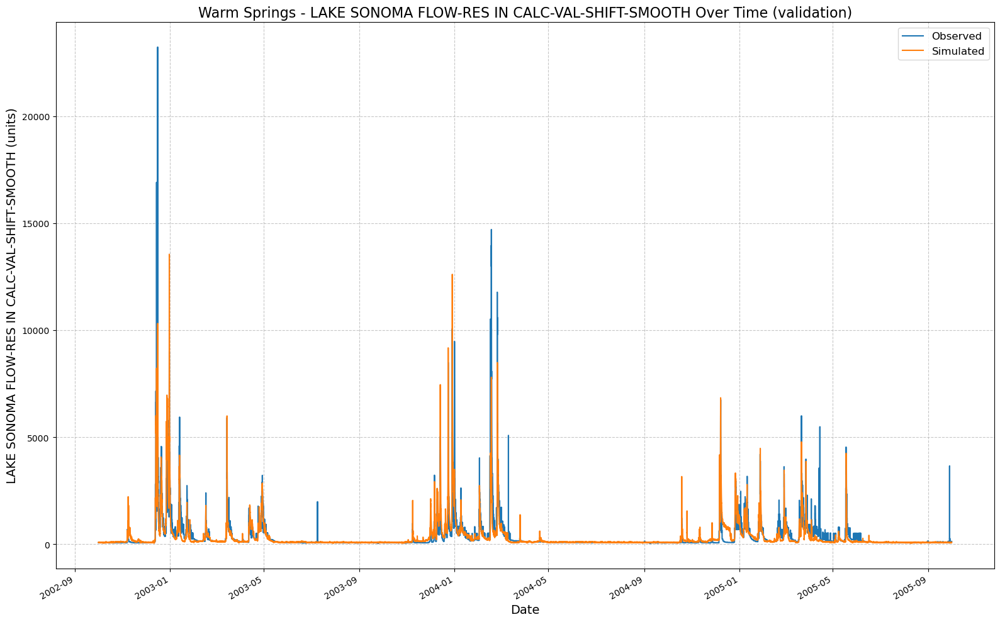

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


[INFO] CSV output saved at: F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_163054\results_output_validation.csv


In [16]:
if not skip_best_model_train:
    lstmNoPhysicsValBest = UCB_trainer(
        path_to_csv_folder=path_to_csv,
        yaml_path=path_to_yaml,
        hyperparams=best_no_physics_params,
        input_features=None,
        physics_informed=False,
        physics_data_file=None,
        hourly=True,
        extend_train_period=False,
        gpu=0
    )
    lstmNoPhysicsValBest.train()
    no_physics_val_csv, no_physics_val_metrics = lstmNoPhysicsValBest.results()
    no_physics_val_metrics

2025-03-14 16:57:25,701: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_165725\output.log initialized.
2025-03-14 16:57:25,701: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_165725
2025-03-14 16:57:25,701: ### Run configurations for testing_run
2025-03-14 16:57:25,712: experiment_name: testing_run
2025-03-14 16:57:25,712: train_basin_file: warm springs
2025-03-14 16:57:25,712: validation_basin_file: warm springs
2025-03-14 16:57:25,718: test_basin_file: warm springs
2025-03-14 16:57:25,720: train_start_date: 1994-10-01 00:00:00
2025-03-14 16:57:25,722: train_end_date: 2002-09-30 00:00:00
2025-03-14 16:57:25,722: validation_start_date: 2002-10-01 00:00:00
2025-03-14 16:57:25,722: validation_end_date: 2005-09-30 00:00:00
2025-03-14 16:57:25,722: test_start_date: 2005-10-01 00:00:00
2025-03-14 16:57:25,722: test_end_date: 2009-09-29 00:00:00
2025-03-14 16:57:25,7

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental f

# Validation: 100%|██████████| 1/1 [00:15<00:00, 15.27s/it]
2025-03-14 17:25:24,168: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_165725\validation\model_epoch032\validation_metrics.csv
2025-03-14 17:25:24,181: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_165725\validation\model_epoch032\validation_results.p
got predictions


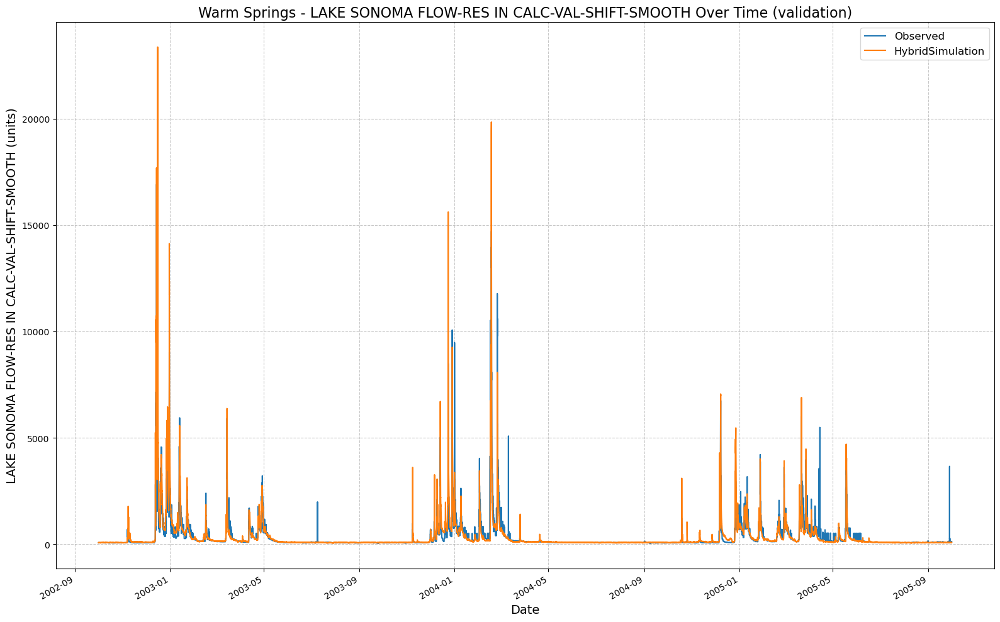

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


[INFO] CSV output saved at: F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_165725\results_output_validation.csv


In [17]:
if not skip_best_model_train:
    lstmPhysicsValBest = UCB_trainer(
        path_to_csv_folder=path_to_csv,
        yaml_path=path_to_yaml,
        hyperparams=best_physics_params,
        input_features=features_with_physics,
        physics_informed=True,
        physics_data_file=path_to_physics_data,
        hourly=True,
        extend_train_period=False,
        gpu=0
    )
    lstmPhysicsValBest.train()
    physics_val_csv, physics_val_metrics = lstmPhysicsValBest.results()
    physics_val_metrics

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\UCB_training\UCB_utils.py:61: DtypeWarning: Columns (0,3,4,5,6,7,8,9,10,11,12,13,14,15) have mixed types. Specify dtype option on import or set low_memory=False.
  hms_df = pd.read_csv(HMS_results)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339:

[INFO] Wrote metrics CSV: CV_warm_springs_hourly_val_metrics.csv
[INFO] Saved figure: CV_warm_springs_hourly_val_model_comparison.png


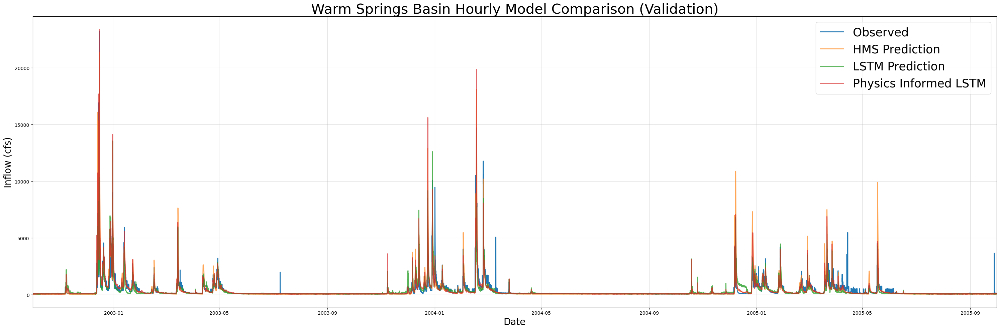

In [18]:
if not skip_best_model_train:
    combinedPlot(
        lstm_results=no_physics_val_csv,
        lstmPhysics_results=physics_val_csv,
        HMS_results=path_to_physics_data,
        title="Warm Springs Basin Hourly Model Comparison (Validation)",
        fName="CV_warm_springs_hourly_val_metrics.csv",
        plot_filename="CV_warm_springs_hourly_val_model_comparison.png",
        timeseries_filename ="CV_warm_springs_hourly_val_combined_ts.csv"
    )
else:
    combined_df = pd.read_csv("CV_warm_springs_hourly_val_combined_ts.csv")
    combinedPlotFromDf(combined_df, title="Warm Springs Basin Hourly Model Comparison (Validation)", fName="CV_warm_springs_hourly_val_metrics.csv")

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\UCB_training\UCB_utils.py:129: DtypeWarning: Columns (0,3,4,5,6,7,8,9,10,11,12,13,14,15) have mixed types. Specify dtype option on import or set low_memory=False.
  hms_df = pd.read_csv(HMS_results)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)
F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339

[INFO] Wrote metrics CSV: CV_warm_springs_hourly_val_metrics.csv


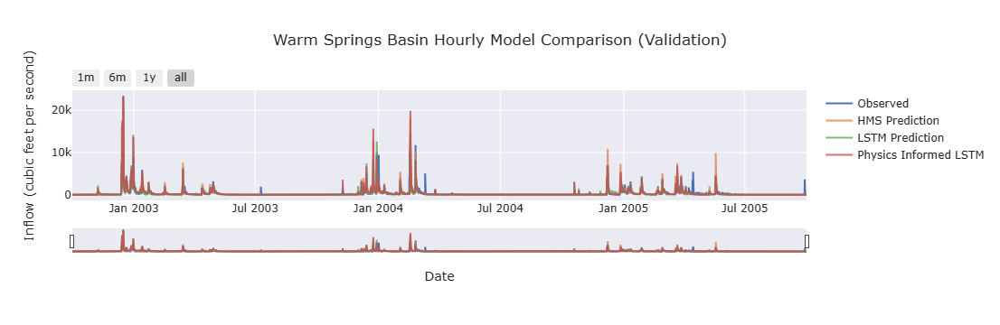

In [19]:
if not skip_best_model_train:
    fancyCombinedPlot(
        lstm_results=no_physics_val_csv,
        lstmPhysics_results=physics_val_csv,
        HMS_results=path_to_physics_data,
        title='Warm Springs Basin Hourly Model Comparison (Validation)',
        fName="CV_warm_springs_hourly_val_metrics.csv",
        timeseries_filename ="CV_warm_springs_hourly_val_combined_ts.csv"
    )
else:
    fancyCombinedPlotFromDf(combined_df, title='Warm Springs Basin Hourly Model Comparison (Validation)', fName="CV_warm_springs_hourly_val_metrics.csv")

In [20]:
if skip_best_model_train:
    val_metrics = pd.read_csv("CV_warm_springs_hourly_val_metrics.csv", index_col=0)
    print(val_metrics)

### Re-run test with best hyperparameters

2025-03-14 17:25:42,358: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_172542\output.log initialized.
2025-03-14 17:25:42,360: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_172542
2025-03-14 17:25:42,362: ### Run configurations for testing_run
2025-03-14 17:25:42,366: experiment_name: testing_run
2025-03-14 17:25:42,370: train_basin_file: warm springs
2025-03-14 17:25:42,373: validation_basin_file: warm springs
2025-03-14 17:25:42,376: test_basin_file: warm springs
2025-03-14 17:25:42,378: train_start_date: 1994-10-01 00:00:00
2025-03-14 17:25:42,381: train_end_date: 2005-09-30 00:00:00
2025-03-14 17:25:42,383: validation_start_date: 2002-10-01 00:00:00
2025-03-14 17:25:42,385: validation_end_date: 2005-09-30 00:00:00
2025-03-14 17:25:42,388: test_start_date: 2005-10-01 00:00:00
2025-03-14 17:25:42,390: test_end_date: 2009-09-29 00:00:00
2025-03-14 17:25:42,3

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning:

You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental 

# Validation: 100%|██████████| 1/1 [00:10<00:00, 10.68s/it]
2025-03-14 18:02:28,484: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_172542\validation\model_epoch032\validation_metrics.csv
2025-03-14 18:02:28,495: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_172542\validation\model_epoch032\validation_results.p
2025-03-14 18:02:28,587: Using the model weights from F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_172542\model_epoch032.pt


F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning:

You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental 

# Evaluation: 100%|██████████| 1/1 [00:14<00:00, 14.01s/it]
2025-03-14 18:02:42,621: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_172542\test\model_epoch032\test_metrics.csv
2025-03-14 18:02:42,624: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_172542\test\model_epoch032\test_results.p
got predictions


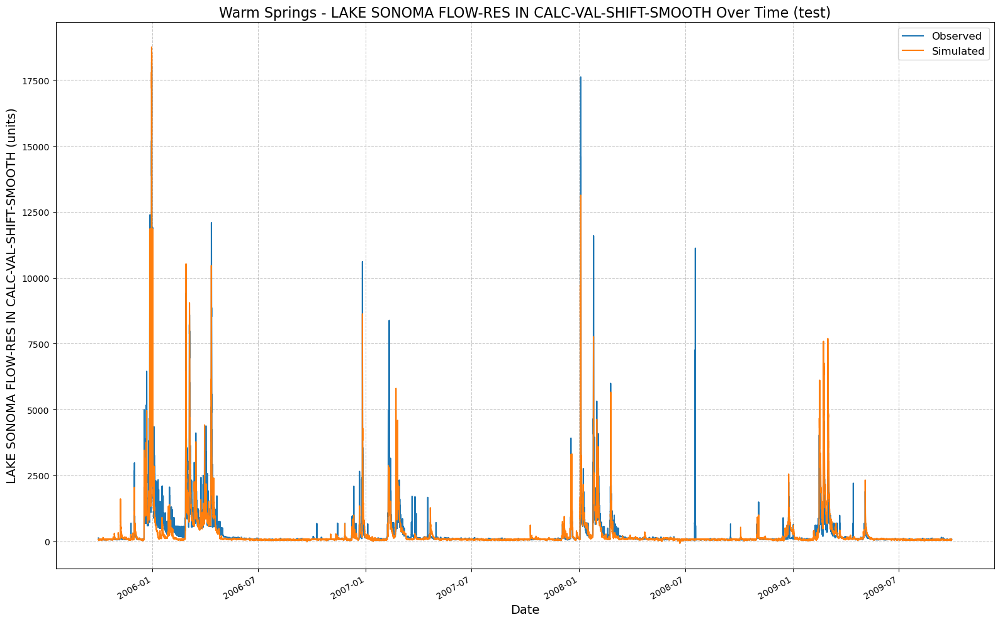

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning:

'H' is deprecated and will be removed in a future version, please use 'h' instead.

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning:

'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.



[INFO] CSV output saved at: F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_172542\results_output_test.csv


In [22]:
if not skip_best_model_train:
    lstmNoPhysicsExtBest = UCB_trainer(
        path_to_csv_folder=path_to_csv,
        yaml_path=path_to_yaml,
        hyperparams=best_no_physics_params,
        input_features=None,
        physics_informed=False,
        physics_data_file=None,
        hourly=True,
        extend_train_period=True,  
        gpu=0
    )
    
    lstmNoPhysicsExtBest.train()
    no_physics_test_csv, no_physics_test_metrics = lstmNoPhysicsExtBest.results('test')
    no_physics_test_metrics

2025-03-14 18:02:43,924: Logging to F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_180243\output.log initialized.
2025-03-14 18:02:43,926: ### Folder structure created at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_180243
2025-03-14 18:02:43,926: ### Run configurations for testing_run
2025-03-14 18:02:43,926: experiment_name: testing_run
2025-03-14 18:02:43,926: train_basin_file: warm springs
2025-03-14 18:02:43,926: validation_basin_file: warm springs
2025-03-14 18:02:43,934: test_basin_file: warm springs
2025-03-14 18:02:43,936: train_start_date: 1994-10-01 00:00:00
2025-03-14 18:02:43,936: train_end_date: 2005-09-30 00:00:00
2025-03-14 18:02:43,936: validation_start_date: 2002-10-01 00:00:00
2025-03-14 18:02:43,936: validation_end_date: 2005-09-30 00:00:00
2025-03-14 18:02:43,936: test_start_date: 2005-10-01 00:00:00
2025-03-14 18:02:43,936: test_end_date: 2009-09-29 00:00:00
2025-03-14 18:02:43,9

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning:

You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental 

# Validation: 100%|██████████| 1/1 [00:13<00:00, 13.55s/it]
2025-03-14 18:40:56,575: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_180243\validation\model_epoch032\validation_metrics.csv
2025-03-14 18:40:56,586: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_180243\validation\model_epoch032\validation_results.p
2025-03-14 18:40:56,655: Using the model weights from F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_180243\model_epoch032.pt


F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning:

You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental 

# Evaluation: 100%|██████████| 1/1 [00:15<00:00, 15.90s/it]
2025-03-14 18:41:12,578: Stored metrics at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_180243\test\model_epoch032\test_metrics.csv
2025-03-14 18:41:12,599: Stored results at F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_180243\test\model_epoch032\test_results.p
got predictions


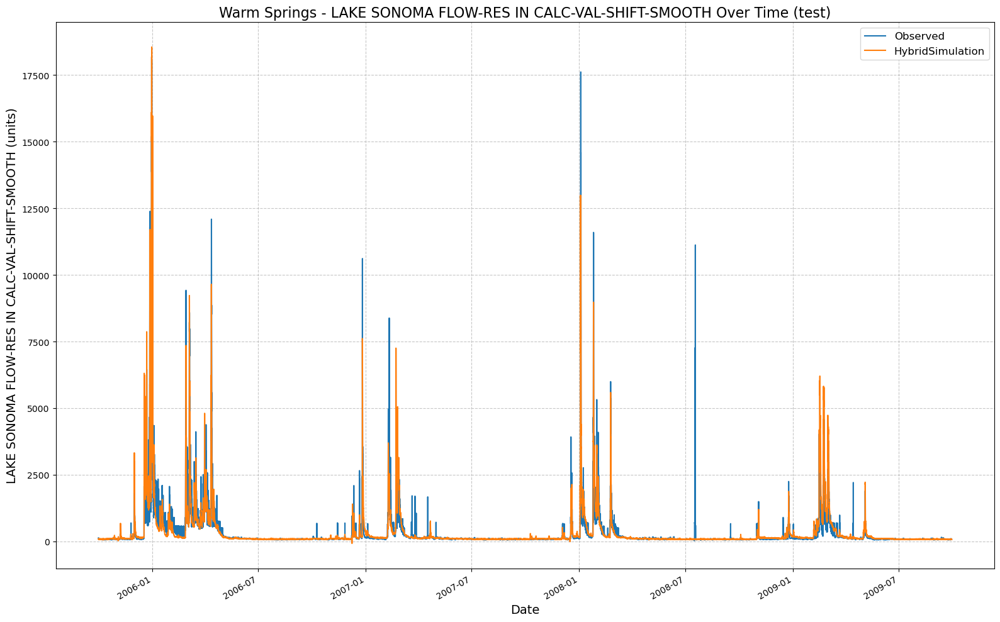

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning:

'H' is deprecated and will be removed in a future version, please use 'h' instead.

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning:

'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.



[INFO] CSV output saved at: F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1403_180243\results_output_test.csv


In [23]:
if not skip_best_model_train:
    lstmPhysicsExtBest = UCB_trainer(
        path_to_csv_folder=path_to_csv,
        yaml_path=path_to_yaml,
        hyperparams=best_physics_params,
        input_features=features_with_physics,
        physics_informed=True,
        physics_data_file=path_to_physics_data,
        hourly=True,
        extend_train_period=True,
        gpu=0
    )
    
    lstmPhysicsExtBest.train()
    physics_test_csv, physics_test_metrics = lstmPhysicsExtBest.results('test')
    physics_test_metrics

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\UCB_training\UCB_utils.py:61: DtypeWarning:

Columns (0,3,4,5,6,7,8,9,10,11,12,13,14,15) have mixed types. Specify dtype option on import or set low_memory=False.

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning:

'H' is deprecated and will be removed in a future version, please use 'h' instead.

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning:

'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning:

'H' is deprecated and will be removed in a future version, please use 'h' instead.

F:\Dino\Arman\UCB-USACE-LSTMs

[INFO] Wrote metrics CSV: CV_warm_springs_hourly_test_metrics.csv
[INFO] Saved figure: CV_warm_springs_hourly_test_model_comparison.png


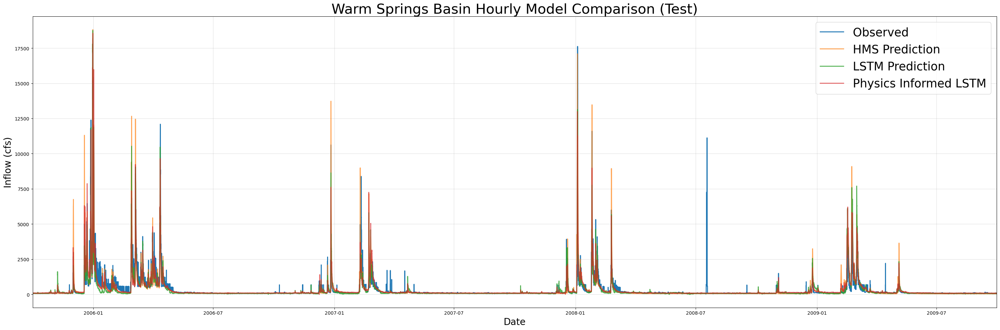

In [24]:
if not skip_best_model_train:
    combinedPlot(
        lstm_results=no_physics_test_csv,
        lstmPhysics_results=physics_test_csv,
        HMS_results=path_to_physics_data,
        title="Warm Springs Basin Hourly Model Comparison (Test)",
        fName="CV_warm_springs_hourly_test_metrics.csv",
        plot_filename="CV_warm_springs_hourly_test_model_comparison.png", 
        timeseries_filename ="CV_warm_springs_hourly_test_combined_ts.csv"
    )
else:
    combined_df = pd.read_csv("CV_warm_springs_hourly_test_combined_ts.csv")
    combinedPlotFromDf(combined_df, title="Warm Springs Basin Hourly Model Comparison (Test)", fName="CV_warm_springs_hourly_test_metrics.csv")

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\UCB_training\UCB_utils.py:129: DtypeWarning:

Columns (0,3,4,5,6,7,8,9,10,11,12,13,14,15) have mixed types. Specify dtype option on import or set low_memory=False.

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning:

'H' is deprecated and will be removed in a future version, please use 'h' instead.

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning:

'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.

F:\Dino\Arman\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning:

'H' is deprecated and will be removed in a future version, please use 'h' instead.

F:\Dino\Arman\UCB-USACE-LSTM

[INFO] Wrote metrics CSV: CV_warm_springs_hourly_test_metrics.csv


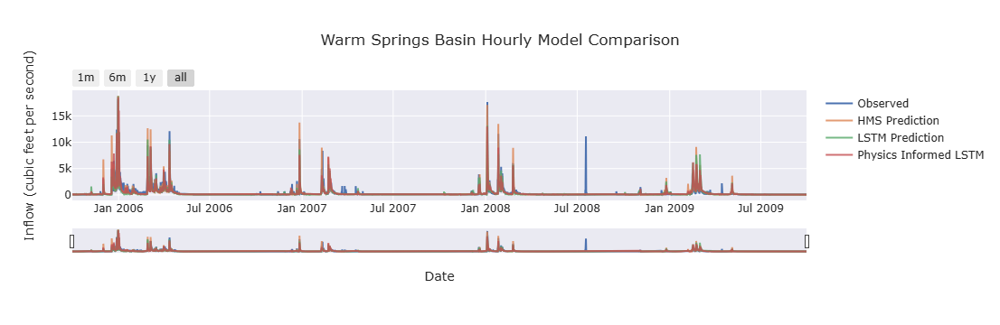

In [25]:
if not skip_best_model_train:
    fancyCombinedPlot(lstm_results=no_physics_test_csv, lstmPhysics_results= physics_test_csv, HMS_results=path_to_physics_data, title='Warm Springs Basin Hourly Model Comparison', fName = "CV_warm_springs_hourly_test_metrics.csv", timeseries_filename ="CV_warm_springs_hourly_test_combined_ts.csv")
else:
    fancyCombinedPlotFromDf(combined_df, title='Warm Springs Basin Hourly Model Comparison', fName = "CV_warm_springs_hourly_test_metrics.csv")

In [26]:
if skip_best_model_train:
    test_metrics = pd.read_csv("CV_warm_springs_hourly_test_metrics.csv", index_col=0)
    print(test_metrics)